# Import package

In [4]:
import sys
import os
import inspect

# Assuming your scripts directory is one level up from the notebooks directory
sys.path.append(os.path.abspath("../Scripts"))

import importlib
import my_functions as mf
import numpy as np
import matplotlib.pyplot as plt
from itertools import product
from scipy.stats import gaussian_kde
import autograd.numpy as anp 
import sampyl as smp
from scipy.integrate import odeint
import pandas as pd
import sunode.wrappers.as_pytensor as sun
from my_functions import *
from scipy.integrate import solve_ivp
import pysindy as ps

importlib.reload(mf)
functions_list = inspect.getmembers(mf, inspect.isfunction)
# Print the names of the functions
Fnc_nms = [function[0] for function in functions_list]
Fnc_nms

['Hudson_bay_data',
 'calculate_noise_statistics',
 'defvjp',
 'estimate_noise_statistics',
 'expand_2D_array',
 'gaussian_process_interpolation',
 'generate_samples',
 'grad_safe_sqrt',
 'load_csv_to_array',
 'mean_squared_error',
 'odeint',
 'plot_kde_matrix',
 'plot_paths',
 'primitive',
 'safe_sqrt',
 'safe_std',
 'save_array_to_csv',
 'set_publcn_matplotlib_defaults']

In [5]:
set_publcn_matplotlib_defaults()

In [6]:
import numpy as np
import matplotlib.pyplot as plt
from itertools import product
from scipy.stats import gaussian_kde
import autograd.numpy as anp 
import sampyl as smp
from scipy.integrate import odeint

In [7]:
# Required Modification to run NUTS, FInd_MAP and Hamiltonian monte carlo
from autograd import numpy as anp
from autograd.extend import primitive, defvjp

@primitive
def safe_sqrt(x):
    """ A safe version of sqrt that can handle ArrayBox types. """
    return x**0.5  # Using exponentiation as a substitute for sqrt.

def grad_safe_sqrt(ans, x):
    """ Gradient of sqrt at x, using the chain rule:
        d(sqrt(x))/dx = 0.5 / sqrt(x) = 0.5 * x**(-0.5) """
    return lambda g: g * 0.5 * x**(-0.5)

# Linking the gradient function to safe_sqrt
defvjp(safe_sqrt, grad_safe_sqrt)

def safe_std(x, axis=None, keepdims=False):
    mean = anp.mean(x, axis=axis, keepdims=True)
    var = anp.mean(anp.square(x - mean), axis=axis, keepdims=keepdims)
    std_dev = safe_sqrt(var)  # Using the custom safe_sqrt function.
    return std_dev

# Independent functions

In [9]:
def generate_samples(mean_or_lower, std_or_upper, n_samples, distribution='normal'):
    """Generate samples from a specified distribution (normal or uniform) based on provided parameters."""    
    if distribution == 'normal':
        # Generate samples from a normal distribution
        if np.isscalar(mean_or_lower) and np.isscalar(std_or_upper):
            samples = np.random.normal(loc=mean_or_lower, scale=std_or_upper, size=n_samples)
        else:
            # Vectorized sampling for multiple sets of means and std deviations
            samples = np.random.normal(loc=mean_or_lower, scale=std_or_upper, size=(n_samples, len(mean_or_lower)))            
    elif distribution == 'uniform':
        # Generate samples from a uniform distribution
        if np.isscalar(mean_or_lower) and np.isscalar(std_or_upper):
            samples = np.random.uniform(low=mean_or_lower, high=std_or_upper, size=n_samples)
        else:
            # Vectorized sampling for multiple sets of bounds
            samples = np.random.uniform(low=mean_or_lower, high=std_or_upper, size=(n_samples, len(mean_or_lower)))            
    else:
        raise ValueError("Unsupported distribution type. Choose 'normal' or 'uniform'.")    
    return samples

def expand_2D_array(arr):
    """Expands a 2D array by pairing every element of each column with every element of all other columns."""
    # Number of columns
    n = arr.shape[1]    
    # List to hold the 1D arrays (columns)
    columns = [arr[:, i] for i in range(n)]    
    # Generate all combinations of pairs from these columns
    # itertools.product creates a Cartesian product, equivalent to a nested for-loop
    combinations = list(product(*columns))    
    # Convert list of tuples (combinations) back to a NumPy array
    expanded_array = np.array(combinations)    
    return expanded_array

def plot_paths(x_values, y_paths, show = False, color='blue', hl = 'r*', label = 'mean_path'):
    """Plots multiple y paths (each row in y_paths) against x_values on the same plot with a specified transparency. """
    # Calculate the mean path across all rows (mean for each column)
    mean_path = np.mean(y_paths, axis=0)
    
    # Set up the plot
    plt.figure(figsize=(10, 6))
    
    # Plot each path
    for path in y_paths:
        plt.plot(x_values, path, color=color, alpha=0.3)  # semi-transparent blue lines
    
    # Plot the mean path
    plt.plot(x_values, mean_path, hl , label=label)  # mean path in red
    
    # Adding title and labels
    plt.title('Multiple Y Paths with Mean Path')
    plt.xlabel('X Values')
    plt.ylabel('Y Values')
    plt.legend()
    if show:
        plt.show()

# Data generation process

In [12]:
# Lotka-Volterra model equations
def lotka_volterra_system(state, t, alpha, beta, delta, gamma):
    x, y = state
    dx_dt = alpha * x - beta * x * y
    dy_dt = delta * x * y - gamma * y
    return [dx_dt, dy_dt]

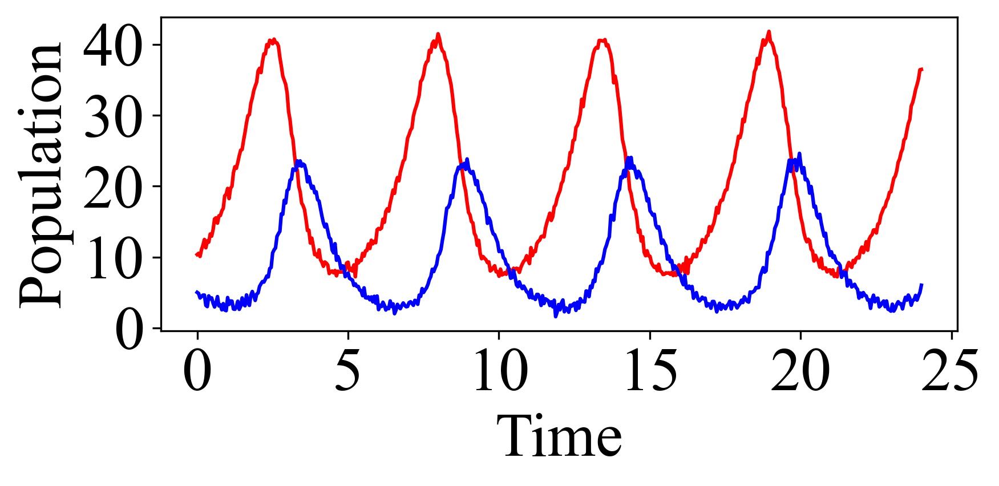

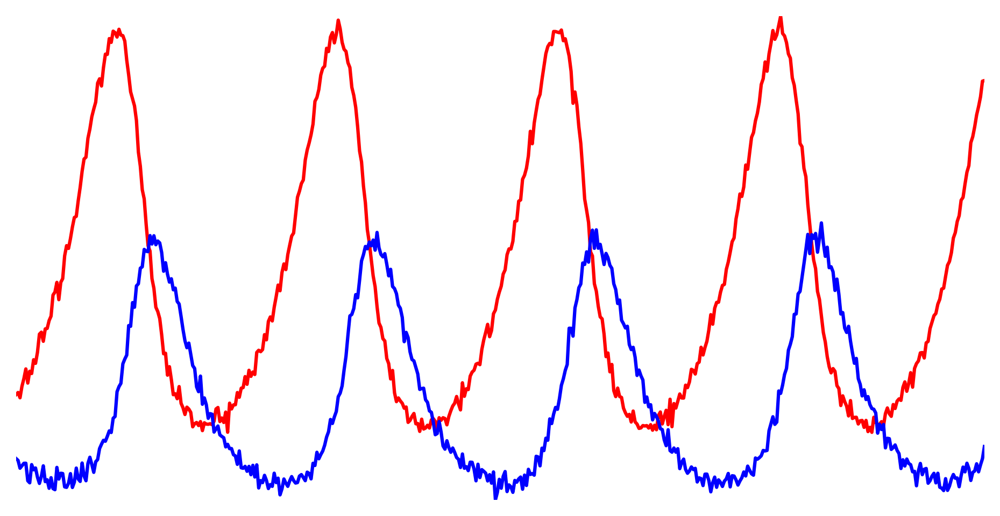

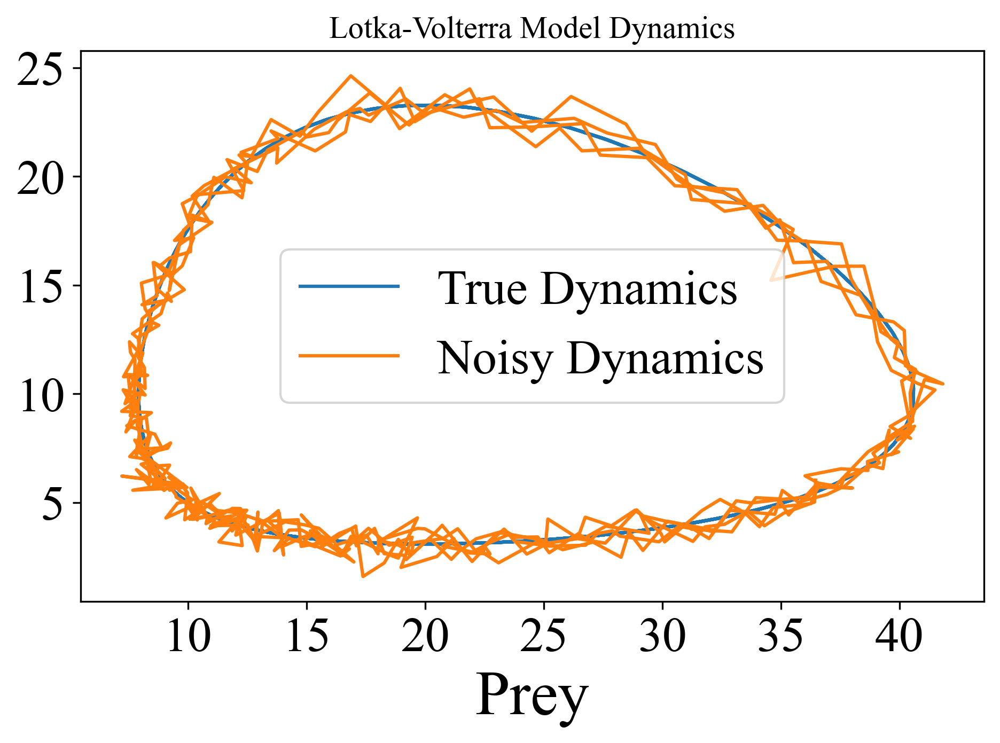

In [40]:
#General parameters
num_points = 500
sigma_noise = 0.5

# simulation Parameters
alpha = 1
beta = 0.1
delta = 0.075
gamma = 1.5

params =  (alpha,beta,delta,gamma)

# Initial conditions
x0 = 10
y0 = 5
initial_state = [x0, y0]

# Time points
t = np.linspace(0, 24, num_points)
time = t

# Solve ODE
solution = odeint(lotka_volterra_system, initial_state, t, args=params)
x, y = solution.T

# Add noise to data

x_noisy = np.random.normal(x, sigma_noise)
y_noisy =  np.random.normal(y, sigma_noise)


plt.figure(figsize = (6,3))
# plt.title('Lotka-Volterra Model Dynamics')
# plt.plot(t, x, label='True Prey')
# plt.plot(t, y, label='True Predator')
plt.plot(t, x_noisy, 'r', label='Prey') #Noisy
plt.plot(t, y_noisy, 'b', label='Predator') #Noisy
plt.xlabel('Time', fontsize=26)
plt.ylabel('Population', fontsize=26)
# plt.legend()
plt.xticks( fontsize=26, rotation=0) #rotation=45,
plt.yticks(fontsize=26)
# Adjust layout to ensure everything is visible
plt.tight_layout()
# plt.legend(fontsize=22)
plt.show()

plt.figure(figsize=(6, 3))
plt.plot(t, x_noisy, 'r', label='Prey')       # Noisy prey trajectory
plt.plot(t, y_noisy, 'b', label='Predator')   # Noisy predator trajectory

# Remove axis ticks and labels
plt.axis('off')

# Optional: remove padding
plt.margins(0)
plt.tight_layout(pad=0)

plt.show()

plt.figure()
plt.title('Lotka-Volterra Model Dynamics')
plt.plot(x, y, label='True Dynamics')
plt.plot(x_noisy, y_noisy, label='Noisy Dynamics')

plt.xlabel('Prey', fontsize=28)
# plt.ylabel('Predator', fontsize=26)
# plt.legend()

plt.xticks( fontsize=22, rotation=0) #rotation=45,
plt.yticks(fontsize=22)
# Adjust layout to ensure everything is visible
plt.tight_layout()
plt.legend(fontsize=22)
plt.show()

### Generate multiple path dataset

In [15]:
# Lotka-Volterra model equations
def lotka_volterra(state, t, alpha, beta, delta, gamma):
    x, y = state
    dx_dt = alpha * x - beta * x * y
    dy_dt = delta * x * y - gamma * y
    return [dx_dt, dy_dt]

def simulate_params(params):
    alpha,beta,delta, gamma = params
    # Initial conditions
    initial_state = [10, 5]  
    # Time points
    t = np.linspace(0, 24, num_points)  # More points for a smoother curve
    path = odeint(lotka_volterra, initial_state, t, args=(alpha, beta, delta, gamma))
    return path

# Generating paths for an additive noise with known noise std
def add_noise_to_path(clean_path, noise_std):
    noisy_path = np.random.normal(clean_path, noise_std)
    return noisy_path

def gen_multi_noise_path(clean_path, noise_std, num_sample = num_points):
    multi_noise_path = [add_noise_to_path(clean_path, noise_std) for _ in range(num_sample)]
    return multi_noise_path
    

# Generating paths for variable parameter
def normal_rv(mean,std, num_sample=num_points):
    samples = np.random.normal(mean, std, num_sample)
    return samples

def gen_vary_params(params, std, locs=[1,1,1,1], num_sample=num_points):
    std = np.array(std).reshape(-1)
    Param_samples = []
    for i,loc in enumerate(locs):
        if loc==1:
            sample_i = normal_rv(params[i],std[i], num_sample)
        else:
            sample_i = np.repeat(params[i], num_sample)
        Param_samples.append(sample_i)
    Param_samples = np.array(Param_samples).T
    return Param_samples

def gen_varying_paths(params):
    multi_vary_path = [simulate_params(param) for param in params]
    return multi_vary_path

In [16]:
mean_params = np.array([1, 0.1, 0.075, 1.5])
std_params = mean_params*0.1

recv_mean = [0.97,  -0.088, -1.36, 0.058]
recv_std = [0.055, 0.008, 0.168, 0.013]

param_dist = gen_vary_params(mean_params, std_params, locs=[1,1,1,1], num_sample=100)
path_dist= np.array([simulate_params(param) for param in param_dist])

param_dist

array([[1.02600255, 0.09448677, 0.07651628, 1.23957624],
       [1.08274032, 0.11592917, 0.06338388, 1.4515081 ],
       [0.95464412, 0.1041124 , 0.08855584, 1.61234487],
       [0.96135834, 0.08758769, 0.07088523, 1.43635906],
       [0.96676185, 0.09186061, 0.08326943, 1.47589767],
       [1.00073578, 0.1176154 , 0.0730513 , 1.44536355],
       [1.01130564, 0.10692473, 0.08775408, 1.57331854],
       [0.93972684, 0.10181587, 0.07537182, 1.36967653],
       [1.12828967, 0.10214734, 0.08149928, 1.45697762],
       [1.03578048, 0.11753607, 0.06554343, 1.5039602 ],
       [0.99772744, 0.09725306, 0.07520284, 1.4731975 ],
       [1.22168129, 0.10865942, 0.08205109, 1.66778002],
       [0.9789216 , 0.09743049, 0.0835161 , 1.58904655],
       [1.1140549 , 0.09990294, 0.08037312, 1.71036176],
       [0.87838872, 0.09174878, 0.06974059, 1.73973215],
       [0.95383379, 0.10923634, 0.07738563, 1.62828593],
       [0.92258384, 0.0878006 , 0.0721584 , 1.34628929],
       [1.10355442, 0.11050826,

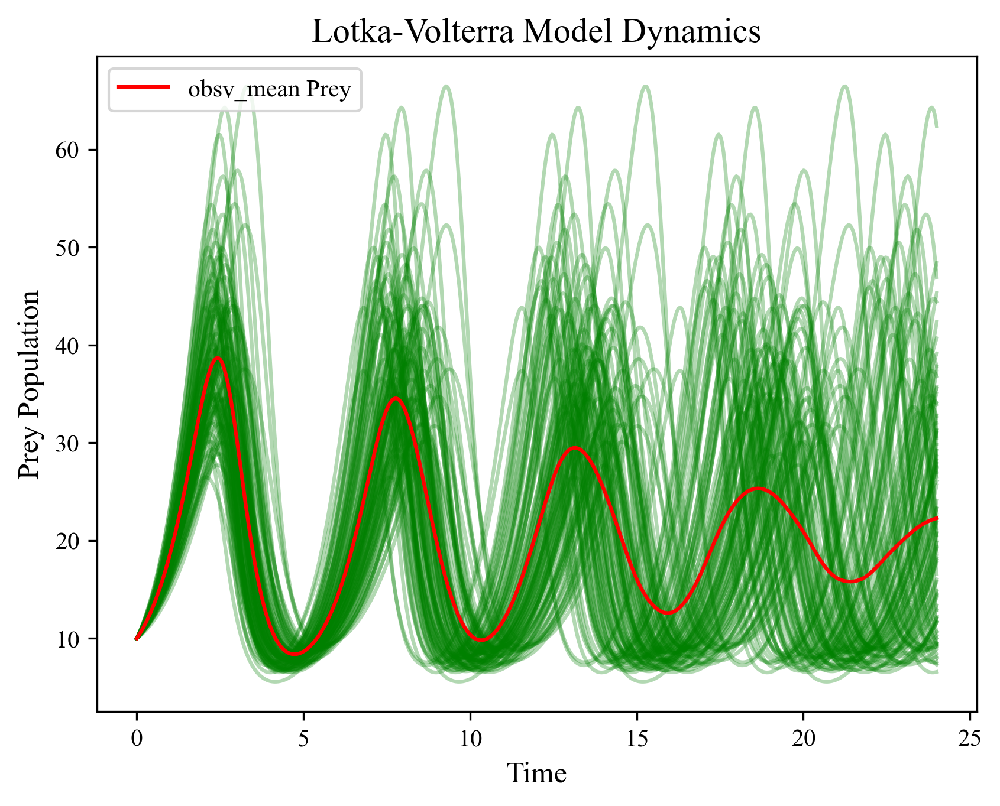

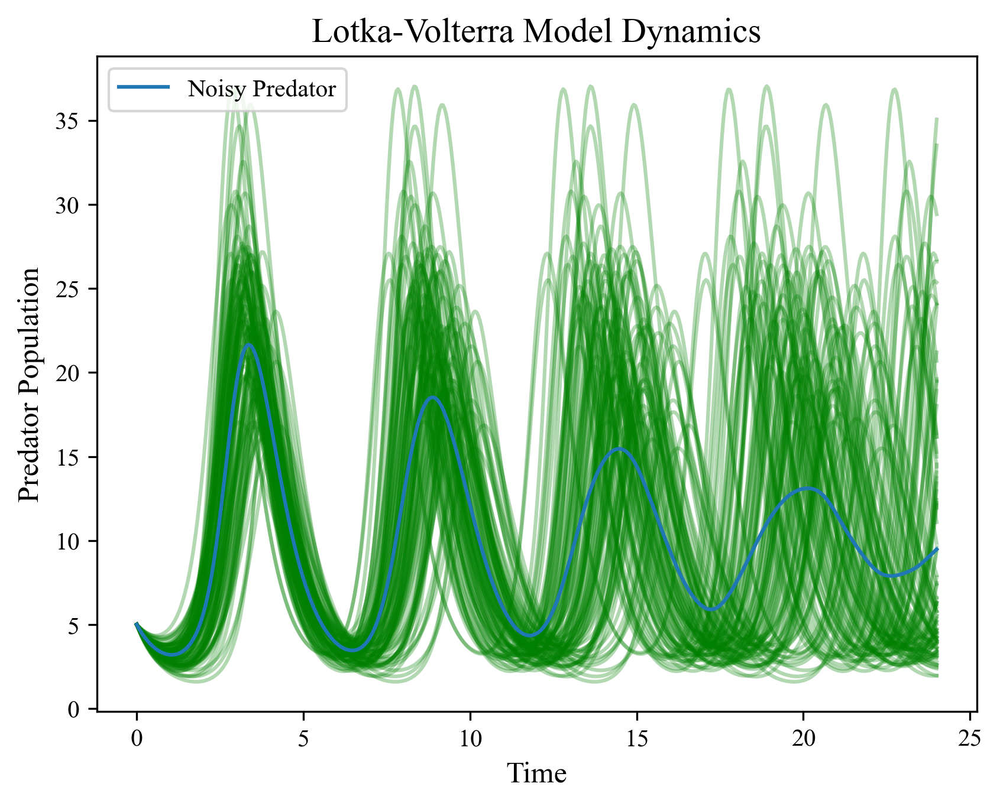

In [17]:
mean_param_dist = np.mean(param_dist,0)
mean_path = np.mean(path_dist,0)
x_noisy,y_noisy = mean_path[:,0], mean_path[:,1]

# Visualize paths
plt.figure()
plt.title('Lotka-Volterra Model Dynamics')
for i in range(len(path_dist)):
    xn = path_dist[i][:,0]
    plt.plot(t, xn, 'g', alpha = 0.3)
# plt.plot(t, x, label='True Prey')
plt.plot(t,x_noisy, 'r',label='obsv_mean Prey')
plt.xlabel('Time')
plt.ylabel('Prey Population')
plt.legend()
plt.show()

plt.figure()
plt.title('Lotka-Volterra Model Dynamics')
for i in range(len(path_dist)):
    yn = path_dist[i][:,1]
    plt.plot(t, yn, 'g', alpha = 0.3)

# plt.plot(t, y, label='True Predator')
plt.plot(t, y_noisy, label='Noisy Predator')
plt.xlabel('Time')
plt.ylabel('Predator Population')
plt.legend()
plt.show()

In [ ]:
plt.figure(figsize=(6, 3))
plt.plot(t, x_noisy, 'r', label='Prey')       # Noisy prey trajectory
plt.plot(t, y_noisy, 'b', label='Predator')   # Noisy predator trajectory

# Remove axis ticks and labels
plt.axis('off')

# Optional: remove padding
plt.margins(0)
plt.tight_layout(pad=0)

plt.show()

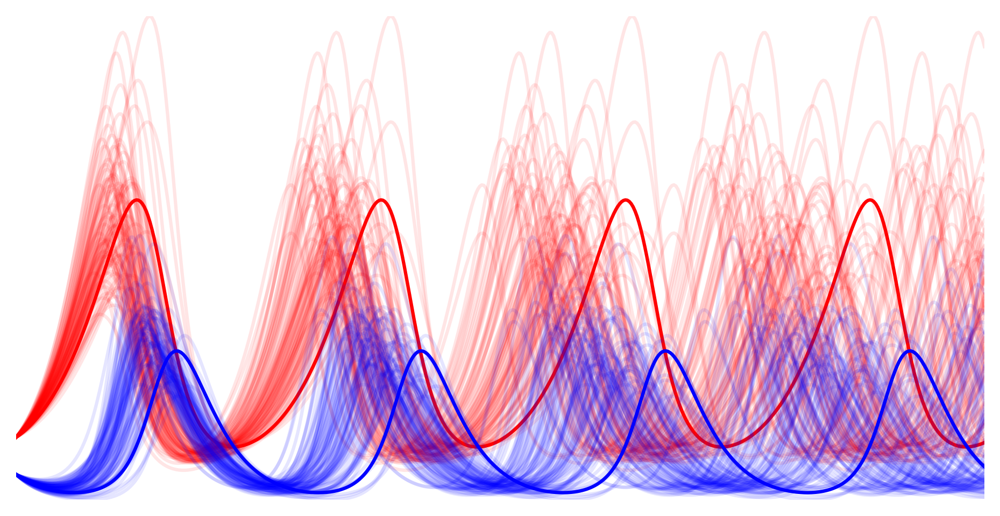

In [43]:
# Visualize paths
plt.figure(figsize = (6,3))
# plt.title('Lotka-Volterra Model Dynamics')
for i in range(len(path_dist)):
    xn = path_dist[i][:,0]
    plt.plot(t, xn, 'r', alpha = 0.1)
# plt.plot(t, x, label='True Prey')
# plt.plot(t,x_noisy, 'r--',label='obsv_mean Prey')
plt.plot(t, xn, 'r', label='prey', alpha = 1) #obs prey samples

for i in range(len(path_dist)):
    yn = path_dist[i][:,1]
    plt.plot(t, yn, 'b', alpha = 0.1)

# plt.plot(t, y, label='True Predator')
# plt.plot(t, y_noisy, 'b--', label='Noisy Predator')
plt.plot(t, yn, 'b', label='predator', alpha = 1) #obs predator samples

# plt.xlabel('Time', fontsize=28)
# plt.ylabel('Population', fontsize=28)
# # plt.legend()
# plt.xticks( fontsize=26, rotation=0) #rotation=45,
# plt.yticks(fontsize=26)
# # Adjust layout to ensure everything is visible
# plt.tight_layout()
# # plt.legend(fontsize=22)
# plt.show()

# Remove axis ticks and labels
plt.axis('off')

# Optional: remove padding
plt.margins(0)
plt.tight_layout(pad=0)

plt.show()

# plt.figure()
# plt.title('Lotka-Volterra Model Dynamics')
# for i in range(len(path_dist)):
#     yn = path_dist[i][:,1]
#     plt.plot(t, yn, 'g', alpha = 0.3)

# # plt.plot(t, y, label='True Predator')
# plt.plot(t, y_noisy, label='Noisy Predator')
# plt.xlabel('Time')
# plt.ylabel('Predator Population')
# plt.legend()
# plt.show()

## SIP parameter learning process

In [62]:
import numpy as np
from sklearn.utils import resample
from scipy.interpolate import interp1d
from sklearn.neighbors import KernelDensity
from scipy.stats import entropy
from scipy.integrate import cumulative_trapezoid

In [63]:
def estimate_kde(y_paths, bw_method='scott', dim=5):
    """Estimates a kernel density estimate (KDE) for a given 2D array of observations where each row is a random variable."""
    data = y_paths[:,:dim]
    print("Data shape for KDE:", data.shape)
    kde = KernelDensity(bandwidth=bw_method, kernel='gaussian')
    kde.fit(data)    
    return kde

def kde_density_at_points(kde, points, dim=5):
    """Evaluates the density of the previously estimated KDE at specified points."""
    eval_points = points[:,:dim]
    # Evaluate the log density at these points
    log_densities = kde.score_samples(eval_points)
    # Convert log densities to densities
    densities = np.exp(log_densities)    
    return densities

def rejection_sampling(samples_from_prior, Q, kde_obs, kde_prior, *args ):
    """Perform rejection sampling to generate samples from the posterior"""
    # Calculate r(Q(lambda)) for each sample from the prior
    def r(prior, Q=Q, kde_obs=kde_obs, kde_prior=kde_prior):
        push_prior = Q(prior, *args)
        kde_obs_pprior = kde_density_at_points(kde_obs, push_prior, dim=dim)
        kde_prior_pprior = kde_density_at_points(kde_prior, push_prior, dim=dim)
        return kde_obs_pprior/kde_prior_pprior
    r_values = r(samples_from_prior) #np.array([r(sample) for sample in samples_from_prior])
    
    # Find the maximum value of r(Q(lambda)) to use as M
    M = np.max(r_values)
    
    accepted_samples = []
    accepted_probs = []
    for i, lambda_p in enumerate(samples_from_prior):
        # Use the precomputed r_values
        r_Q_lambda = r_values[i]
        
        # Generate a random number from a uniform distribution on [0, 1]
        epsilon_p = np.random.uniform(0, 1)
        
        # Compute the ratio
        ratio_p = r_Q_lambda / M
        
        # Accept or reject the sample based on the ratio
        if ratio_p >= epsilon_p:
            accepted_samples.append(lambda_p) 
            accepted_probs.append(ratio_p)
    print(f'{len(accepted_samples)} was accepted out of {len(samples_from_prior)} total prior samples')
    return np.array(accepted_samples)



def kl_divergence(p, q, bandwidth=1.0):
    """ Calculate the KL divergence between two KDEs of multivariate datasets p and q.  """
    # Fit KDE to both datasets
    kde_p = KernelDensity(kernel='gaussian', bandwidth=bandwidth).fit(p)
    kde_q = KernelDensity(kernel='gaussian', bandwidth=bandwidth).fit(q)

    # Sample points from KDEs (using the fitted model's 'sample' method) for evaluation
    # Note: This is an approximation to avoid the integration over the entire space
    points = kde_p.sample(n_samples=200)  # Number of samples to approximate the integration

    # Evaluate log probability density of points under both KDEs
    log_p_x = kde_p.score_samples(points)
    log_q_x = kde_q.score_samples(points)

    # Calculate the KL divergence using the log probabilities
    kl_p_q = np.sum(np.exp(log_p_x) * (log_p_x - log_q_x)) / points.shape[0]
    kl_q_p = np.sum(np.exp(log_q_x) * (log_q_x - log_p_x)) / points.shape[0]
    return kl_p_q, kl_q_p

In [64]:
def bootstrap_lotka_volterra(data):
    """
    Bootstraps the Lotka-Volterra predator-prey population data.
    """
    n = data.shape[1]  # Number of time instances
    indices = np.arange(1, n - 1)  # Create index array from 1 to n-1
    
    # Bootstrap sample indices (without replacement, 65% of original)
    boot_indices = resample(indices, replace=False, n_samples=int(0.65 * len(indices)))#, random_state=42)
    boot_indices = np.sort(boot_indices)  # Sort indices for slicing
    
    # Add the first and last index
    boot_indices = np.insert(boot_indices, 0, 0)  # Add index 0 at the start
    boot_indices = np.append(boot_indices, n - 1)  # Add index n-1 at the end
    
    # Extract corresponding predator and prey populations
    prey_sampled = data[0, boot_indices]
    predator_sampled = data[1, boot_indices]
    
    # Create new time points to interpolate to (original number of points)
    new_time_points = np.linspace(0, n - 1, n)
    
    # Interpolate sampled data to new time points
    interpolate_prey = interp1d(boot_indices, prey_sampled, kind='linear', fill_value="extrapolate")
    interpolate_predator = interp1d(boot_indices, predator_sampled, kind='linear', fill_value="extrapolate")
    
    # Generate new interpolated data
    new_prey_population = interpolate_prey(new_time_points)
    new_predator_population = interpolate_predator(new_time_points)
    
    return new_prey_population, new_predator_population

def generate_population_of_paths(prey_population, predator_population, samples=250):
    """
    Generates a population of bootstrapped paths from a single predator-prey path.
    """
    # Stack the populations into a 2xN array as required
    data = np.vstack([prey_population, predator_population])
    
    # Generate multiple bootstrap samples
    bootstrapped_samples = [bootstrap_lotka_volterra(data) for _ in range(samples)]
    return np.array(bootstrapped_samples)

In [65]:
def generate_library(x,y):
    lib_mat = np.array([np.ones(len(x)), x, y, x*y]).T
    return lib_mat

def simulate_param(params, library):
    params = np.array(params).reshape(-1,1)
    return np.dot(library, params).reshape(-1)

def integrate_x_dot(x_dot, t, init_val):
    """
    Integrates x_dot with respect to time t using the cumulative trapezoidal rule.

    Parameters:
    - x_dot: Array of derivative values with respect to time (velocity if x is position).
    - t: Array of time values.

    Returns:
    - x: Array of integrated values (position if x_dot is velocity), same length as t by adding initial condition.
    """
    # Compute the cumulative integral of x_dot with respect to t
    x = cumulative_trapezoid(x_dot, t, initial=0)+init_val  # Set initial=0 to include the starting point in the result array

    return x

def numerate_param(param, library, init_val, t=t):
    z_dot = simulate_param(param, library)
    z_intgrt = integrate_x_dot(z_dot, t, init_val)
    return z_intgrt



# Beginning Analysis

In [66]:
import pysindy as ps
# differentiation function
def differentiate(data,time, wl = 5, order = 3):
    smoothed_fd = ps.SmoothedFiniteDifference(order=order, smoother_kws={'window_length': wl})
    dldt = smoothed_fd(data,time)
    d2ldt = smoothed_fd(dldt, time)
    d3ldt = smoothed_fd(d2ldt, time)
    return [dldt,d2ldt,d3ldt] 

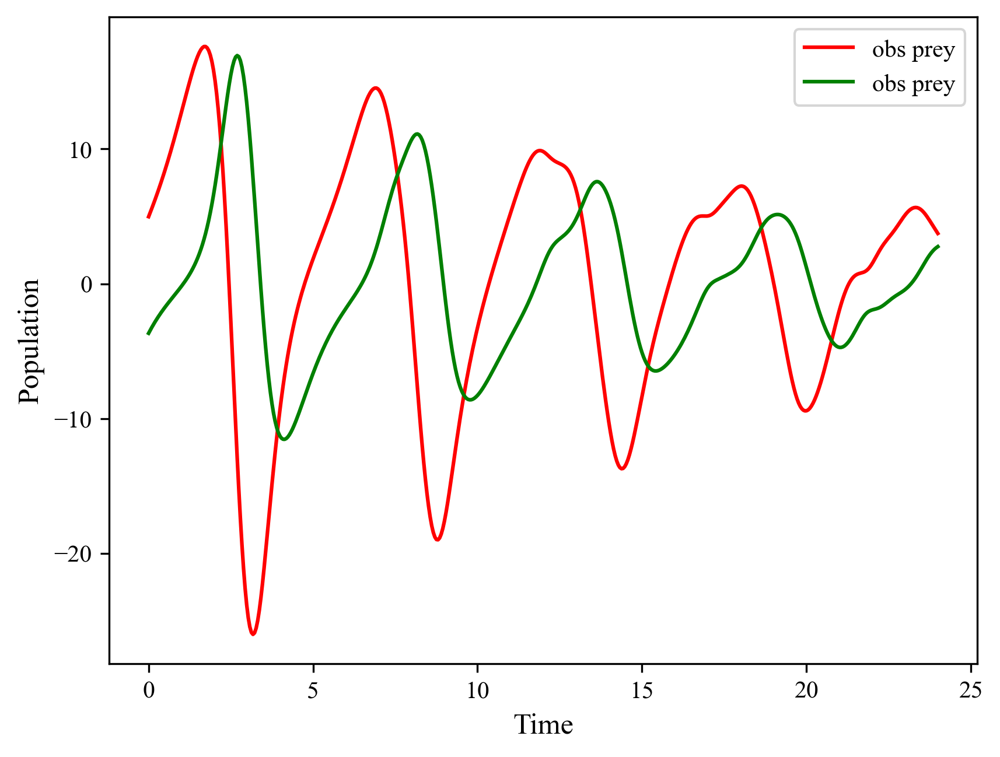

In [75]:
# Generate library data
library = generate_library(x_noisy, y_noisy)

x_dot_noisy =  differentiate(x_noisy, time,  wl = 5, order = 6)[0]
y_dot_noisy = differentiate(y_noisy, time)[0]

# Define true parameters
x_param_true = [0,1,0,-0.1]
y_param_true = [0,0,-1.5,0.075]

# Simulate x_dot and v_dot
x_dot_true = simulate_param(x_param_true, library)
y_dot_true = simulate_param(y_param_true, library)

# Directly simulate x and v
x_intgrt_true = numerate_param(x_param_true, library, init_val=10, t=t)
y_intgrt_true = numerate_param(y_param_true, library, init_val=5, t=t)

# plt.plot(t, x_dot_true, 'r')
plt.plot(t, x_dot_noisy, 'r', label = 'obs prey')
# plt.plot(t, y_dot_true, 'r')
plt.plot(t, y_dot_noisy, 'g', label = 'obs prey')

plt.legend()
plt.xlabel('Time')
plt.ylabel('Population')

plt.show()

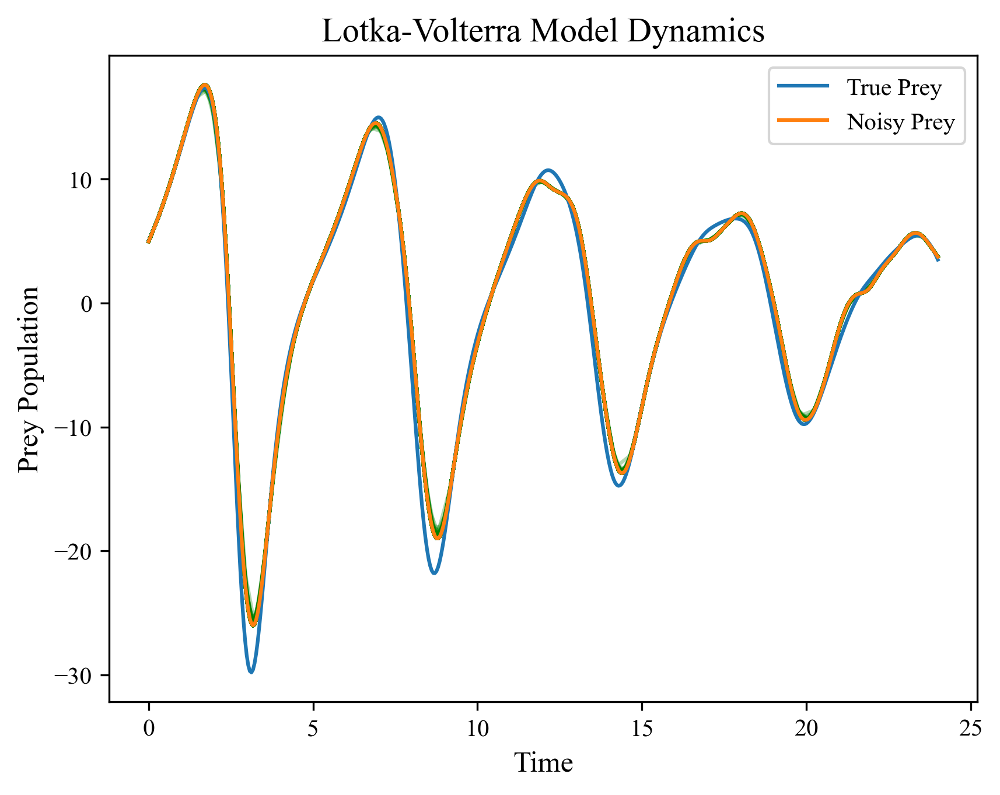

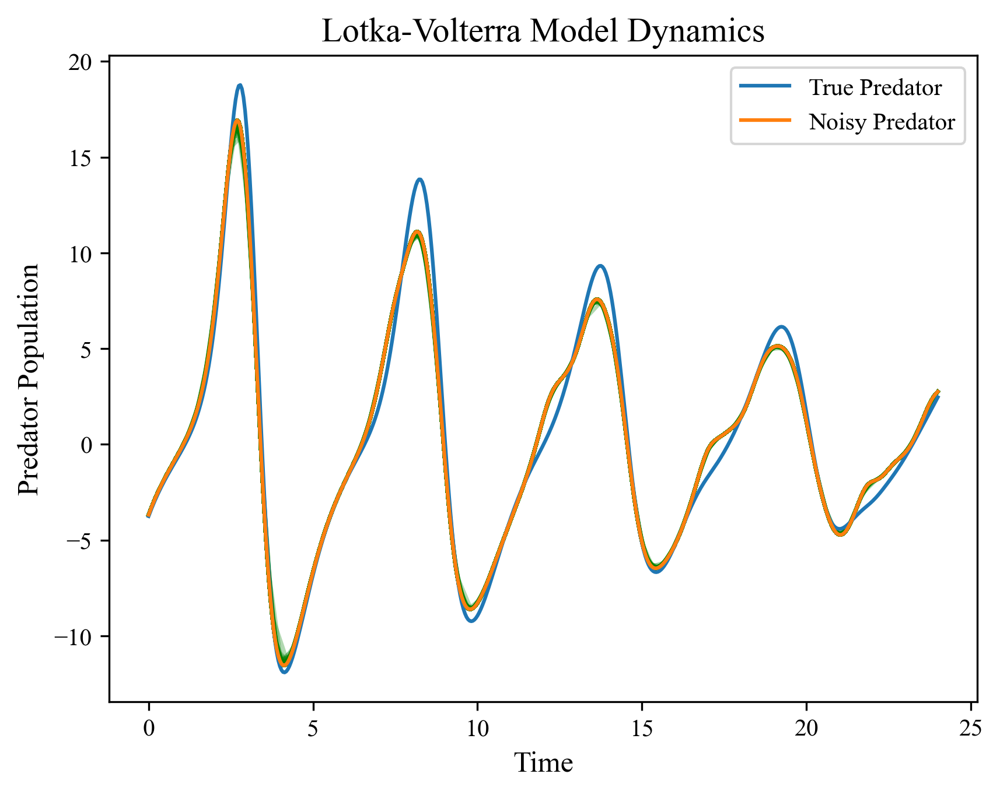

In [68]:
# Generate bootstrapped data paths for the analysis
bootstrapped_samples = generate_population_of_paths(x_dot_noisy, y_dot_noisy)
x_noisy_paths = bootstrapped_samples[:,0]
y_noisy_paths =  bootstrapped_samples[:,1]


# Visualize paths
plt.figure()
plt.title('Lotka-Volterra Model Dynamics')
for xn in x_noisy_paths:
    plt.plot(t, xn, 'g', alpha = 0.3)
plt.plot(t, x_dot_true, label='True Prey')
plt.plot(t, x_dot_noisy, label='Noisy Prey')
plt.xlabel('Time')
plt.ylabel('Prey Population')
plt.legend()
plt.show()

plt.figure()
plt.title('Lotka-Volterra Model Dynamics')
for yn in y_noisy_paths:
    plt.plot(t, yn, 'g', alpha = 0.3)

plt.plot(t, y_dot_true, label='True Predator')
plt.plot(t, y_dot_noisy, label='Noisy Predator')
plt.xlabel('Time')
plt.ylabel('Predator Population')
plt.legend()
plt.show()

### x_dot and y_dot for varying parameter distribution

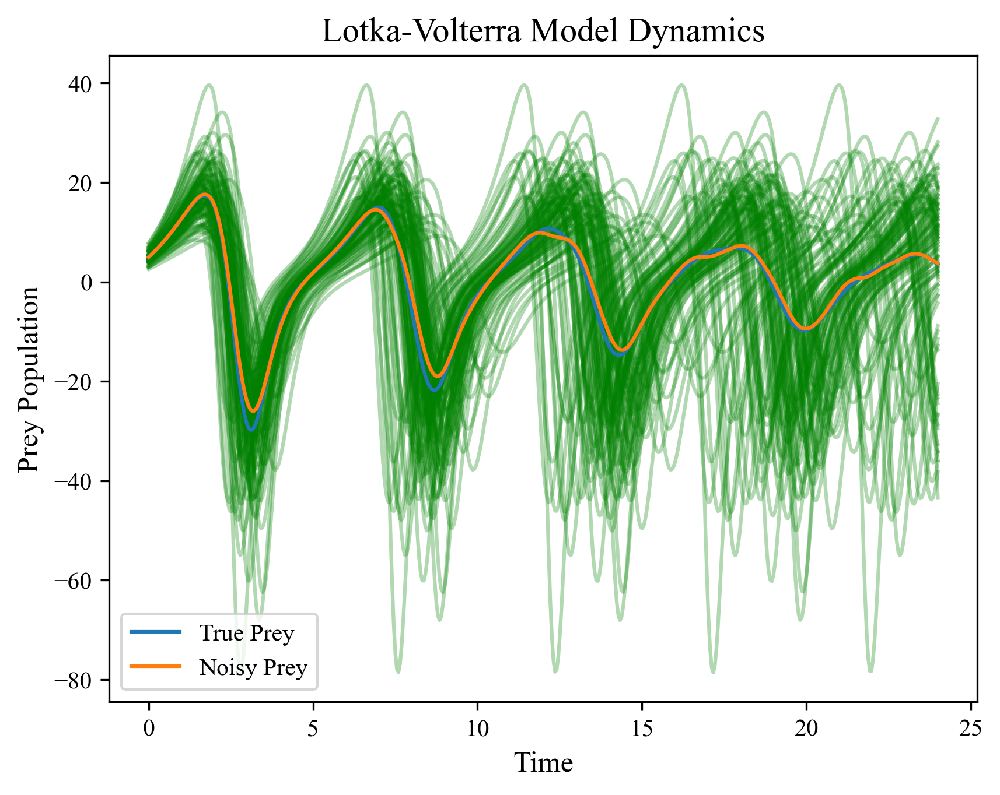

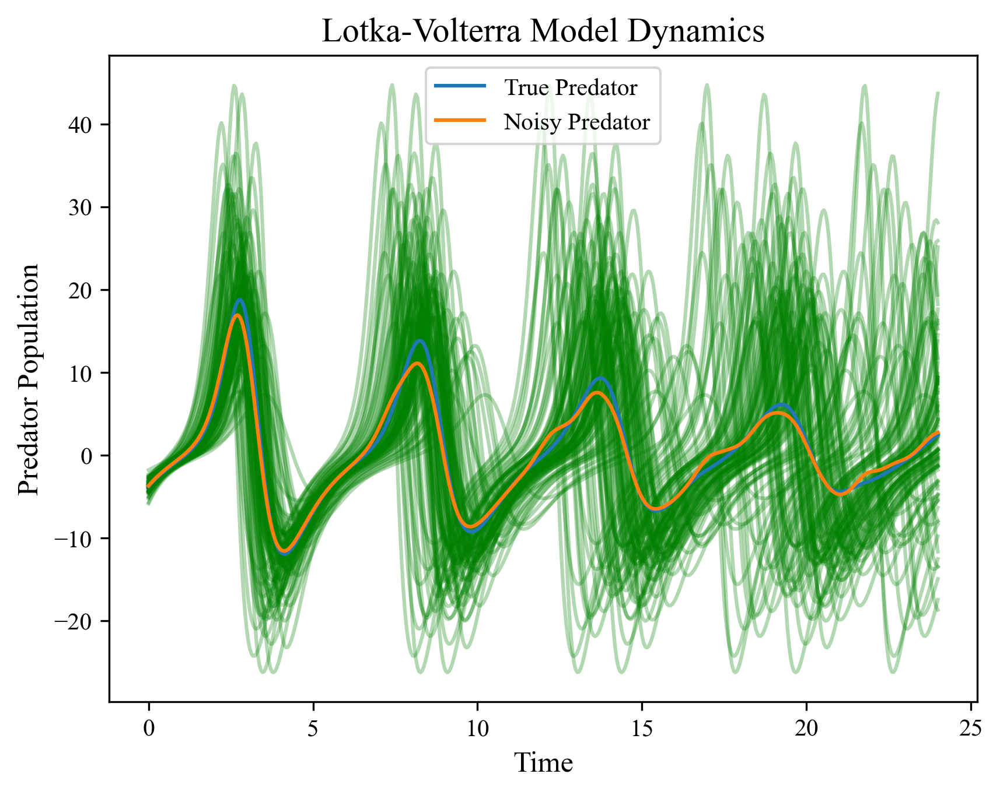

In [69]:
vary = True
if vary:
    x_noisy_paths = []
    y_noisy_paths =  []
    for i in range(len(path_dist)):
        xn = path_dist[i][:,0]
        yn = path_dist[i][:,1]
        x_noisy_paths.append(differentiate(xn, time, wl = 5, order = 6)[0])
        y_noisy_paths.append(differentiate(yn, time, wl = 5, order = 6)[0])

    #make into array
    x_noisy_paths = np.array(x_noisy_paths)
    y_noisy_paths = np.array(y_noisy_paths)
    
    # Visualize paths
    plt.figure()
    plt.title('Lotka-Volterra Model Dynamics')
    for xn in x_noisy_paths:
        plt.plot(t, xn, 'g', alpha = 0.3)
    plt.plot(t, x_dot_true, label='True Prey')
    plt.plot(t, x_dot_noisy, label='Noisy Prey')
    plt.xlabel('Time')
    plt.ylabel('Prey Population')
    plt.legend()
    plt.show()
    
    plt.figure()
    plt.title('Lotka-Volterra Model Dynamics')
    for yn in y_noisy_paths:
        plt.plot(t, yn, 'g', alpha = 0.3)
    
    plt.plot(t, y_dot_true, label='True Predator')
    plt.plot(t, y_dot_noisy, label='Noisy Predator')
    plt.xlabel('Time')
    plt.ylabel('Predator Population')
    plt.legend()
    plt.show()
    

### Analysis on x_dot/x

In [70]:
def gofx(prior_param_samples, library):
    pushforward = [ simulate_param(param, library) for param in prior_param_samples]
    return np.array(pushforward)

Data shape for KDE: (100, 100)
Prior is generated from uniform distribution
low:[-0.04  0.8  -0.04 -0.12] , high:[ 0.04  1.2   0.03 -0.06]

Data shape for KDE: (5000, 100)
[[-1.76200843e-02  1.01294505e+00 -2.74620306e-02 -1.08667388e-01]
 [-2.97702050e-02  9.67438356e-01 -3.49176067e-02 -8.17346644e-02]
 [-2.05849255e-02  1.07333228e+00  2.27477466e-02 -7.05053663e-02]
 [ 1.00251054e-03  1.15119779e+00  4.24807882e-03 -7.86779808e-02]
 [ 7.81787978e-03  1.00096419e+00 -2.93297050e-02 -7.64870578e-02]]
1 was accepted out of 5000 total prior samples
at tym = 0, total samples accepted = 1 

[[ 2.66515290e-02  1.05483567e+00  1.49387753e-02 -1.17134048e-01]
 [-2.02508627e-02  1.15925361e+00 -1.95847374e-02 -8.11902427e-02]
 [-2.88345307e-02  9.01805377e-01  3.87576905e-04 -6.84065892e-02]
 [-2.51599796e-02  9.14969403e-01 -3.85791444e-02 -7.97151856e-02]
 [ 5.29626357e-03  8.25724614e-01 -3.25281012e-02 -9.60197852e-02]]
1 was accepted out of 5000 total prior samples
at tym = 1, total sam

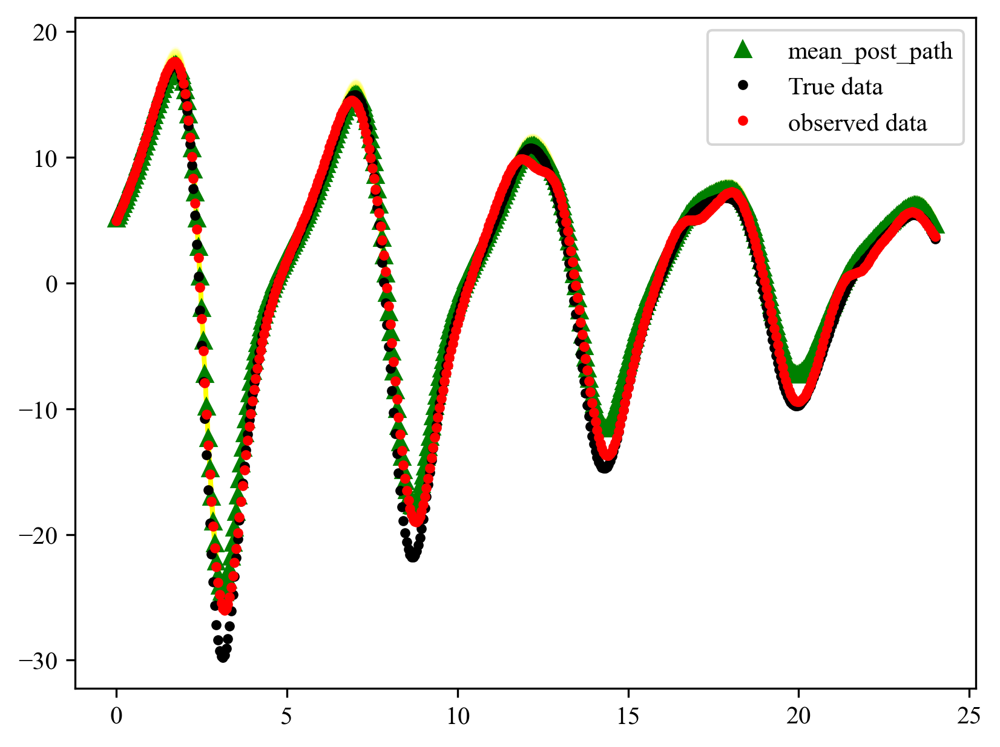

((1.0124020117160124e+88, 0.0),
 array([-0.00197525,  0.95383974,  0.01284499, -0.08941946]),
 array([0.0193359 , 0.0274336 , 0.00861271, 0.00190409]))

In [71]:
# Use kde to create distribution of the observed data paths 
dim = 100
method = 0.25# 'silverman', 'scott'
x_kde_obs = estimate_kde(x_noisy_paths, dim = dim, bw_method = method) #compute kde
x_obs_densities = kde_density_at_points(x_kde_obs,x_noisy_paths, dim=dim) #estimate data densities

# set hyper parameers
num_prior = 5000
Normal = False

# generate prior samples by doing the following: You need to define this in a function
if Normal:    
    # Generate sample points from normal distribution
    print(f'Prior is generated from normal distribution')
    # Generate sample points from normal distribution 
    x_prior_param_mean = np.array([0,1,0,-0.1])
    x_prior_param_std = np.array([0.02,0.1,0.02,0.02]) 
    
    # Generate samples from a normal distribution
    x_prior_param_samples = generate_samples(x_prior_param_mean, x_prior_param_std, num_prior, distribution='normal')
    if num_prior <=1000:
        x_prior_param_samples = expand_2D_array(x_prior_param_samples)
        print(f'Number of prior samples post-pairing = {len(x_prior_param_samples)}')
    # Use the function to generate different sample path
    x_pushforward_prior = gofx(x_prior_param_samples, library)
    print(f'mean:{x_prior_param_mean} , std:{x_prior_param_std} \n')  

else:
    # Generate sample points from uniform distribution
    print(f'Prior is generated from uniform distribution')
    x_prior_param_low =  np.array([-0.04,0.8,-0.04,-0.12]) 
    x_prior_param_high = np.array([0.04,1.2,0.03,-0.06])
    # Generate samples from a uniform distribution
    x_prior_param_samples = generate_samples(x_prior_param_low, x_prior_param_high, num_prior, distribution='uniform')
    # param_pairs = expand_2D_array(obs_param_samples)
    if num_prior <=1000:
        x_prior_param_samples = expand_2D_array(x_prior_param_samples)
        print(f'Number of prior samples post-pairing = {len(x_prior_param_samples)}')
    # Use the function to generate different sample path
    x_pushforward_prior = gofx(x_prior_param_samples, library)
    print(f'low:{x_prior_param_low} , high:{x_prior_param_high}\n')


# use kde with similar parameter as in x_kde_obs to generate pushforward prior kde
x_kde_prior = estimate_kde(x_pushforward_prior, dim = dim, bw_method = method) #compute kde
# prior_densities = kde_density_at_points(x_kde_prior, x_pushforward_prior, dim=dim) #estimate data densities

#Run acceptance rejection sampling to generate posterior
x_post_param_samples = []
tym = 0
tym2 = 0
while len(x_post_param_samples)<200:
    print(x_prior_param_samples[:5])
    if len(x_post_param_samples)<10:
        if Normal:
            x_prior_param_samples = generate_samples(x_prior_param_mean, x_prior_param_std, num_prior, distribution='normal')
        else:
            x_prior_param_samples = generate_samples(x_prior_param_low, x_prior_param_high, num_prior, distribution='uniform')
        # run the acceptance rejection sampling algorithm
        x_post_param_samples.extend(rejection_sampling(x_prior_param_samples, gofx, x_kde_obs, x_kde_prior, library))
        print(f'at tym = {tym}, total samples accepted = {len(x_post_param_samples)} \n')
        tym += 1
        # print(x_post_param_samples)
        # temp = x_post_param_samples
    
        
    else:
        # Generate sample points from uniform distribution
        print(f'Prior is generated from uniform distribution')
        if tym2 == 0:        
            x_prior_param_low =  np.min(x_post_param_samples,0)  
            x_prior_param_high = np.max(x_post_param_samples,0)
            tym2 += 1
        else:
            x_prior_param_low =  np.min(temp,0)  
            x_prior_param_high = np.max(temp,0)
            tym2 += 1
            
        # Generate samples from a uniform distribution
        x_prior_param_samples = generate_samples(x_prior_param_low, x_prior_param_high, n_samples=1000, distribution='uniform')
        
        # Use the function to generate different sample path
        x_pushforward_prior = gofx(x_prior_param_samples, library)
        x_kde_prior = estimate_kde(x_pushforward_prior, dim = dim, bw_method = method) #compute kde
        
        print(f'low:{x_prior_param_low} , high:{x_prior_param_high}\n')
        temp = rejection_sampling(x_prior_param_samples, gofx, x_kde_obs, x_kde_prior, library)
        x_post_param_samples.extend(temp)
        print(f'at tym = {tym}, total samples accepted = {len(x_post_param_samples)} \n')
        tym+=1

x_post_param_samples = np.array(x_post_param_samples)
# Get the pushforward of posterior distribution of each parameter
print(f'Final total number of accepted samples = {len(x_post_param_samples)}')
x_pushforward_posterior = gofx(x_post_param_samples, library)

# compare the pushforward distribution to the observed data using visuals and kl divergence of the kde
# plot_paths(x_actual, observed_paths, color='blue', hl = 'r*',label = 'mean_obs_path')
for path in x_pushforward_posterior:
        plt.plot(t, path, color='yellow', alpha=0.05)  # semi-transparent blue lines
x_mean_path = np.mean(x_pushforward_posterior, axis=0)
plt.plot(t, x_mean_path, 'g^' , label='mean_post_path')
plt.plot(t, x_dot_true, 'k.', label = 'True data')
plt.plot(t, x_dot_noisy, 'r.', label = 'observed data')
plt.legend()
plt.show()

# kl divergence
kl_divs = kl_divergence(x_noisy_paths,x_pushforward_posterior, bandwidth=method )
kl_divs,np.mean(x_post_param_samples,0), np.std(x_post_param_samples,0)        

Data shape for KDE: (100, 100)
Prior is generated from uniform distribution
low:[-0.04 -0.04 -2.    0.05] , high:[ 0.04  0.04 -1.    0.1 ]

Data shape for KDE: (5000, 100)
1 was accepted out of 5000 total prior samples
at tym = 0, total samples accepted = 1 

1 was accepted out of 5000 total prior samples
at tym = 1, total samples accepted = 2 

1 was accepted out of 5000 total prior samples
at tym = 2, total samples accepted = 3 

1 was accepted out of 5000 total prior samples
at tym = 3, total samples accepted = 4 

1 was accepted out of 5000 total prior samples
at tym = 4, total samples accepted = 5 

1 was accepted out of 5000 total prior samples
at tym = 5, total samples accepted = 6 

1 was accepted out of 5000 total prior samples
at tym = 6, total samples accepted = 7 

1 was accepted out of 5000 total prior samples
at tym = 7, total samples accepted = 8 

1 was accepted out of 5000 total prior samples
at tym = 8, total samples accepted = 9 

1 was accepted out of 5000 total pri

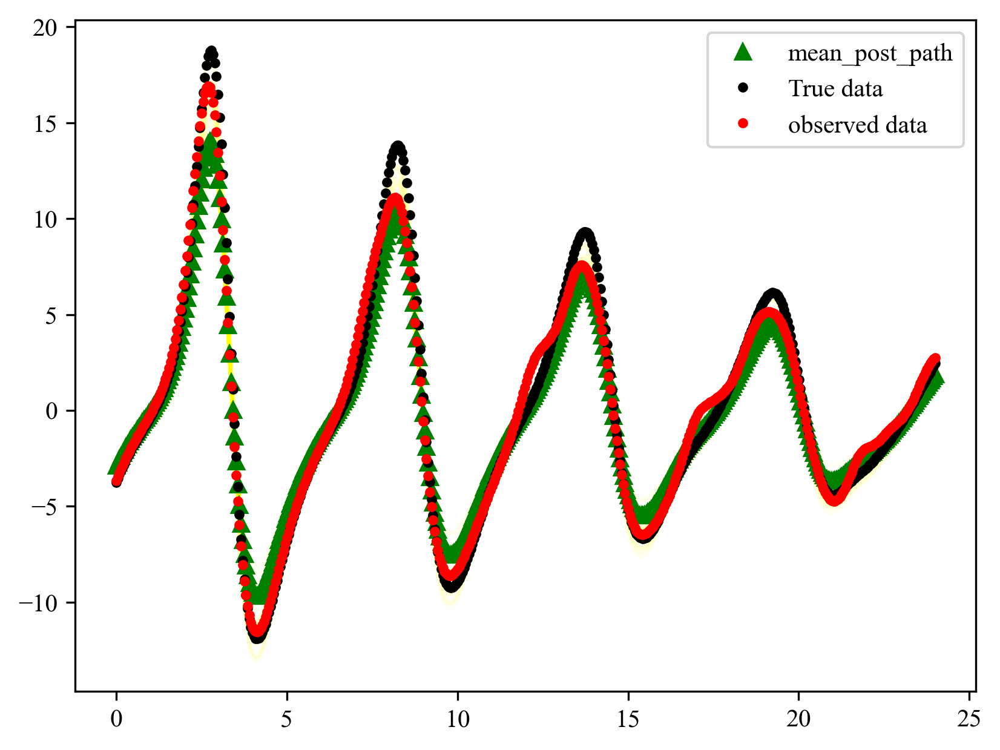

((5.19459294243394e+87, 0.0),
 array([ 0.00840396,  0.02209568, -1.18697162,  0.05649324]),
 array([0.00397689, 0.00465731, 0.03315713, 0.00158258]))

In [72]:
# Use kde to create distribution of the observed data paths 
y_kde_obs = estimate_kde(y_noisy_paths, dim = dim, bw_method = method) #compute kde
y_obs_densities = kde_density_at_points(y_kde_obs,y_noisy_paths, dim=dim) #estimate data densities

# set hyper parameers
num_prior = 5000
# Normal = True

# generate prior samples by doing the following: You need to define this in a function
if Normal:    
    # Generate sample points from normal distribution
    print(f'Prior is generated from normal distribution')
    # Generate sample points from normal distribution 
    y_prior_param_mean = np.array( [0,0,-1.5,0.075])
    y_prior_param_std = np.array([0.02,0.02,0.5,0.05]) 
    
    # Generate samples from a normal distribution
    y_prior_param_samples = generate_samples(y_prior_param_mean, y_prior_param_std, num_prior, distribution='normal')
    if num_prior <=1000:
        y_prior_param_samples = expand_2D_array(y_prior_param_samples)
        print(f'Number of prior samples post-pairing = {len(y_prior_param_samples)}')
    # Use the function to generate different sample path
    y_pushforward_prior = gofx(y_prior_param_samples, library)
    print(f'mean:{y_prior_param_mean} , std:{y_prior_param_std} \n')  

else:
    # Generate sample points from uniform distribution
    print(f'Prior is generated from uniform distribution')
    y_prior_param_low =  np.array([-0.04,-0.04, -2, 0.05]) 
    y_prior_param_high = np.array([0.04,0.04, -1, 0.1])
    # Generate samples from a uniform distribution
    y_prior_param_samples = generate_samples(y_prior_param_low, y_prior_param_high, num_prior, distribution='uniform')
    # param_pairs = expand_2D_array(obs_param_samples)
    if num_prior <=1000:
        y_prior_param_samples = expand_2D_array(y_prior_param_samples)
        print(f'Number of prior samples post-pairing = {len(y_prior_param_samples)}')
    # Use the function to generate different sample path
    y_pushforward_prior = gofx(y_prior_param_samples, library)
    print(f'low:{y_prior_param_low} , high:{y_prior_param_high}\n')


# use kde with similar parameter as in y_kde_obs to generate pushforward prior kde
y_kde_prior = estimate_kde(y_pushforward_prior, dim = dim, bw_method = method) #compute kde
# prior_densities = kde_density_at_points(y_kde_prior, y_pushforward_prior, dim=dim) #estimate data densities

#Run acceptance rejection sampling to generate posterior
y_post_param_samples = []
tym = 0
tym2 = 0
while len(y_post_param_samples)<500:
    if len(y_post_param_samples)<10:
        if Normal:
            y_prior_param_samples = generate_samples(y_prior_param_mean, y_prior_param_std, num_prior, distribution='normal')
        else:
            y_prior_param_samples = generate_samples(y_prior_param_low, y_prior_param_high, num_prior, distribution='uniform')
        # run the acceptance rejection sampling algorithm
        y_post_param_samples.extend(rejection_sampling(y_prior_param_samples, gofx, y_kde_obs, y_kde_prior, library))
        print(f'at tym = {tym}, total samples accepted = {len(y_post_param_samples)} \n')
        tym += 1
        # temp = y_post_param_samples
        
    else:
        # Generate sample points from uniform distribution
        print(f'Prior is generated from uniform distribution')
        if tym2 == 0:
            y_prior_param_low =  np.min(y_post_param_samples,0)
            y_prior_param_high = np.max(y_post_param_samples,0)
            tym2 += 1
        else:
            y_prior_param_low =  np.min(temp,0)  
            y_prior_param_high = np.max(temp,0)
            tym2 += 1
       
        # Generate samples from a uniform distribution
        y_prior_param_samples = generate_samples(y_prior_param_low, y_prior_param_high, n_samples=1000, distribution='uniform')
        
        # Use the function to generate different sample path
        y_pushforward_prior = gofx(y_prior_param_samples, library)
        y_kde_prior = estimate_kde(y_pushforward_prior, dim = dim, bw_method = method) #compute kde
        
        print(f'low:{y_prior_param_low} , high:{y_prior_param_high}\n')
        temp = rejection_sampling(y_prior_param_samples, gofx, y_kde_obs, y_kde_prior, library)
        y_post_param_samples.extend(temp)
        print(f'at tym = {tym}, total samples accepted = {len(y_post_param_samples)} \n')
        tym+=1

y_post_param_samples = np.array(y_post_param_samples)
# Get the pushforward of posterior distribution of each parameter
print(f'Final total number of accepted samples = {len(y_post_param_samples)}')
y_pushforward_posterior = gofx(y_post_param_samples, library)

# compare the pushforward distribution to the observed data using visuals and kl divergence of the kde
# plot_paths(y_actual, observed_paths, color='blue', hl = 'r*',label = 'mean_obs_path')
for path in y_pushforward_posterior:
        plt.plot(t, path, color='yellow', alpha=0.05)  # semi-transparent blue lines
y_mean_path = np.mean(y_pushforward_posterior, axis=0)
plt.plot(t, y_mean_path, 'g^' , label='mean_post_path')
plt.plot(t, y_dot_true, 'k.', label = 'True data')
plt.plot(t, y_dot_noisy, 'r.', label = 'observed data')
plt.legend()
plt.show()


# kl divergence
kl_divs = kl_divergence(y_noisy_paths,y_pushforward_posterior, bandwidth=method )
kl_divs,np.mean(y_post_param_samples,0), np.std(y_post_param_samples,0)        

### Visualize recovered data

In [73]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.stats import gaussian_kde
   
def plot_kde_matrix(data, titles, color='orange', name='SIP method', xlim = (-2,2)):
    data = np.array(data)

    n, m = data.shape
    mn,mx = np.min(data)-0.05, np.max(data)+0.05
    if len(titles) != m:
        raise ValueError("Length of titles vector must be equal to the number of columns in data.")
    
    fig, axes = plt.subplots(m, 1, figsize=(2.5, 1.5 * m), sharex='col', gridspec_kw={'hspace': 0})
    for i in range(m):
        kde = gaussian_kde(data[:, i])
        x = np.linspace(min(data[:, i]), max(data[:, i]), 1000)
        # mn,mx = np.min(x)-0.05, np.max(x)+0.05
        axes[i].plot(x, kde(x), color=color)
        axes[i].fill_between(x, kde(x), color=color, alpha=0.5)
        mean_val = np.mean(data[:, i])
        axes[i].axvline(mean_val, color='red', linestyle='--', linewidth=1, label=f'mean= {mean_val.round(2)}')
        axes[i].axvline(0, color='black', linestyle='-.')
        axes[i].set_xlim(mn,mx)
        axes[i].set_ylabel(titles[i], rotation=0, labelpad=40)
        # Position legend in the top right corner of each subplot
        axes[i].legend(loc='upper right', draggable = True)
        axes[i].yaxis.set_label_position("left")
        axes[i].spines['top'].set_visible(False)
        axes[i].spines['right'].set_visible(False)
        axes[i].spines['left'].set_visible(False)
        axes[i].spines['bottom'].set_visible(True)
        axes[i].get_xaxis().set_visible(True)
        axes[i].tick_params(axis='x', which='both', bottom=True)
        axes[i].tick_params(axis='y', which='both', left=False, right=False)  # Remove vertical ticks
        axes[i].set_yticklabels([])  # Remove vertical tick labels
        
    plt.subplots_adjust(left=0.3)  # Adjust this as necessary to fit titles
    plt.xlabel('Value')  # Set common xlabel for the horizontal axis
    plt.suptitle(name)
    plt.show()

# # Example usage with a dummy dataset
# data = np.random.randn(100, 3)  # 100 samples and 3 features
# titles = ['Feature 1', 'Feature 2', 'Feature 3']
# plot_kde_matrix(data, titles, color='orange')


# UQ-SINDy for the recovery

### Data specification

In [24]:
# Lotka-Volterra model equations
def lotka_volterra_system(state, t, alpha, beta, delta, gamma):
    x, y = state
    dx_dt = alpha * x - beta * x * y
    dy_dt = delta * x * y - gamma * y
    return [dx_dt, dy_dt]

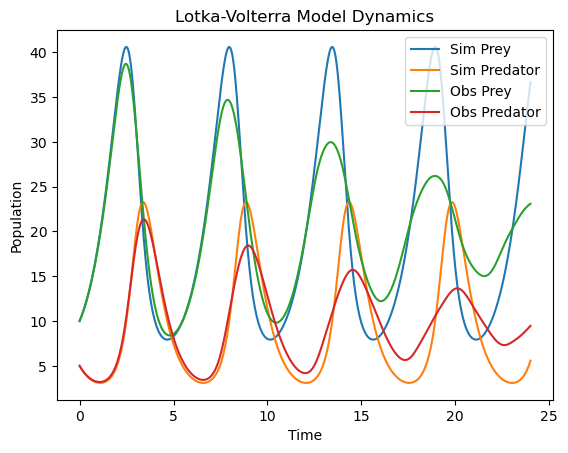

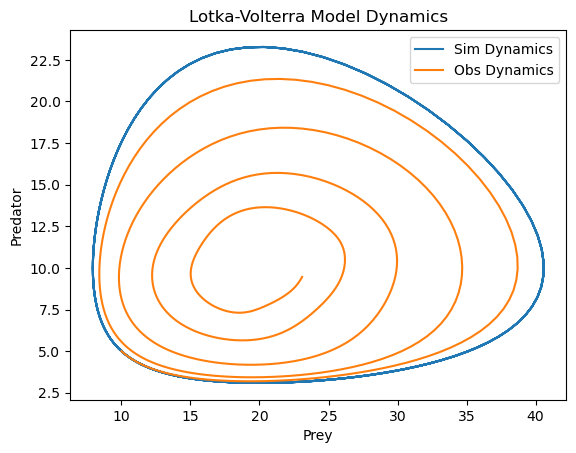

In [25]:
#General parameters

# # simulation Parameters
# alpha = 1
# beta = 0.1
# delta = 0.075
# gamma = 1.5
params = (alpha, beta, delta, gamma)

u_data,v_data = x_noisy,y_noisy

# Initial conditions
u0 = 10
v0 = 5
initial_state = [u0, v0] #

# Time points
time =t

# Solve ODE
solution = odeint(lotka_volterra_system, initial_state, time, args=params)
u_sim, v_sim = solution.T

# plot and compare simulation versus observed data
plt.figure()
plt.title('Lotka-Volterra Model Dynamics')
plt.plot(t, u_sim, label='Sim Prey')
plt.plot(t, v_sim, label='Sim Predator')
plt.plot(t, u_data, label='Obs Prey')
plt.plot(t, v_data, label='Obs Predator')

plt.xlabel('Time')
plt.ylabel('Population')
plt.legend()
plt.show()

plt.figure()
plt.title('Lotka-Volterra Model Dynamics')
plt.plot(u_sim, v_sim, label='Sim Dynamics')
plt.plot(u_data, v_data, label='Obs Dynamics')

plt.xlabel('Prey')
plt.ylabel('Predator')
plt.legend()
plt.show()

### Global learning function

In [26]:
def generate_library(x,y):
    x= np.array(x)
    y = np.array(y)
    lib_mat = np.array([np.ones(len(x)), x, y, x*y]).T
    return lib_mat

def simulate_param(params, library):
    params = np.array(params).reshape(-1,1)
    return np.dot(library, params).reshape(-1)

def integrate_x_dot(x_dot, t, init_val):
    """
    Integrates x_dot with respect to time t using the cumulative trapezoidal rule.

    Parameters:
    - x_dot: Array of derivative values with respect to time (velocity if x is position).
    - t: Array of time values.

    Returns:
    - x: Array of integrated values (position if x_dot is velocity), same length as t by adding initial condition.
    """
    # Compute the cumulative integral of x_dot with respect to t
    x = cumulative_trapezoid(x_dot, t, initial=0)+init_val  # Set initial=0 to include the starting point in the result array

    return x

def numerate_param(param, library, init_val, t=t):
    z_dot = simulate_param(param, library)
    z_intgrt = integrate_x_dot(z_dot, t, init_val)
    return z_intgrt

import pysindy as ps
# differentiation function
def differentiate(data,time, wl = 5, order = 3):
    smoothed_fd = ps.SmoothedFiniteDifference(order=order, smoother_kws={'window_length': wl})
    dldt = smoothed_fd(data,time)
    d2ldt = smoothed_fd(dldt, time)
    d3ldt = smoothed_fd(d2ldt, time)
    return [dldt,d2ldt,d3ldt] 

def mean_squared_error(y_true, y_pred):
    """
    Calculates the Mean Squared Error (MSE) between two arrays.
    """
    y_true = np.array(y_true)  # Ensure the input is a numpy array
    y_pred = np.array(y_pred)  # Ensure the input is a numpy array

    # Calculate the MSE
    mse = np.mean((y_true - y_pred) ** 2)
    return mse

Plot of wl = 5 MSE value = 1.6214922976868429


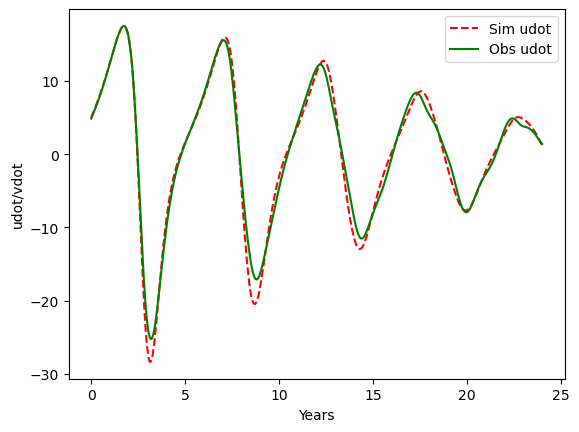

In [27]:
# Generate library data
library = generate_library(u_data, v_data)

# Define true parameters
u_param_true = [0, 1, 0, -0.1]
v_param_true = [0, 0, -1.5, 0.075]

# Simulate x_dot and v_dot
u_dot_true = simulate_param(u_param_true, library)
v_dot_true = simulate_param(v_param_true, library)

# Differentiate true data

u_dot_noisy =  differentiate(u_data, time, wl = 5, order=6)[0]
v_dot_noisy = differentiate(v_data, time, wl =7, order=4)[0]

mse =  mean_squared_error(u_dot_true, u_dot_noisy)
print(f'Plot of wl = {5} MSE value = {mse}')


# Directly simulate x and v
u_intgrt_true = numerate_param(u_param_true, library, init_val=u0, t=t)
v_intgrt_true = numerate_param(v_param_true, library, init_val=v0, t=t)

plt.plot(t, u_dot_true, 'r--', label = 'Sim udot')
plt.plot(t, u_dot_noisy, 'g', label = 'Obs udot')
# plt.plot(t, v_dot_true, 'b--', label = 'Sim vdot')
# plt.plot(t, v_dot_noisy, 'y', label = 'Obs vdot')
plt.legend()
plt.xlabel(f'Years')
plt.ylabel(f'udot/vdot')
plt.show()

### Learning prey parameters

In [28]:
def calc_mean(posterior):
    return np.mean(posterior,0)

In [29]:
# Initialize the parameters (params and sigma)
u_start_params = np.zeros(4) #calc_mean(chain_param_ltk.params) #
u_start_sigma = 0.1 #calc_mean(chain_eps_ltk.sigma) #
num_step = 100


u_Posterior_params = []
u_Posterior_sigma = []
# While the number of steps is less than a preset
step = 0
while step<num_step:
    if step%5 == 0:
        print(f'______________________________________________________________________{step}th iteration_________________________________________________________________')
    
    # Sample new params given sigma using ABC likelihood without gamma
    def log_likelihood(u_params):
        a,b,c,d = u_params
        sig = u_start_sigma
        
        # predict udot
        udot_predict = simulate_param(u_params, library).reshape(-1)
        
        model = smp.Model()
        # Log-likelihood
        model.add(smp.normal(udot_predict, mu=u_dot_noisy, sig=sig))   
    
        # log-priors
        model.add(smp.uniform(a, lower = -2, upper=2),
                  smp.uniform(b, lower = -2, upper=2),
                  smp.uniform(c, lower = -2 , upper=2),
                  smp.uniform(d, lower = -2, upper=2)
                 )
        return model()


    u_start_params_ltk = {'u_params': u_start_params} # Set the starting model parameter
    # print(f'Params start = {u_start_params_ltk}') # Print the starting model parameter
    hmc_param_ltk = smp.Slice(log_likelihood, u_start_params_ltk)
    chain_param_ltk = hmc_param_ltk.sample(100, burn=50, n_chains=1)
    #Replace current with accepted params
    u_start_params = calc_mean(chain_param_ltk.u_params)
    
    
   
    # Sample new sigma given new params using sigma likelihood
    def sigma_likelihood(u_sigma):
        sig = u_sigma
        
        # predict udot
        udot_predict = simulate_param(u_start_params, library).reshape(-1)
        
        model = smp.Model()
        
        # Log-likelihood
        model.add(smp.normal(udot_predict, mu=u_dot_noisy, sig=sig))    
        # log-priors
        model.add(smp.exponential(sig))
        return model()
    
    #Sampling sigma given the parameters
    start_eps_ltk = {'u_sigma': u_start_sigma} # Set the starting sigma parameter
    print(f'sigma start = {start_eps_ltk}') # Print the starting sigma parameter
    hmc_eps_ltk = smp.Slice(sigma_likelihood, start_eps_ltk) #Hamiltonian, Slice, NUTS, Metropolis
    chain_eps_ltk = hmc_eps_ltk.sample(100, burn=50, n_chains=1)
    u_start_sigma = calc_mean(chain_eps_ltk.u_sigma)
    
    # Store the new params and sigma
    u_Posterior_params.append(u_start_params)
    u_Posterior_sigma.append(u_start_sigma)
    
    #Repeat step 3-5 
    step +=1
    # mean_params = start_params
    print(f'Recovered u_params = {u_start_params}')
    print(f'Recovered u_sigma = {u_start_sigma} \n\n')
    

______________________________________________________________________0th iteration_________________________________________________________________
Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [-0.12627623  0.8711678  -0.28700893 -0.07447296]
Recovered u_sigma = 1.3152408544664091 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 1.3152408544664091}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [-0.12312479  0.93215205 -0.26997491 -0.07996338]
Recovered u_sigma = 1.0552449664346177 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 1.0552449664346177}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [-0.09026061  0.9612796  -0.2046685  -0.08528997]
Recovered u_sigma = 0.94083812266514 


Progress: [########

[ 0.01137401  0.95038903 -0.15784197 -0.08682043] 0.9098896437676857


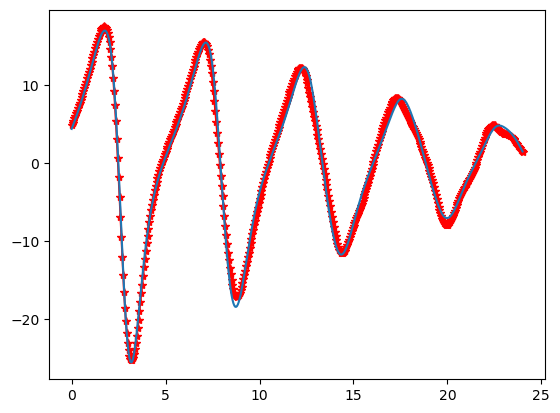

In [30]:
print(calc_mean(u_Posterior_params), calc_mean(u_Posterior_sigma))

u_dot_post = simulate_param(calc_mean(u_Posterior_params), library)
plt.plot(t, u_dot_noisy, 'r*-')
plt.plot(t, u_dot_post)
plt.show()

### Learning predator params

In [31]:
# Initialize the parameters (params and sigma)
v_start_params = np.zeros(4) #calc_mean(chain_param_ltk.params) #
v_start_sigma = 0.1 #calc_mean(chain_eps_ltk.sigma) #

v_Posterior_params = []
v_Posterior_sigma = []
# While the number of steps is less than a preset
step = 0
while step<num_step:
    if step%10 == 0:
        print(f'______________________________________________________________________{step}th iteration_________________________________________________________________')
    
    # Sample new params given sigma using ABC likelihood without gamma
    def log_likelihood(v_params):
        a,b,c,d = v_params
        sig = v_start_sigma
        
        # predict udot
        udot_predict = simulate_param(v_params, library).reshape(-1)
        
        model = smp.Model()
        # Log-likelihood
        model.add(smp.normal(udot_predict, mu=v_dot_noisy, sig=sig))   
    
        # log-priors
        model.add(smp.uniform(a, lower = -2, upper=2),
                  smp.uniform(b, lower = -2, upper=2),
                  smp.uniform(c, lower = -2, upper=2),
                  smp.uniform(d, lower = -2, upper=2)
                 )
        return model()


    v_start_params_ltk = {'v_params': v_start_params} # Set the starting model parameter
    print(f'Params start = {v_start_params_ltk}') # Print the starting model parameter
    hmc_param_ltk = smp.Slice(log_likelihood, v_start_params_ltk)
    chain_param_ltk = hmc_param_ltk.sample(100, burn=50, n_chains=1)
    #Replace current with accepted params
    v_start_params = calc_mean(chain_param_ltk.v_params)
    
    
   
    # Sample new sigma given new params using sigma likelihood
    def sigma_likelihood(v_sigma):
        sig = v_sigma
        
        # predict udot
        udot_predict = simulate_param(v_start_params, library).reshape(-1)
        
        model = smp.Model()
        
        # Log-likelihood
        model.add(smp.normal(udot_predict, mu=v_dot_noisy, sig=sig))    
        # log-priors
        model.add(smp.exponential(sig))
        return model()
    
    #Sampling sigma given the parameters
    start_eps_ltk = {'v_sigma': v_start_sigma} # Set the starting sigma parameter
    print(f'sigma start = {start_eps_ltk}') # Print the starting sigma parameter
    hmc_eps_ltk = smp.Slice(sigma_likelihood, start_eps_ltk) #Hamiltonian, Slice, NUTS, Metropolis
    chain_eps_ltk = hmc_eps_ltk.sample(100, burn=50, n_chains=1)
    v_start_sigma = calc_mean(chain_eps_ltk.v_sigma)
    
    # Store the new params and sigma
    v_Posterior_params.append(v_start_params)
    v_Posterior_sigma.append(v_start_sigma)
    
    #Repeat step 3-5 
    step +=1
    # mean_params = start_params
    print(f'Recovered v_params = {v_start_params}')
    print(f'Recovered v_sigma = {v_start_sigma} \n\n')
    

______________________________________________________________________0th iteration_________________________________________________________________
Params start = {'v_params': array([0., 0., 0., 0.])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [-0.04046554  0.01088039 -0.40792746  0.02515741]
Recovered v_sigma = 3.7026554128133817 


Params start = {'v_params': array([-0.04046554,  0.01088039, -0.40792746,  0.02515741])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 3.7026554128133817}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [-0.03383707  0.0305181  -0.55409664  0.02970013]
Recovered v_sigma = 3.163480637196047 


Params start = {'v_params': array([-0.03383707,  0.0305181 , -0.55409664,  0.02970013])}
Progress: [##############################] 100 of 100 samples
sigma st

[-0.38070596  0.09519941 -1.33750158  0.05908441] 0.7825314417518122


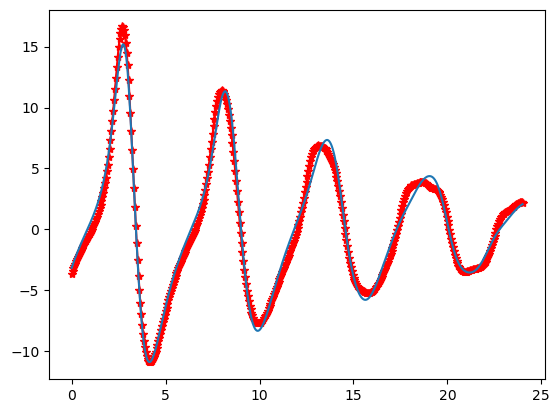

In [32]:
print(calc_mean(v_Posterior_params), calc_mean(v_Posterior_sigma))

v_dot_post = simulate_param(calc_mean(v_Posterior_params), library)
plt.plot(t, v_dot_noisy, 'r*-')
plt.plot(t, v_dot_post)
plt.show()

### Multiple paths learning using Bayesian Approach

______________________________________________________________________0th iteration_________________________________________________________________
Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [0.19245747 0.1907803  0.03312593 0.07392787]
Recovered u_sigma = 7.817408685071741 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 7.817408685071741}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [-0.47493164  0.29055584  1.03266227  0.02531565]
Recovered u_sigma = 6.901391754895157 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 6.901391754895157}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [-0.57160586  0.36652823  0.95448466  0.02264105]
Recovered u_sigma = 6.873473983096522 


Progress: [###############

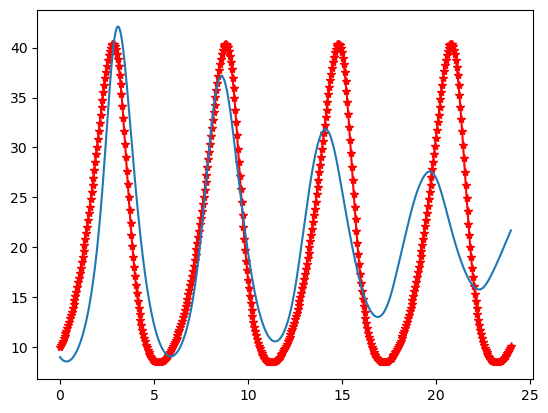

______________________________________________________________________0th iteration_________________________________________________________________
Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [ 0.05202303  0.81860828 -0.18015582  0.03151601]
Recovered u_sigma = 4.47572040010915 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 4.47572040010915}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [-0.30623599  0.98617418 -0.7377304   0.04313639]
Recovered u_sigma = 3.8954051880992013 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 3.8954051880992013}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [-0.41425795  0.96760739 -0.78741316  0.04695895]
Recovered u_sigma = 3.924362970353423 


Progress: [###########

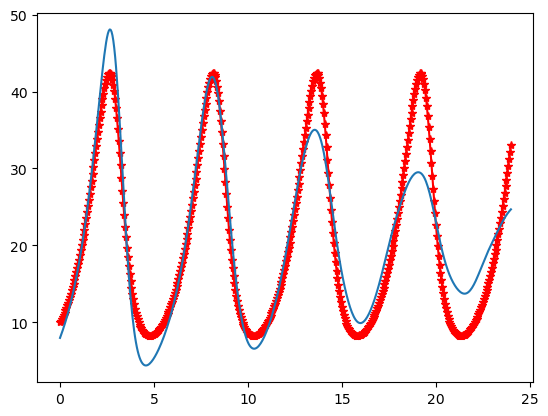

______________________________________________________________________0th iteration_________________________________________________________________
Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [ 1.06470521  0.7655698   0.69444235 -0.00638087]
Recovered u_sigma = 11.01209526201683 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 11.01209526201683}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [ 1.06025143  1.53640648  0.6807358  -0.06945796]
Recovered u_sigma = 8.816728562004284 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 8.816728562004284}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [ 0.87860229  1.5488143   0.12235141 -0.04579073]
Recovered u_sigma = 7.460656799877042 


Progress: [###########

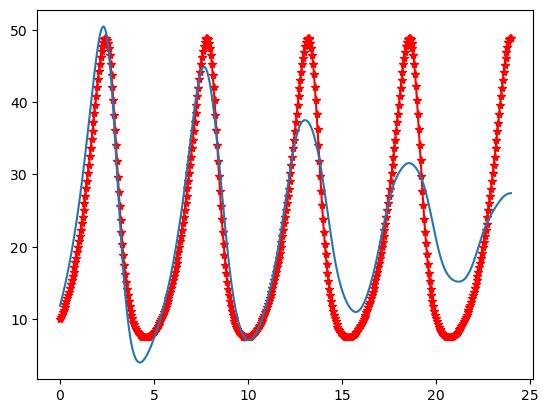

______________________________________________________________________0th iteration_________________________________________________________________
Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [-0.2197958   0.64001482 -0.39637125  0.05064704]
Recovered u_sigma = 4.3405106353521745 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 4.3405106353521745}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [-0.24388918  0.71296409 -0.35701346  0.04293549]
Recovered u_sigma = 4.3068956398835585 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 4.3068956398835585}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [-0.25024425  0.68379112 -0.35997502  0.04563862]
Recovered u_sigma = 4.32221707098109 


Progress: [########

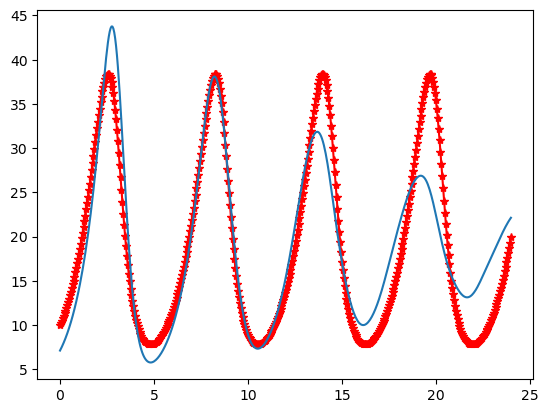

______________________________________________________________________0th iteration_________________________________________________________________
Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [-1.32834281  1.09873151 -0.47480216  0.03658391]
Recovered u_sigma = 4.8099437368946205 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 4.8099437368946205}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [-1.37468151  0.96048188 -0.68129154  0.05787607]
Recovered u_sigma = 4.479207073329281 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 4.479207073329281}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [-1.32863666  0.93273714 -0.72627269  0.0619438 ]
Recovered u_sigma = 4.436742512087708 


Progress: [#########

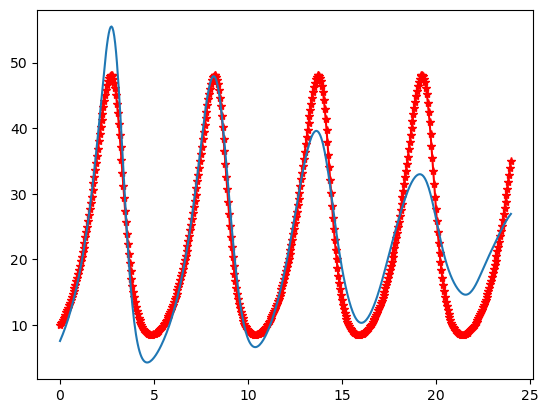

______________________________________________________________________0th iteration_________________________________________________________________
Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [-1.08806923  1.90644747  0.49488405 -0.10276986]
Recovered u_sigma = 11.504297314850742 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 11.504297314850742}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [-1.11584681  1.98790396  0.59406644 -0.11297716]
Recovered u_sigma = 11.227674869557518 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 11.227674869557518}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [-1.16223556  1.98896078  0.63039324 -0.11536455]
Recovered u_sigma = 11.276335942864762 


Progress: [######

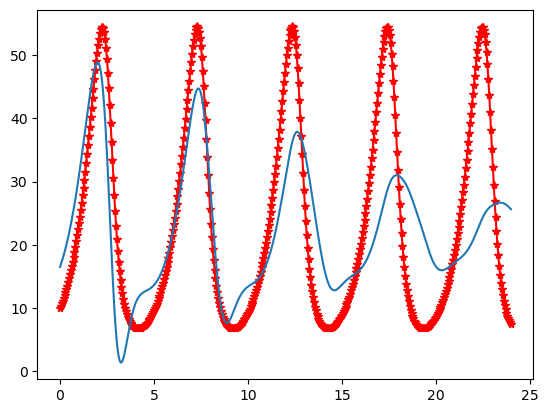

______________________________________________________________________0th iteration_________________________________________________________________
Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [-0.28737315  0.65989942 -0.01559766  0.0438114 ]
Recovered u_sigma = 3.8745751233518324 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 3.8745751233518324}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [-0.29490882  0.69299337 -0.31233628  0.05374215]
Recovered u_sigma = 3.675243711268933 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 3.675243711268933}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [ 0.0039777   0.7022531  -0.36698821  0.05414018]
Recovered u_sigma = 3.7046763781212526 


Progress: [########

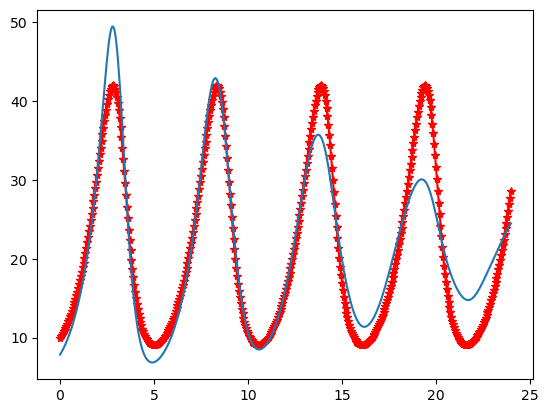

______________________________________________________________________0th iteration_________________________________________________________________
Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [0.71022016 0.66171845 0.14261321 0.01921661]
Recovered u_sigma = 6.008898588709054 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 6.008898588709054}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [ 0.64918208  0.65230174 -0.25084325  0.03742363]
Recovered u_sigma = 5.710202094371453 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 5.710202094371453}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [ 0.69106146  0.61109016 -0.3607989   0.04512988]
Recovered u_sigma = 5.627897293754196 


Progress: [###############

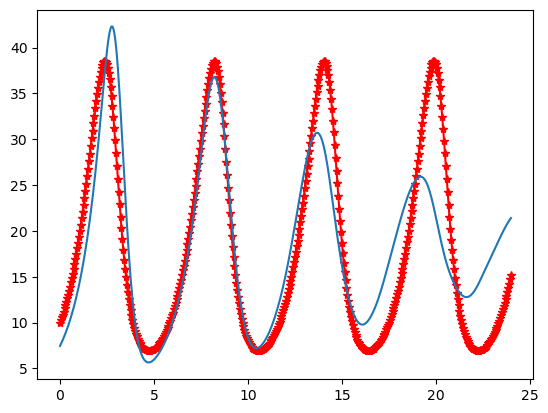

______________________________________________________________________0th iteration_________________________________________________________________
Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [-0.16622247  0.55773878 -0.30127391  0.05393169]
Recovered u_sigma = 5.052449210545237 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 5.052449210545237}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [-0.27256823  0.64977737 -0.18723134  0.04160432]
Recovered u_sigma = 4.997773698821663 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 4.997773698821663}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [-0.31227589  0.67407334 -0.26584189  0.04323332]
Recovered u_sigma = 4.972099768596499 


Progress: [###########

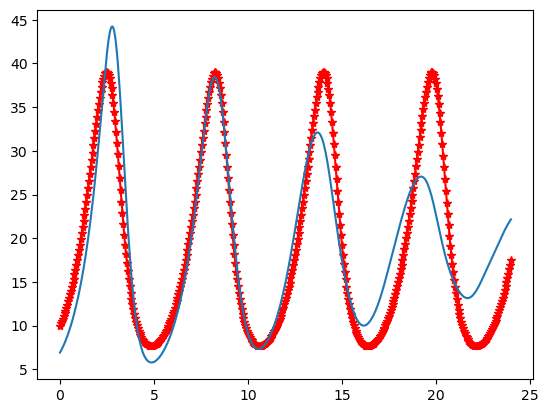

______________________________________________________________________0th iteration_________________________________________________________________
Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [-0.456392    0.36534172 -0.54117084  0.0857218 ]
Recovered u_sigma = 8.95117779727924 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 8.95117779727924}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [0.44552838 0.2785379  0.41628831 0.04813229]
Recovered u_sigma = 8.036593006734817 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 8.036593006734817}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [0.44221379 0.33428081 0.48380394 0.0411044 ]
Recovered u_sigma = 7.985277201482441 


Progress: [#####################

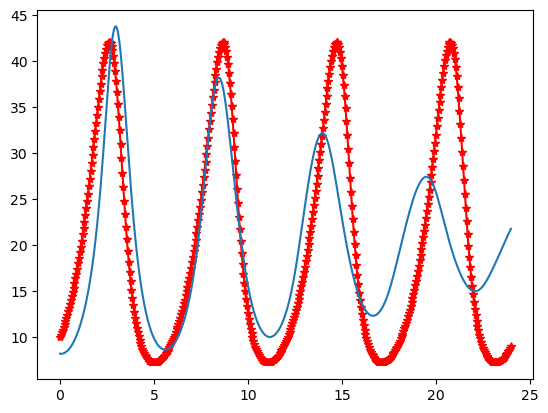

______________________________________________________________________0th iteration_________________________________________________________________
Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [ 0.5384554   0.52242791 -0.03242769  0.03598521]
Recovered u_sigma = 5.1507655170739675 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 5.1507655170739675}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [0.48751159 0.35332324 0.24585512 0.03825688]
Recovered u_sigma = 4.475719288935665 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 4.475719288935665}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [0.46334474 0.35916222 0.41125275 0.03104416]
Recovered u_sigma = 4.297594403810479 


Progress: [#################

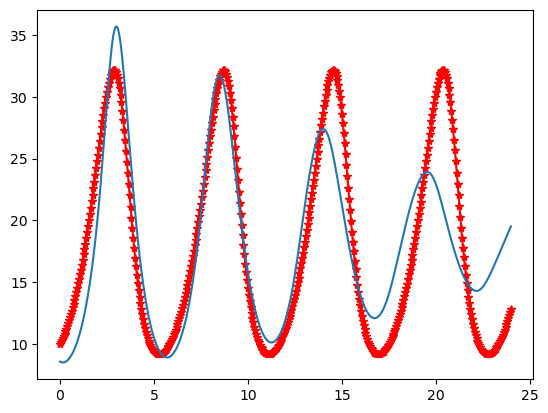

______________________________________________________________________0th iteration_________________________________________________________________
Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [ 0.07909477  0.40952692 -0.14336164  0.08121937]
Recovered u_sigma = 5.469256990867018 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 5.469256990867018}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [-0.04169954  0.37202712  0.18775518  0.07058843]
Recovered u_sigma = 5.3648312755174095 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 5.3648312755174095}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [-0.29131121  0.40201482  0.13190498  0.07123147]
Recovered u_sigma = 5.297940669654285 


Progress: [#########

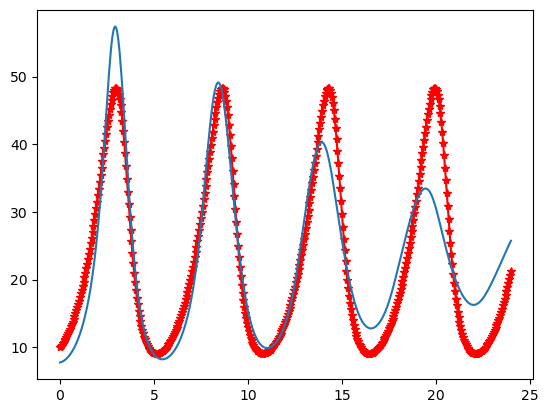

______________________________________________________________________0th iteration_________________________________________________________________
Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [0.02382182 0.31848093 0.32598703 0.03181792]
Recovered u_sigma = 5.719872985303368 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 5.719872985303368}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [0.0712997  0.42482691 0.73876258 0.0053792 ]
Recovered u_sigma = 5.080605728259872 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 5.080605728259872}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [ 0.01154241  0.38963109  1.0051764  -0.00294947]
Recovered u_sigma = 4.932408769739638 


Progress: [###################

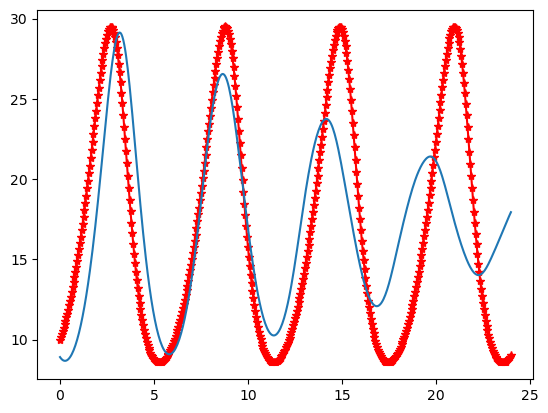

______________________________________________________________________0th iteration_________________________________________________________________
Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [-0.48102141  0.36924198  1.22026118 -0.00817494]
Recovered u_sigma = 6.38274403114691 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 6.38274403114691}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [-0.73810195  0.41978375  1.69872517 -0.03169513]
Recovered u_sigma = 6.086990233228029 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 6.086990233228029}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [-0.75173888  0.43007729  1.79541447 -0.0367971 ]
Recovered u_sigma = 6.09170547002777 


Progress: [##############

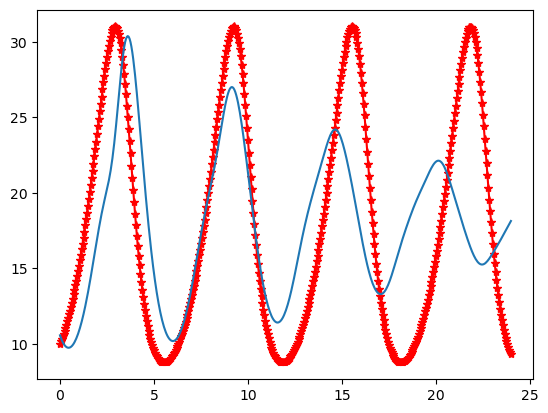

______________________________________________________________________0th iteration_________________________________________________________________
Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [ 0.26987437  1.37388841 -0.07888033 -0.0269082 ]
Recovered u_sigma = 6.754216508081607 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 6.754216508081607}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [ 0.30334054  1.53558581 -0.09393788 -0.03930799]
Recovered u_sigma = 6.584292609656307 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 6.584292609656307}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [-0.08108163  1.53213168 -0.19437728 -0.03342785]
Recovered u_sigma = 6.505353496382124 


Progress: [###########

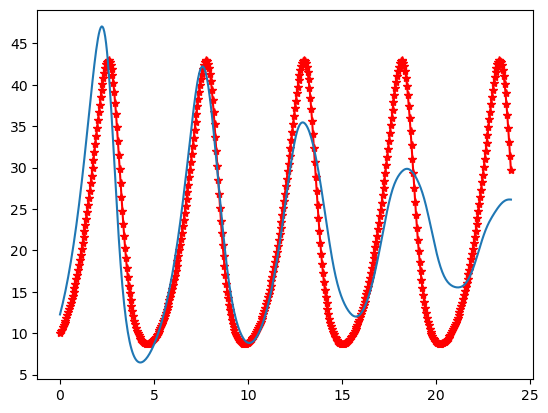

______________________________________________________________________0th iteration_________________________________________________________________
Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [-0.50601613  1.12476208  0.08121285 -0.03075744]
Recovered u_sigma = 3.4390368884909317 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 3.4390368884909317}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [-0.51769393  1.1647331   0.0735967  -0.03352712]
Recovered u_sigma = 3.3727366017530347 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 3.3727366017530347}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [-0.56613125  1.21434864  0.02398459 -0.0352898 ]
Recovered u_sigma = 3.3593154769663762 


Progress: [######

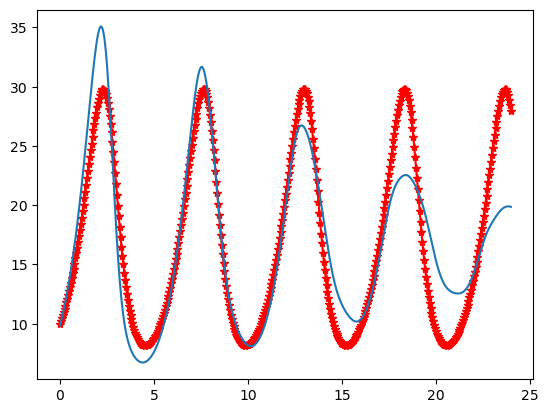

______________________________________________________________________0th iteration_________________________________________________________________
Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [-0.29800081  1.16778536  0.12624343 -0.03861035]
Recovered u_sigma = 3.742576642207926 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 3.742576642207926}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [-0.10771014  1.23828289  0.27734156 -0.05152373]
Recovered u_sigma = 3.6805912259798412 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 3.6805912259798412}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [-0.11106256  1.22432873  0.25532898 -0.04942713]
Recovered u_sigma = 3.664187021492207 


Progress: [#########

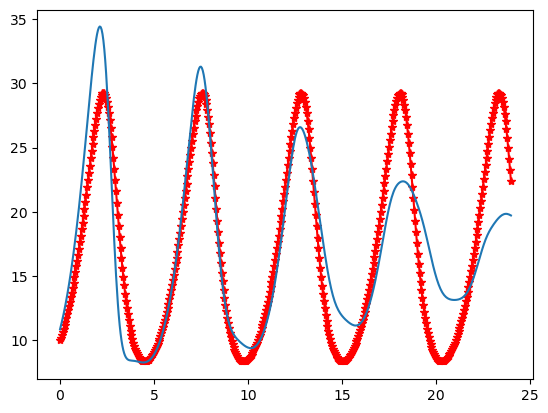

______________________________________________________________________0th iteration_________________________________________________________________
Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [-0.33351671  0.45392055  0.16945698  0.01374747]
Recovered u_sigma = 4.618873071107122 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 4.618873071107122}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [-0.23168074  0.57924472  0.17675698  0.00247212]
Recovered u_sigma = 4.473650164330273 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 4.473650164330273}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [-0.28196939  0.57295477  0.17259223  0.00346583]
Recovered u_sigma = 4.448271577269157 


Progress: [###########

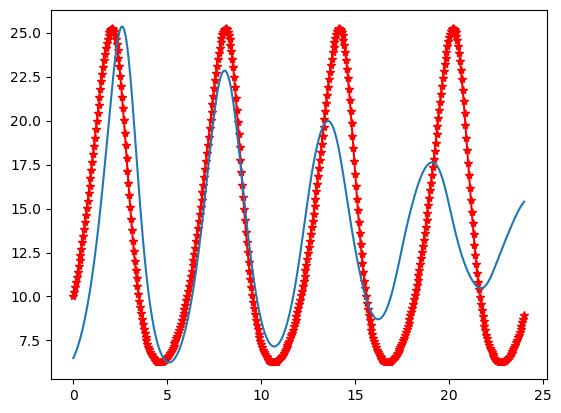

______________________________________________________________________0th iteration_________________________________________________________________
Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [-0.46012324  0.8949568   0.07755489 -0.00758949]
Recovered u_sigma = 7.610278173760399 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 7.610278173760399}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [ 0.1695334   1.5280394  -0.363867   -0.04387458]
Recovered u_sigma = 4.834501511785808 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 4.834501511785808}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [ 0.44291421  1.53645913 -0.19065273 -0.05310177]
Recovered u_sigma = 4.8130196605925 


Progress: [#############

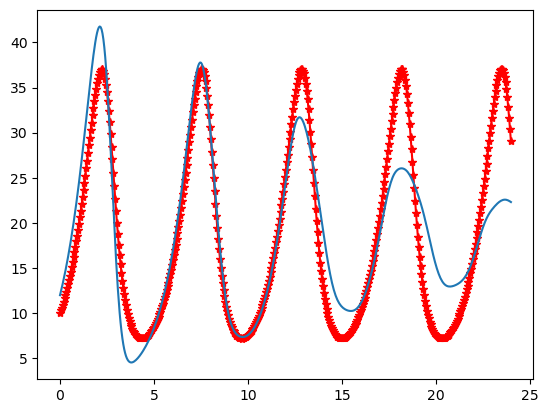

______________________________________________________________________0th iteration_________________________________________________________________
Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [ 1.5724177   1.74846059  0.93717316 -0.09459582]
Recovered u_sigma = 10.932796957380594 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 10.932796957380594}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [ 1.94885195  1.72890106 -0.56674684 -0.02985777]
Recovered u_sigma = 8.889353403227227 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 8.889353403227227}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [ 1.96865339  1.83479792 -0.55345808 -0.03914868]
Recovered u_sigma = 8.870954285185668 


Progress: [#########

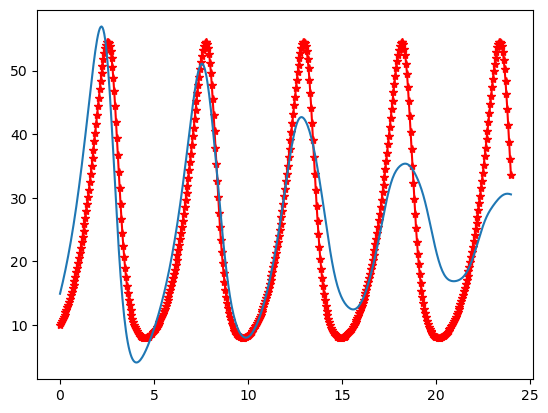

______________________________________________________________________0th iteration_________________________________________________________________
Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [0.19738212 0.43278476 0.798304   0.00699013]
Recovered u_sigma = 5.934581403998831 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 5.934581403998831}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [0.14370994 0.40046818 0.86669201 0.00667252]
Recovered u_sigma = 5.907395161529158 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 5.907395161529158}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [-0.05314015  0.40030826  0.93164123  0.00475306]
Recovered u_sigma = 5.874651091514233 


Progress: [###################

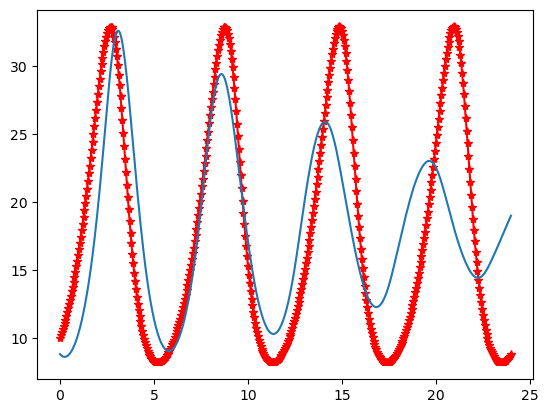

______________________________________________________________________0th iteration_________________________________________________________________
Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [ 0.45560654  1.65287319 -0.03508583 -0.06539588]
Recovered u_sigma = 12.328662542961213 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 12.328662542961213}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [-1.15273657  1.96608039  0.94311451 -0.12726274]
Recovered u_sigma = 11.424197153495715 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 11.424197153495715}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [-1.24684868  1.99328426  0.98992423 -0.13157902]
Recovered u_sigma = 11.493832132319444 


Progress: [######

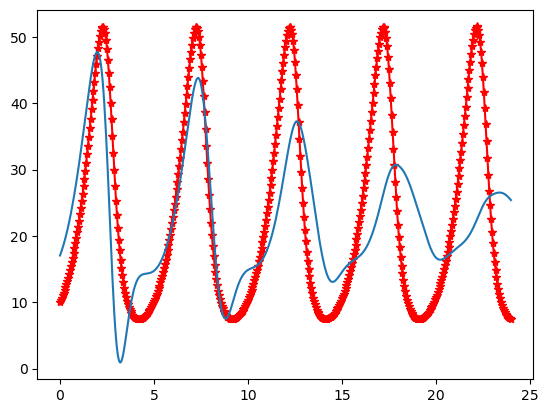

______________________________________________________________________0th iteration_________________________________________________________________
Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [-0.58712428  0.91983267 -1.11597815  0.08074787]
Recovered u_sigma = 6.889643657383216 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 6.889643657383216}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [-0.68232619  1.14900708 -1.27200013  0.06847081]
Recovered u_sigma = 6.064910956865191 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 6.064910956865191}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [-0.71689505  1.27335638 -1.40170277  0.06407468]
Recovered u_sigma = 5.964463415956676 


Progress: [###########

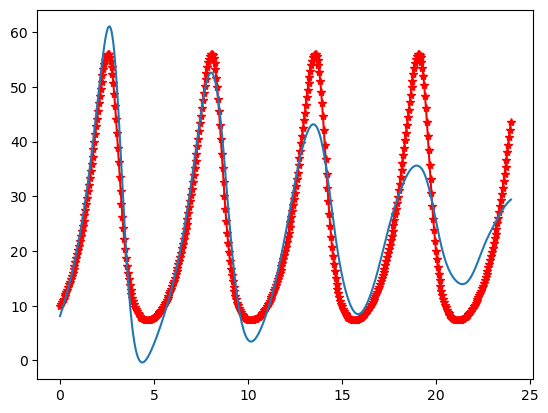

______________________________________________________________________0th iteration_________________________________________________________________
Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [ 0.12792307  0.90555    -0.47005389  0.01443307]
Recovered u_sigma = 2.724117551120573 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 2.724117551120573}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [ 0.10624025  0.91110898 -0.31290006  0.00724039]
Recovered u_sigma = 2.557912365159295 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 2.557912365159295}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [ 0.07410974  0.86506638 -0.29597717  0.01054462]
Recovered u_sigma = 2.501752508569213 


Progress: [###########

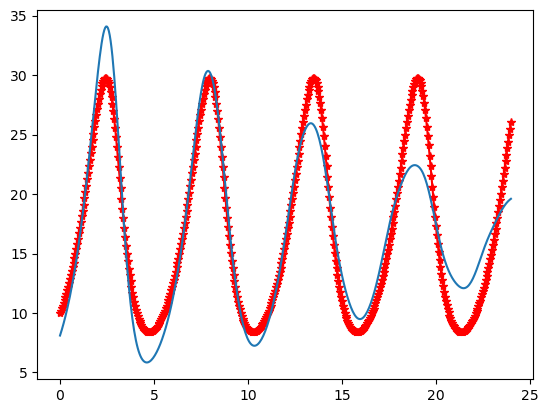

______________________________________________________________________0th iteration_________________________________________________________________
Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [-0.32924645  0.84623483  0.00880047  0.02214187]
Recovered u_sigma = 5.999100955654649 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 5.999100955654649}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [-0.74044711  1.03283253 -0.39887177  0.02696101]
Recovered u_sigma = 4.855502865903307 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 4.855502865903307}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [-0.73839025  1.13784651 -0.498593    0.02188605]
Recovered u_sigma = 4.61942983344379 


Progress: [############

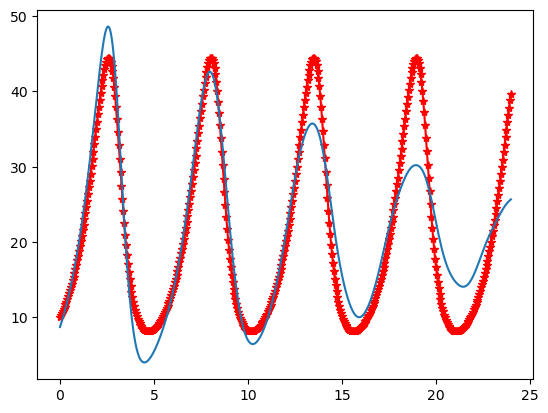

______________________________________________________________________0th iteration_________________________________________________________________
Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [0.09055375 0.43048168 0.2650638  0.03635315]
Recovered u_sigma = 4.176263580386646 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 4.176263580386646}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [0.18947121 0.43026538 0.26830973 0.03594299]
Recovered u_sigma = 4.178550509988103 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 4.178550509988103}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [0.31050084 0.43205554 0.34879923 0.03180486]
Recovered u_sigma = 4.163880671729658 


Progress: [#######################

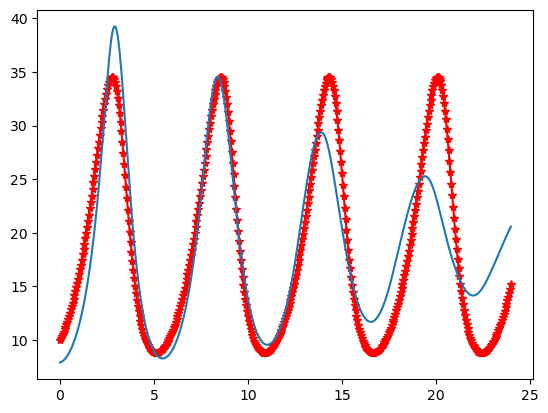

______________________________________________________________________0th iteration_________________________________________________________________
Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [ 0.89049733  1.22175467 -0.07833837 -0.04324581]
Recovered u_sigma = 3.4739689863004237 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 3.4739689863004237}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [ 0.88673709  1.2774904  -0.04814992 -0.04872312]
Recovered u_sigma = 3.454784951894752 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 3.454784951894752}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [ 0.91415841  1.26922263 -0.037491   -0.04862526]
Recovered u_sigma = 3.4516969502270456 


Progress: [########

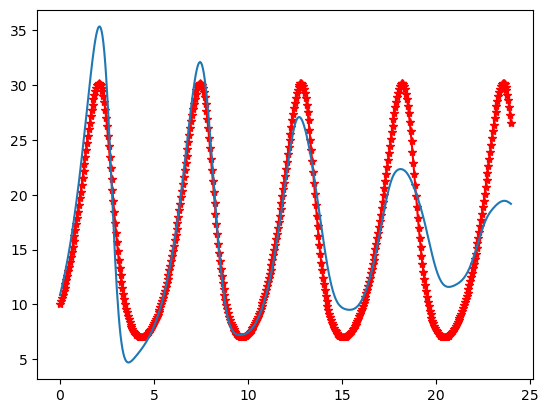

______________________________________________________________________0th iteration_________________________________________________________________
Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [ 1.26699399  0.37934758  1.56071229 -0.02497102]
Recovered u_sigma = 8.579274251148227 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 8.579274251148227}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [ 1.35181871  0.43754323  1.68209515 -0.03557818]
Recovered u_sigma = 8.477916092039838 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 8.477916092039838}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [ 1.28434918  0.46214677  1.89094286 -0.04645471]
Recovered u_sigma = 8.426988016216935 


Progress: [###########

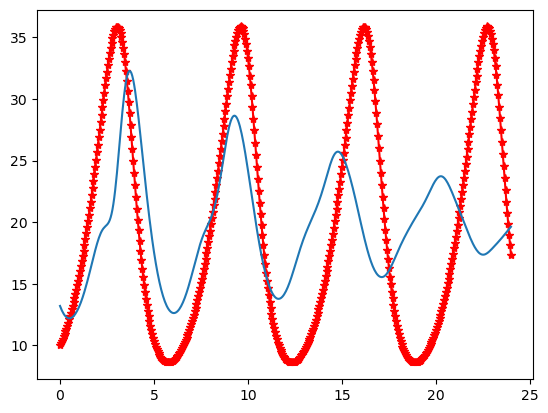

______________________________________________________________________0th iteration_________________________________________________________________
Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [-0.33838799  0.61151904 -0.2456135   0.05160263]
Recovered u_sigma = 5.5689632635204465 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 5.5689632635204465}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [-0.26436643  0.62152446 -0.28116761  0.05208376]
Recovered u_sigma = 5.554192003787038 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 5.554192003787038}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [-0.28146918  0.63376967 -0.2428039   0.04943124]
Recovered u_sigma = 5.580358996067542 


Progress: [#########

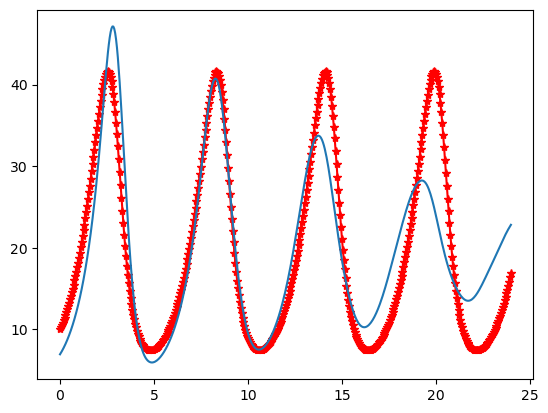

______________________________________________________________________0th iteration_________________________________________________________________
Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [ 0.2293312   0.61867713 -0.85730941  0.09603481]
Recovered u_sigma = 6.139999913780014 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 6.139999913780014}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [ 0.13025559  0.73482525 -0.98277682  0.09214794]
Recovered u_sigma = 6.042762889330464 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 6.042762889330464}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [ 0.18329255  0.7096938  -0.93394685  0.09165831]
Recovered u_sigma = 6.031907076600334 


Progress: [###########

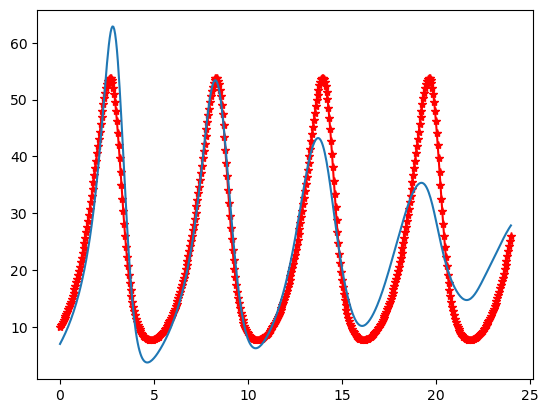

______________________________________________________________________0th iteration_________________________________________________________________
Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [ 0.29788651  1.28541831  0.15816571 -0.03984622]
Recovered u_sigma = 5.321086348589321 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 5.321086348589321}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [ 0.16214369  1.31184922 -0.01126151 -0.03403071]
Recovered u_sigma = 5.027556559589287 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 5.027556559589287}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [-0.11574879  1.44100346 -0.42957448 -0.02592163]
Recovered u_sigma = 4.466992669731552 


Progress: [###########

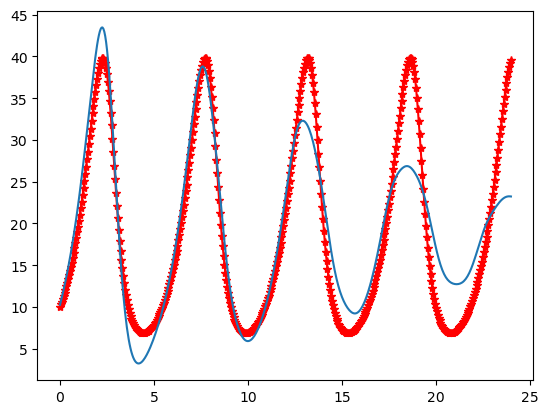

______________________________________________________________________0th iteration_________________________________________________________________
Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [ 0.09420719  1.25098165 -0.21693916  0.00420015]
Recovered u_sigma = 8.970085159513998 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 8.970085159513998}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [ 0.39159884  1.67863639 -0.6915711  -0.01136248]
Recovered u_sigma = 7.655193399754557 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 7.655193399754557}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [ 1.19978668  1.62081438 -1.22162677  0.01312825]
Recovered u_sigma = 7.423310813533096 


Progress: [###########

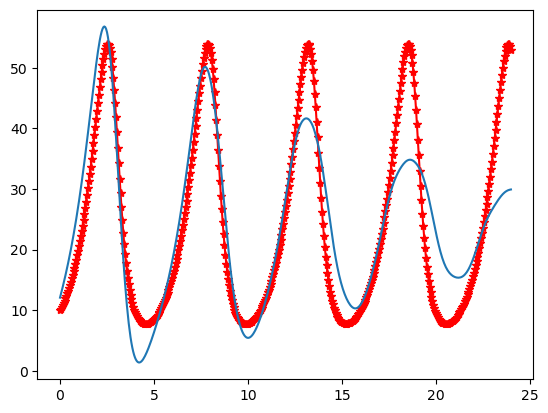

______________________________________________________________________0th iteration_________________________________________________________________
Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [ 1.93393309  1.29326098  0.17316643 -0.06487765]
Recovered u_sigma = 3.629721104958162 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 3.629721104958162}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [ 1.866104    1.25411784  0.18272346 -0.06175007]
Recovered u_sigma = 3.6062802847558766 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 3.6062802847558766}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [ 1.87605632  1.2416737   0.0888754  -0.0567853 ]
Recovered u_sigma = 3.517047960908976 


Progress: [#########

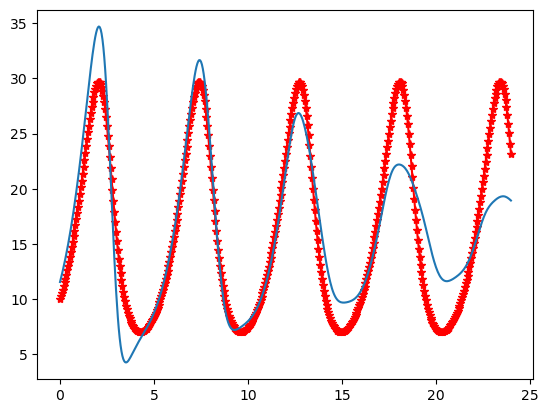

______________________________________________________________________0th iteration_________________________________________________________________
Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [-0.0801419   0.72221842  1.08144675 -0.0441893 ]
Recovered u_sigma = 5.496884441505523 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 5.496884441505523}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [-1.41902979  0.85939912  0.26427389 -0.01626624]
Recovered u_sigma = 3.282002497928571 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 3.282002497928571}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [-1.4843899   0.84694045  0.23798467 -0.01366334]
Recovered u_sigma = 3.235915027409216 


Progress: [###########

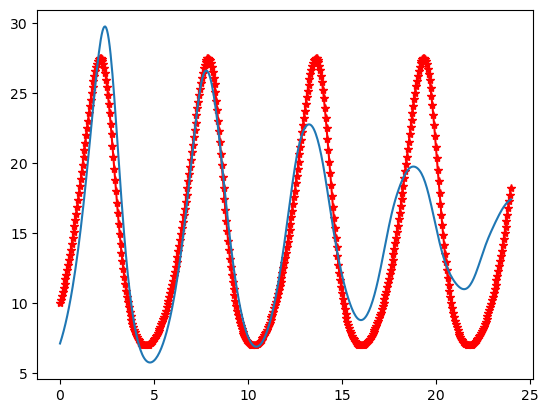

______________________________________________________________________0th iteration_________________________________________________________________
Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [ 0.08058692  0.64627914 -0.33614968  0.04161385]
Recovered u_sigma = 3.130497988936335 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 3.130497988936335}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [ 0.10957695  0.74242758 -0.29102442  0.03185097]
Recovered u_sigma = 2.9508229974279283 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 2.9508229974279283}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [ 0.1468179   0.74369173 -0.24191509  0.02922566]
Recovered u_sigma = 2.9541515613761096 


Progress: [########

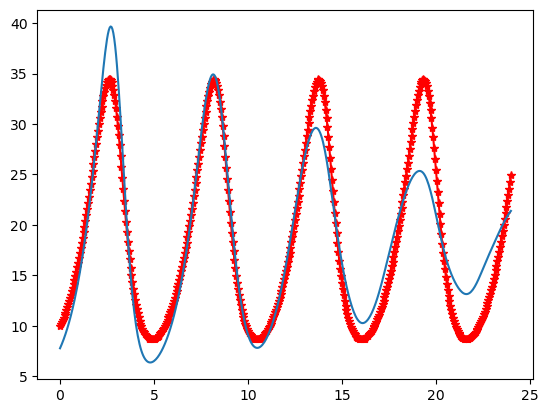

______________________________________________________________________0th iteration_________________________________________________________________
Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [-0.02292347  0.66402324 -0.12183554  0.04160793]
Recovered u_sigma = 4.954699182628936 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 4.954699182628936}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [ 0.13652687  0.73159774 -0.66989923  0.05882399]
Recovered u_sigma = 4.535654211957986 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 4.535654211957986}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [ 0.07465386  0.7413655  -0.68184034  0.05874897]
Recovered u_sigma = 4.570346749581213 


Progress: [###########

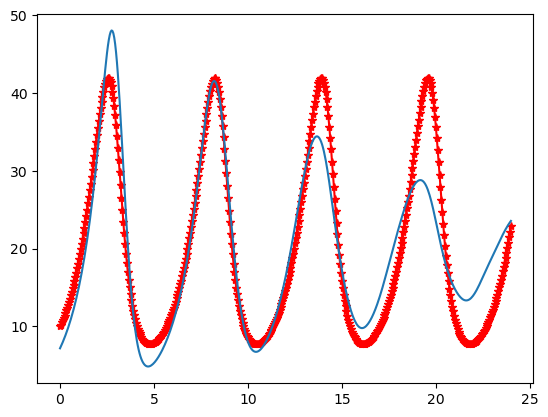

______________________________________________________________________0th iteration_________________________________________________________________
Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [-1.91784639  1.32726548 -1.1500721   0.0404885 ]
Recovered u_sigma = 4.967108392456169 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 4.967108392456169}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [-1.84525298  1.31253299 -1.0416504   0.03676688]
Recovered u_sigma = 4.9292409779870345 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 4.9292409779870345}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [-1.84695846  1.29816955 -1.09151615  0.04033358]
Recovered u_sigma = 4.940768224231537 


Progress: [#########

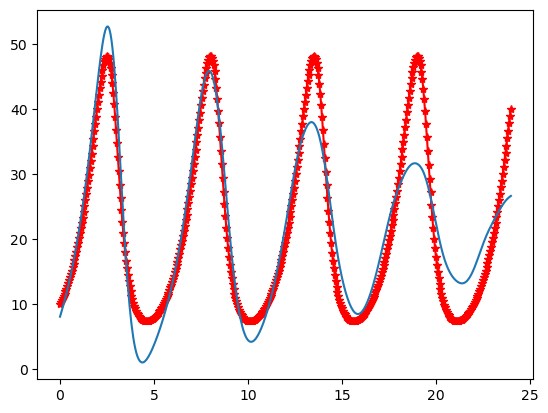

______________________________________________________________________0th iteration_________________________________________________________________
Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [ 0.20543241  0.83925169 -0.03381324  0.00663938]
Recovered u_sigma = 2.8121591285524676 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 2.8121591285524676}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [ 0.16042755  0.79369987 -0.20155365  0.01770181]
Recovered u_sigma = 2.7243335469008 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 2.7243335469008}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [ 0.183109    0.80570585 -0.23713631  0.01834514]
Recovered u_sigma = 2.6962280881343457 


Progress: [############

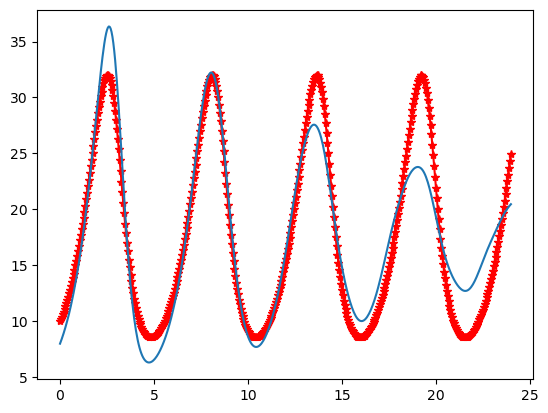

______________________________________________________________________0th iteration_________________________________________________________________
Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [ 0.1176679   0.73425836 -1.1151933   0.06774422]
Recovered u_sigma = 5.2213494548359005 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 5.2213494548359005}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [ 0.12424623  0.72777547 -1.05498826  0.06561197]
Recovered u_sigma = 5.202580265144323 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 5.202580265144323}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [ 0.10435033  0.74510181 -0.82495244  0.05441823]
Recovered u_sigma = 4.9736697151532425 


Progress: [########

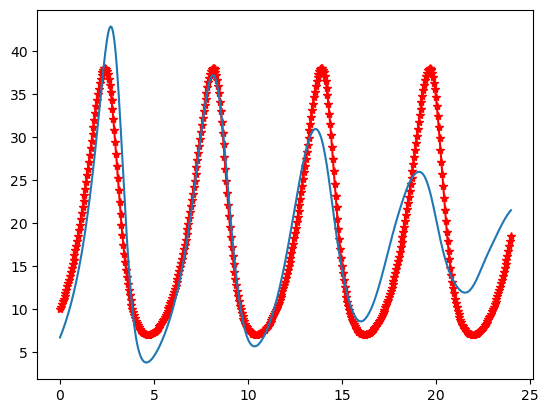

______________________________________________________________________0th iteration_________________________________________________________________
Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [ 0.25739575  1.92540738 -0.81786379 -0.04036349]
Recovered u_sigma = 15.114480338243686 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 15.114480338243686}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [ 0.11801874  1.99007562 -0.60464874 -0.05545086]
Recovered u_sigma = 14.828033323703746 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 14.828033323703746}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [ 0.1986335   1.99674055 -0.53013606 -0.05832296]
Recovered u_sigma = 14.563439554077622 


Progress: [######

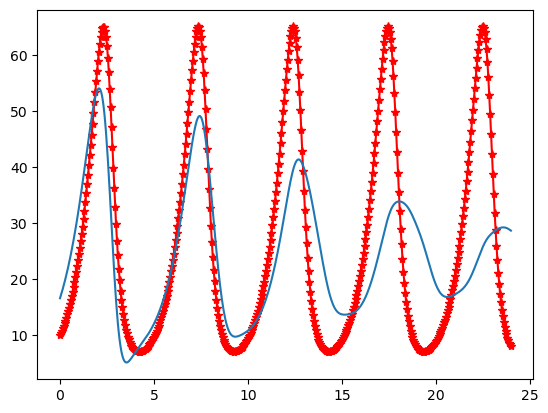

______________________________________________________________________0th iteration_________________________________________________________________
Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [0.11259933 0.53746582 0.23841009 0.01045399]
Recovered u_sigma = 5.037199198394079 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 5.037199198394079}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [-0.0255599   0.56736771  0.11302953  0.01411625]
Recovered u_sigma = 4.957193273742882 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 4.957193273742882}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [-0.04929462  0.59226065  0.13855525  0.01139518]
Recovered u_sigma = 4.942805548360688 


Progress: [###############

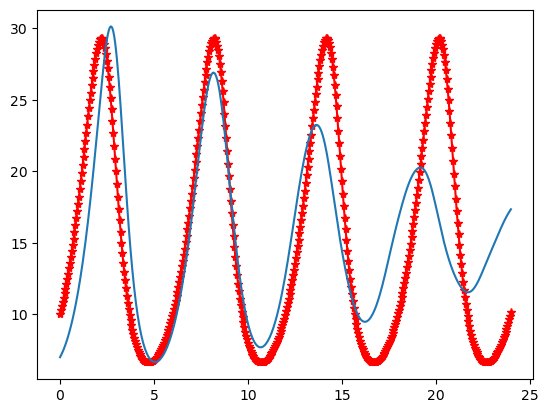

______________________________________________________________________0th iteration_________________________________________________________________
Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [0.40075502 0.09274566 1.25804713 0.04556901]
Recovered u_sigma = 8.719985204871625 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 8.719985204871625}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [-0.0301386   0.19428814  1.8145122   0.01481602]
Recovered u_sigma = 8.45213837442919 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 8.45213837442919}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [-0.00648733  0.16170411  1.86897047  0.01471831]
Recovered u_sigma = 8.538308607906835 


Progress: [#################

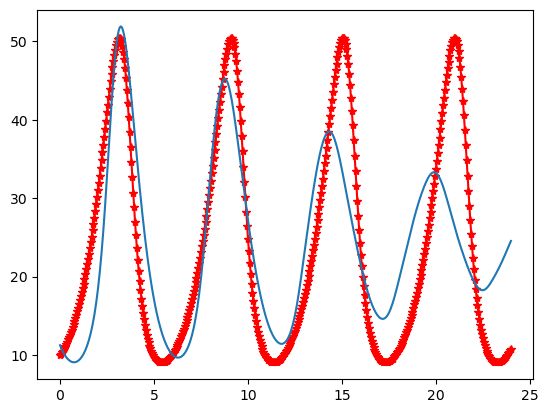

______________________________________________________________________0th iteration_________________________________________________________________
Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [-0.63980762  0.73811517  0.13481178  0.01823422]
Recovered u_sigma = 3.3494228669053325 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 3.3494228669053325}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [-0.59220725  0.71166603  0.07762254  0.02250755]
Recovered u_sigma = 3.2955768481331402 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 3.2955768481331402}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [-0.61694856  0.75188814  0.02738847  0.02146184]
Recovered u_sigma = 3.3006323302135034 


Progress: [######

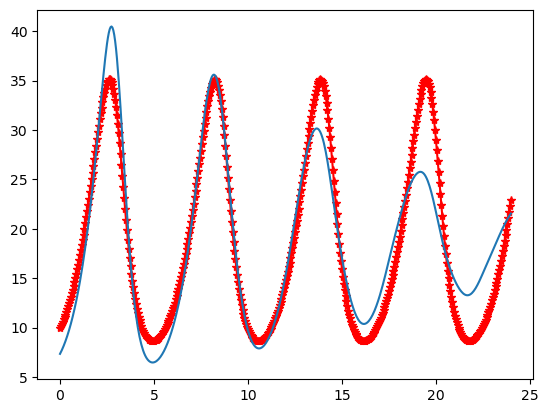

______________________________________________________________________0th iteration_________________________________________________________________
Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [0.31647061 0.58376212 0.06917481 0.02860358]
Recovered u_sigma = 4.9901252132451575 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 4.9901252132451575}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [0.38131709 0.47645732 0.1516232  0.0338017 ]
Recovered u_sigma = 4.863119177426865 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 4.863119177426865}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [0.42355116 0.45067409 0.13650202 0.03622446]
Recovered u_sigma = 4.8454553735381465 


Progress: [####################

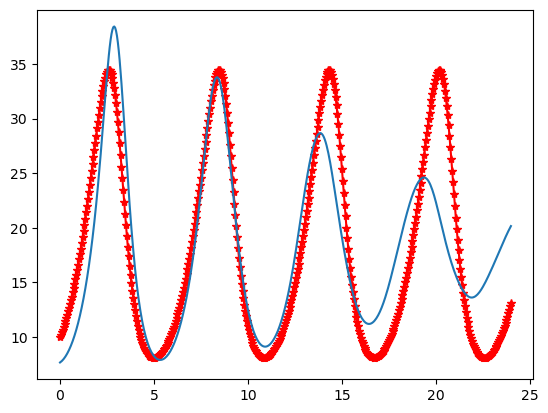

______________________________________________________________________0th iteration_________________________________________________________________
Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [ 0.07977918  0.66015699 -0.30988642  0.06667515]
Recovered u_sigma = 4.901487725609929 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 4.901487725609929}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [ 0.07948612  0.67862736 -0.40501037  0.06946178]
Recovered u_sigma = 4.845416222792621 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 4.845416222792621}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [ 0.12680858  0.66357928 -0.46130352  0.07277367]
Recovered u_sigma = 4.766825343881609 


Progress: [###########

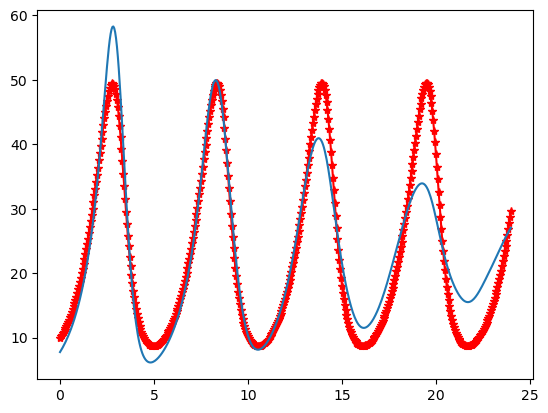

______________________________________________________________________0th iteration_________________________________________________________________
Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [-0.28633558  1.61663474  0.42001484 -0.08226993]
Recovered u_sigma = 7.7559959590589775 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 7.7559959590589775}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [-0.17555306  1.93694327  0.44285475 -0.1102781 ]
Recovered u_sigma = 7.241900333904249 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 7.241900333904249}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [-0.13835914  1.92563456  0.37723071 -0.10702706]
Recovered u_sigma = 7.188918087814513 


Progress: [#########

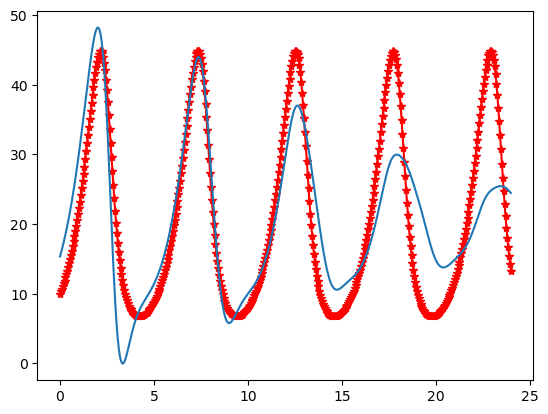

______________________________________________________________________0th iteration_________________________________________________________________
Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [-0.3977208   0.84133303  0.06729236 -0.01267791]
Recovered u_sigma = 2.7454271601270444 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 2.7454271601270444}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [-0.36200202  0.86187179 -0.01932283 -0.01055154]
Recovered u_sigma = 2.703805461139547 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 2.703805461139547}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [-0.32743288  0.85873371 -0.04097014 -0.00932223]
Recovered u_sigma = 2.706710719616769 


Progress: [#########

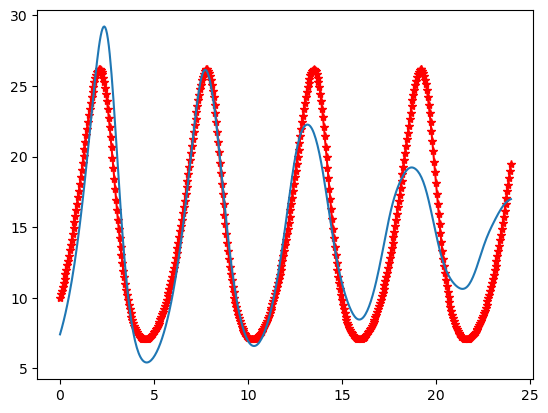

______________________________________________________________________0th iteration_________________________________________________________________
Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [0.30435837 0.64385243 0.2496804  0.04110712]
Recovered u_sigma = 6.581487254088051 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 6.581487254088051}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [ 0.33000103  0.63668997 -0.02704239  0.05320443]
Recovered u_sigma = 6.058420584862776 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 6.058420584862776}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [ 0.36282206  0.68207354 -0.17383115  0.05593982]
Recovered u_sigma = 5.725524489427854 


Progress: [###############

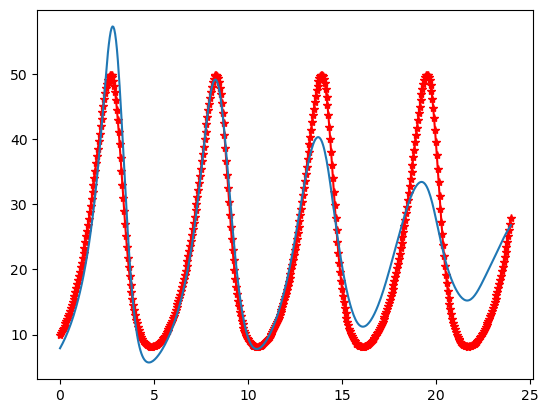

______________________________________________________________________0th iteration_________________________________________________________________
Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [ 0.47764453  0.99298936  0.91545701 -0.05036114]
Recovered u_sigma = 7.713856033597413 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 7.713856033597413}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [ 0.66181252  1.46574734  0.65300049 -0.07963456]
Recovered u_sigma = 5.928784497561622 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 5.928784497561622}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [ 0.69945371  1.45241473  0.26105516 -0.06159897]
Recovered u_sigma = 5.484827767486941 


Progress: [###########

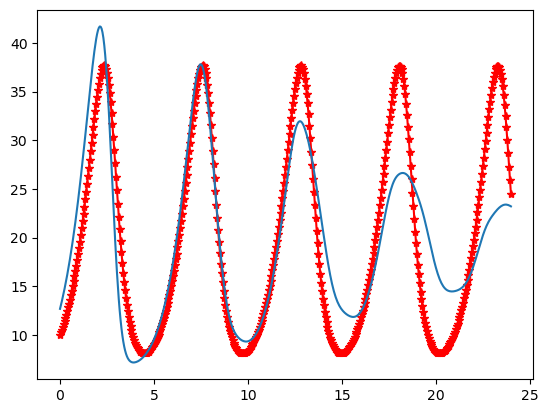

______________________________________________________________________0th iteration_________________________________________________________________
Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [-0.09467297  0.53570631  0.53859164  0.00368774]
Recovered u_sigma = 9.222007678815517 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 9.222007678815517}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [ 0.48638593  0.54346323  1.15920413 -0.02525607]
Recovered u_sigma = 8.428235518828682 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 8.428235518828682}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [ 0.67955461  0.50700316  1.27602554 -0.0279166 ]
Recovered u_sigma = 8.343956569527034 


Progress: [###########

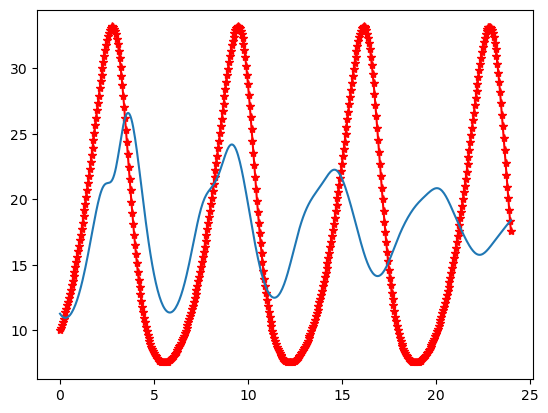

______________________________________________________________________0th iteration_________________________________________________________________
Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [-0.82794278  1.34152756  0.49355038 -0.05431064]
Recovered u_sigma = 6.167708182062503 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 6.167708182062503}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [-0.71550015  1.43359509  0.27269201 -0.05212053]
Recovered u_sigma = 5.6030222041184015 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 5.6030222041184015}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [-0.76704084  1.29585815 -0.15171341 -0.02257764]
Recovered u_sigma = 4.881764793318434 


Progress: [#########

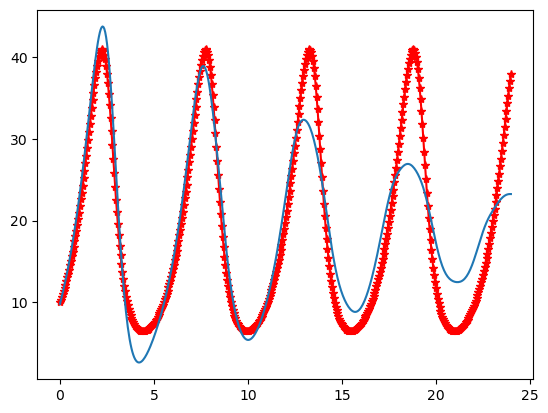

______________________________________________________________________0th iteration_________________________________________________________________
Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [ 1.42152879  1.02374527 -0.62352107  0.0570975 ]
Recovered u_sigma = 7.269445288461506 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 7.269445288461506}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [ 1.62844221  0.97330202 -0.7205218   0.06469146]
Recovered u_sigma = 7.169261856777296 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 7.169261856777296}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [ 1.68950548  1.02877651 -0.87408275  0.0663883 ]
Recovered u_sigma = 6.931600644647931 


Progress: [###########

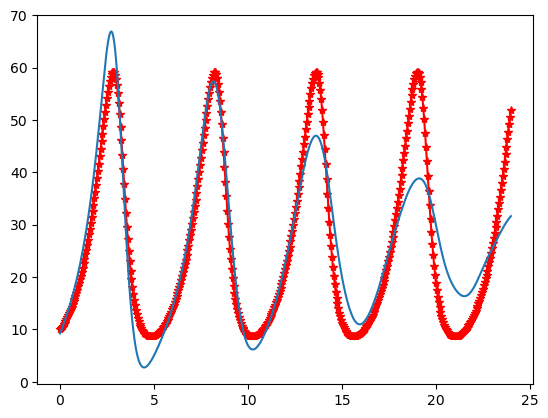

______________________________________________________________________0th iteration_________________________________________________________________
Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [ 1.03509822  1.75617473  1.32398019 -0.13917838]
Recovered u_sigma = 7.766628111087418 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 7.766628111087418}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [ 0.61187729  1.56035323  0.38795976 -0.08058285]
Recovered u_sigma = 5.406370716911779 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 5.406370716911779}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [ 0.63235994  1.54508557  0.01103678 -0.06348909]
Recovered u_sigma = 5.04927186005398 


Progress: [############

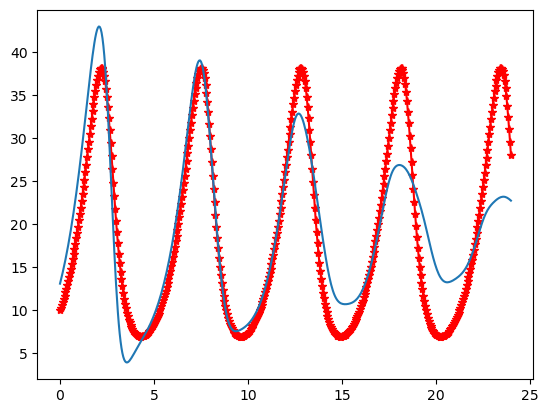

______________________________________________________________________0th iteration_________________________________________________________________
Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [ 1.65221258  0.5359146  -0.40433877  0.05005923]
Recovered u_sigma = 5.338602181845224 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 5.338602181845224}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [ 1.64250211  0.50838566 -0.25858344  0.04629664]
Recovered u_sigma = 5.349987868394908 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 5.349987868394908}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [ 1.60207831  0.51102611 -0.28628142  0.04726846]
Recovered u_sigma = 5.33158615983005 


Progress: [############

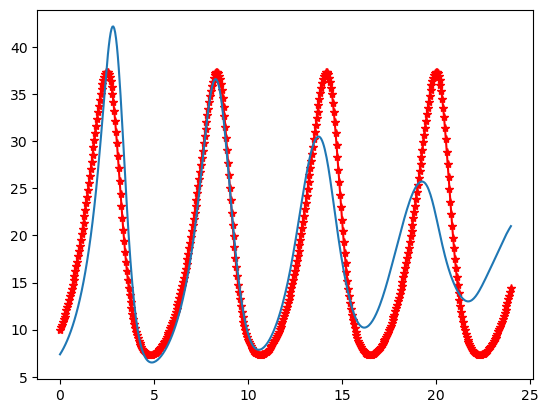

______________________________________________________________________0th iteration_________________________________________________________________
Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [0.51844745 0.34357982 0.22512634 0.03330634]
Recovered u_sigma = 6.6319718638710015 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 6.6319718638710015}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [0.3841431  0.33154872 0.35678694 0.02900566]
Recovered u_sigma = 6.523693522451354 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 6.523693522451354}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [ 0.22964103  0.34030778  1.2618299  -0.00970327]
Recovered u_sigma = 5.528322500416636 


Progress: [#################

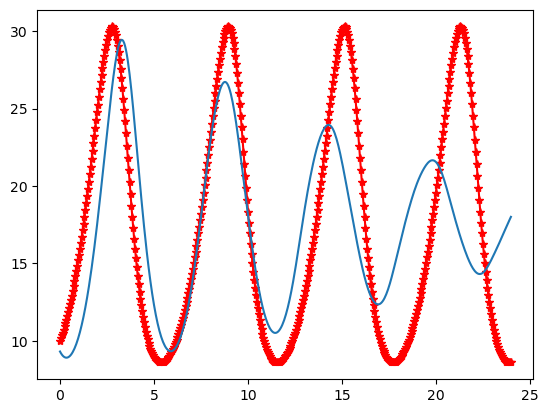

______________________________________________________________________0th iteration_________________________________________________________________
Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [ 0.7104156   1.65782446  1.00620238 -0.10987961]
Recovered u_sigma = 10.084461127661875 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 10.084461127661875}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [ 0.71606477  1.79889834  0.8845515  -0.11631342]
Recovered u_sigma = 9.795853341550831 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 9.795853341550831}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [ 1.2255964   1.91780112  0.4354239  -0.10848738]
Recovered u_sigma = 9.627923068989023 


Progress: [#########

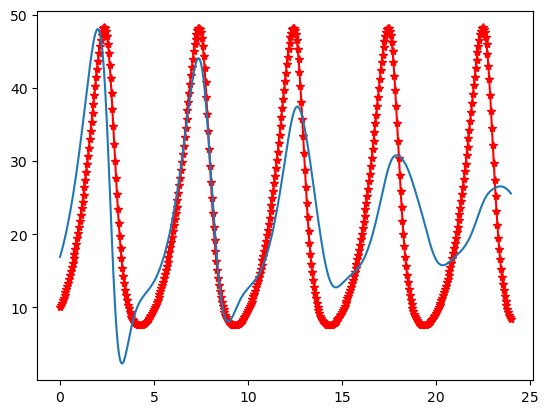

______________________________________________________________________0th iteration_________________________________________________________________
Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [0.07658672 0.32221484 0.72440761 0.01739691]
Recovered u_sigma = 7.360205667621696 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 7.360205667621696}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [-0.01674244  0.4210869   0.86604268  0.0036129 ]
Recovered u_sigma = 7.235598438071951 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 7.235598438071951}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [-0.00965584  0.39502928  0.94855337  0.00238951]
Recovered u_sigma = 7.201592183452319 


Progress: [###############

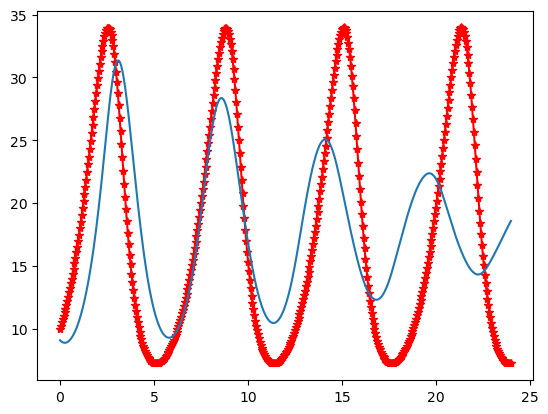

______________________________________________________________________0th iteration_________________________________________________________________
Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [-1.16590381  1.15985803  0.02958563 -0.02511209]
Recovered u_sigma = 4.05099275673796 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 4.05099275673796}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [-1.32371937  1.18132838 -0.29241787 -0.01254477]
Recovered u_sigma = 3.687475881951788 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 3.687475881951788}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [-1.3581574   1.14061047 -0.37803345 -0.00539288]
Recovered u_sigma = 3.609329556827944 


Progress: [#############

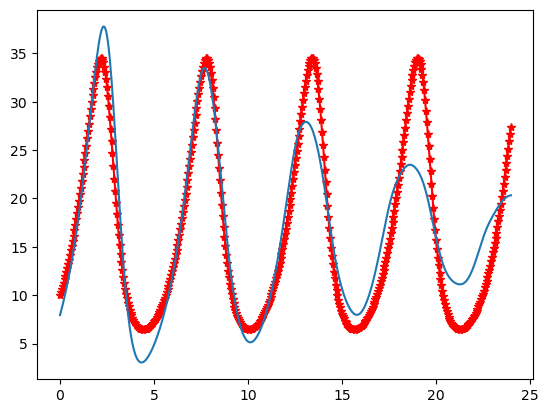

______________________________________________________________________0th iteration_________________________________________________________________
Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [-1.94785003e-01  1.05712702e+00  1.06201329e-01 -8.59411543e-05]
Recovered u_sigma = 5.831214822802658 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 5.831214822802658}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [-0.19638319  0.89831311 -0.11356695  0.02213077]
Recovered u_sigma = 4.994869749700527 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 4.994869749700527}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [-0.14581268  0.77919197 -0.25373858  0.03806607]
Recovered u_sigma = 4.8204756257497685 


Progr

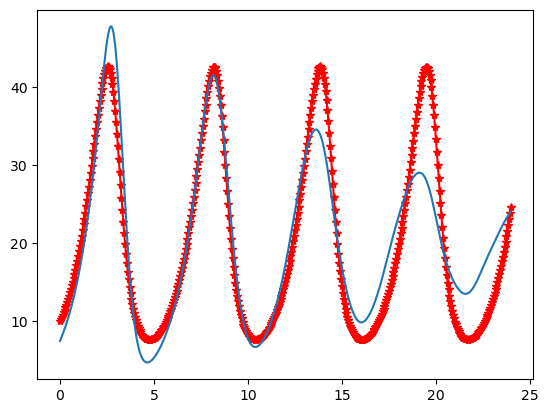

______________________________________________________________________0th iteration_________________________________________________________________
Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [-0.06587694  0.45773288  0.24480492  0.03675031]
Recovered u_sigma = 5.137186778989893 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 5.137186778989893}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [0.07319875 0.44191022 0.39133917 0.03136956]
Recovered u_sigma = 5.049627504190725 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 5.049627504190725}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [0.04485124 0.42448812 0.42946185 0.03139138]
Recovered u_sigma = 5.082069945820958 


Progress: [###################

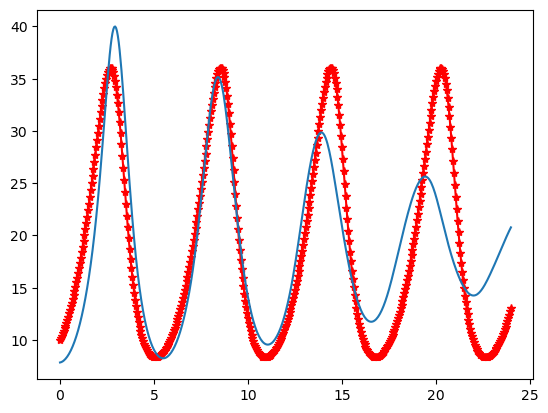

______________________________________________________________________0th iteration_________________________________________________________________
Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [ 0.08111484  1.3287444   0.12583926 -0.0311936 ]
Recovered u_sigma = 8.158065898079155 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 8.158065898079155}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [-0.14778312  1.66810029  0.03059795 -0.05501946]
Recovered u_sigma = 7.5599699223498655 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 7.5599699223498655}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [-0.31583325  1.65242165  0.03501898 -0.05335998]
Recovered u_sigma = 7.473947890346294 


Progress: [#########

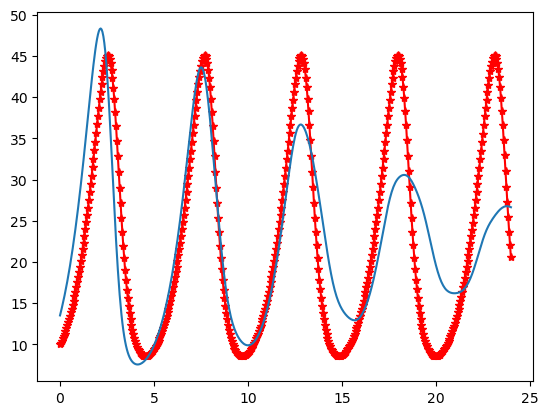

______________________________________________________________________0th iteration_________________________________________________________________
Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [-0.76604807  1.10522662 -0.95910903  0.06787154]
Recovered u_sigma = 5.672531411993605 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 5.672531411993605}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [-1.01112509  0.96196926 -1.08570751  0.08641892]
Recovered u_sigma = 5.573967819234229 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 5.573967819234229}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [-1.01254287  1.00682619 -0.97722272  0.07776819]
Recovered u_sigma = 5.519443525624625 


Progress: [###########

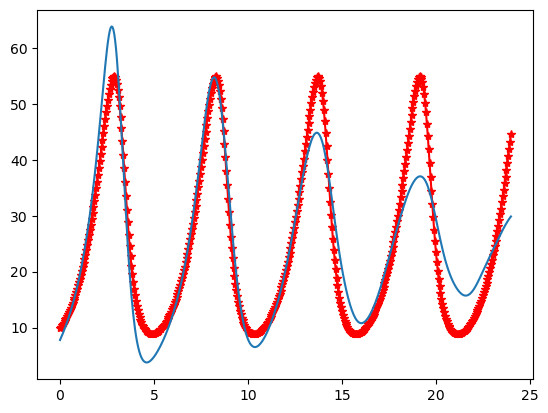

______________________________________________________________________0th iteration_________________________________________________________________
Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [ 0.41843925  1.2270179  -0.38927373 -0.02267791]
Recovered u_sigma = 5.560212425394292 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 5.560212425394292}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [ 0.81116454  1.51009536 -0.26623343 -0.05327707]
Recovered u_sigma = 4.668979683271647 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 4.668979683271647}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [ 0.27463099  1.51379318 -0.05208297 -0.06084238]
Recovered u_sigma = 4.6192608277461025 


Progress: [##########

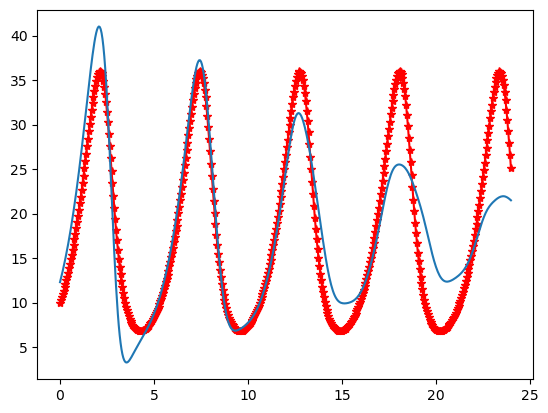

______________________________________________________________________0th iteration_________________________________________________________________
Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [ 0.30756428  1.52670459 -0.65718933 -0.03627596]
Recovered u_sigma = 8.869001571643942 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 8.869001571643942}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [ 0.6672158   1.99164635  0.31326534 -0.11798469]
Recovered u_sigma = 7.103973497863585 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 7.103973497863585}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [ 0.69117169  1.95746249  0.24305898 -0.1124798 ]
Recovered u_sigma = 7.104364278253558 


Progress: [###########

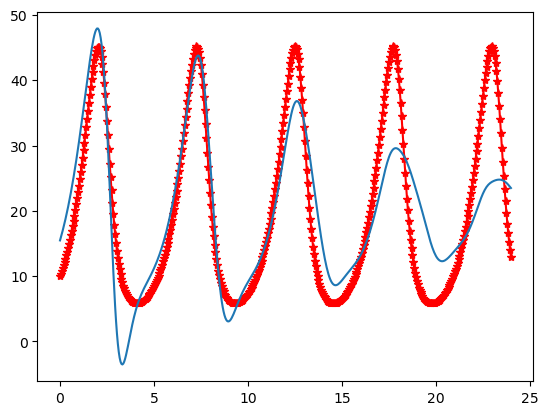

______________________________________________________________________0th iteration_________________________________________________________________
Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [ 0.80611946  1.65749818  1.09384788 -0.12532564]
Recovered u_sigma = 8.660102856365429 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 8.660102856365429}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [ 0.80576878  1.6573475   0.99557794 -0.12127227]
Recovered u_sigma = 8.50682641421384 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 8.50682641421384}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [ 1.03746605  1.65622675  0.96047293 -0.12026953]
Recovered u_sigma = 8.554967448986122 


Progress: [#############

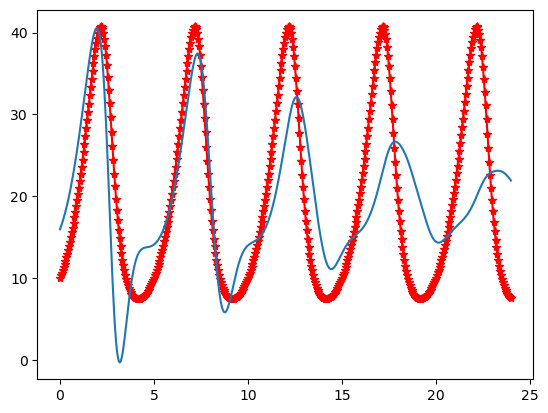

______________________________________________________________________0th iteration_________________________________________________________________
Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [-0.21225397  0.32705206  1.05562813  0.01637206]
Recovered u_sigma = 5.162314808685158 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 5.162314808685158}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [-0.15689555  0.30671662  0.93416265  0.02306018]
Recovered u_sigma = 5.086993047220126 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 5.086993047220126}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [-0.14591071  0.34850805  0.90447675  0.02069659]
Recovered u_sigma = 5.123646906945859 


Progress: [###########

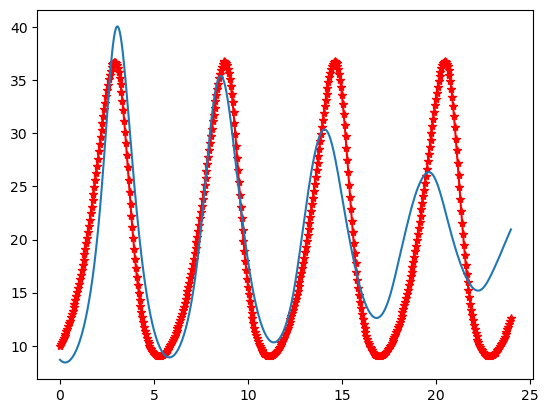

______________________________________________________________________0th iteration_________________________________________________________________
Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [-4.26746042e-01  9.35504853e-01  1.98452656e-01  2.60947789e-05]
Recovered u_sigma = 4.516226925159266 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 4.516226925159266}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [-0.43171844  1.00517375 -0.14832339  0.00913372]
Recovered u_sigma = 3.8419868249071407 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 3.8419868249071407}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [-0.531274    1.06952878 -0.23551823  0.00778428]
Recovered u_sigma = 3.734735839209009 


Prog

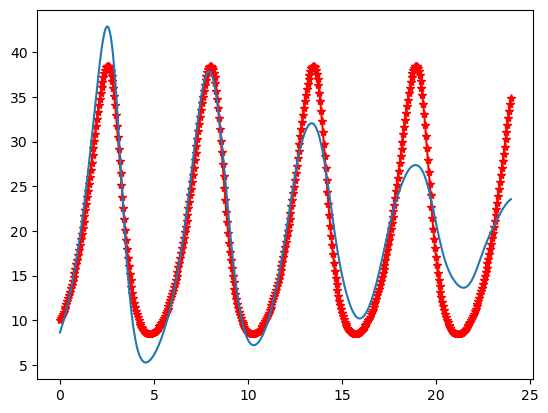

______________________________________________________________________0th iteration_________________________________________________________________
Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [-0.73431836  0.31318995  1.03693374  0.03713885]
Recovered u_sigma = 10.367893639609417 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 10.367893639609417}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [-1.10012279  0.2723254   1.67769453  0.01498418]
Recovered u_sigma = 9.664160830063722 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 9.664160830063722}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [-1.07559161  0.22069499  1.81091673  0.01324345]
Recovered u_sigma = 9.574556185488971 


Progress: [#########

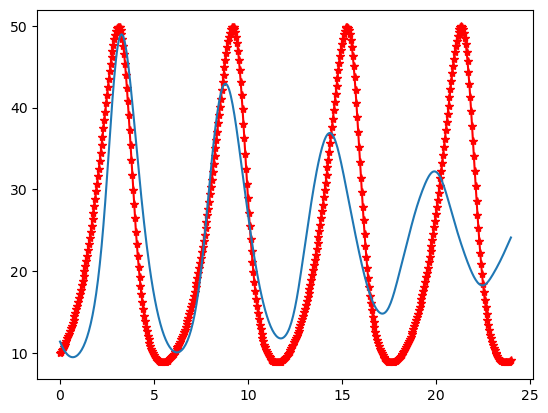

______________________________________________________________________0th iteration_________________________________________________________________
Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [ 0.52847405  1.40432972  0.78775796 -0.07719461]
Recovered u_sigma = 6.128549280670834 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 6.128549280670834}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [ 0.03783082  1.4101358   0.47624831 -0.06243346]
Recovered u_sigma = 5.426920758332273 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 5.426920758332273}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [ 0.10582897  1.37179285  0.25060628 -0.04989823]
Recovered u_sigma = 5.174166406894984 


Progress: [###########

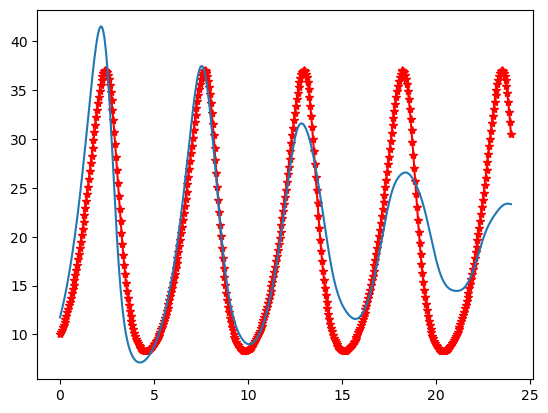

______________________________________________________________________0th iteration_________________________________________________________________
Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [ 1.11226964  1.22078624 -0.66509694 -0.00261075]
Recovered u_sigma = 4.295476530434468 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 4.295476530434468}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [ 0.9453618   1.27211189 -0.87027979  0.0025392 ]
Recovered u_sigma = 4.262928254384686 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 4.262928254384686}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [ 9.39890661e-01  1.28472421e+00 -8.30056346e-01 -3.69762935e-04]
Recovered u_sigma = 4.221694596702961 


Progre

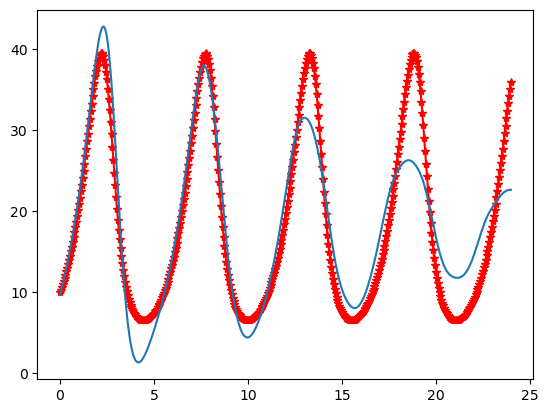

______________________________________________________________________0th iteration_________________________________________________________________
Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [-0.11744503  1.13776757  0.11239826 -0.01600773]
Recovered u_sigma = 6.222332800203114 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 6.222332800203114}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [ 0.57462482  1.38743181 -0.07393991 -0.03148678]
Recovered u_sigma = 5.553762808040592 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 5.553762808040592}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [ 0.6569947   1.44233407 -0.19903124 -0.03153985]
Recovered u_sigma = 5.460445156969249 


Progress: [###########

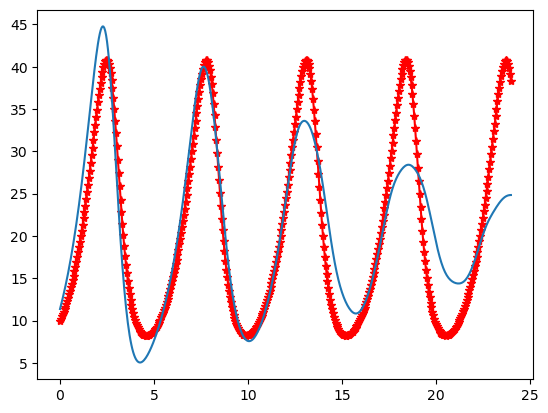

______________________________________________________________________0th iteration_________________________________________________________________
Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [-0.08998633  0.83557409 -0.73816887  0.04700038]
Recovered u_sigma = 9.961760940187606 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 9.961760940187606}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [ 0.4029953   1.49166378 -1.07856337  0.00489378]
Recovered u_sigma = 7.472911659978929 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 7.472911659978929}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [ 0.31022625  1.57902992 -0.45675993 -0.02905724]
Recovered u_sigma = 6.8603994119211436 


Progress: [##########

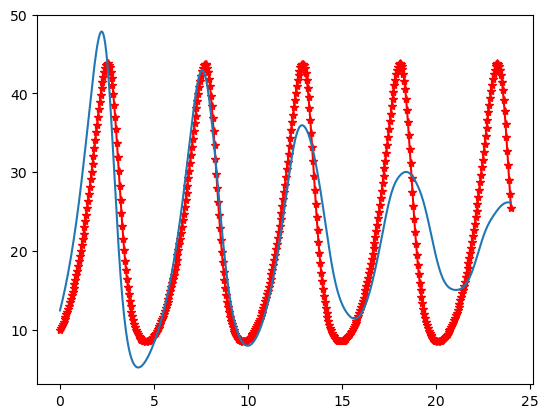

______________________________________________________________________0th iteration_________________________________________________________________
Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [1.02389654 0.25983734 0.14071976 0.04476808]
Recovered u_sigma = 5.535627563855712 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 5.535627563855712}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [1.7134937  0.2756982  0.49716883 0.02550011]
Recovered u_sigma = 4.973144773693048 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 4.973144773693048}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [1.40427281 0.32718026 0.64066833 0.01626303]
Recovered u_sigma = 4.823675313758719 


Progress: [#######################

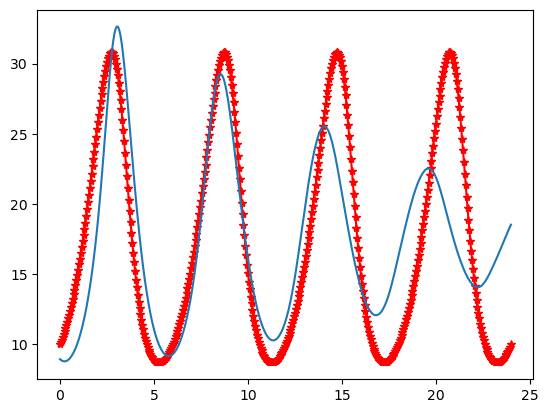

______________________________________________________________________0th iteration_________________________________________________________________
Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [0.12785474 0.48283003 0.46701399 0.00897827]
Recovered u_sigma = 8.114751937967482 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 8.114751937967482}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [ 0.25001055  0.4670026   0.77732425 -0.00351418]
Recovered u_sigma = 7.36566962294626 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 7.36566962294626}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [ 0.30090228  0.48471322  1.11347408 -0.01985979]
Recovered u_sigma = 6.856825457589318 


Progress: [#################

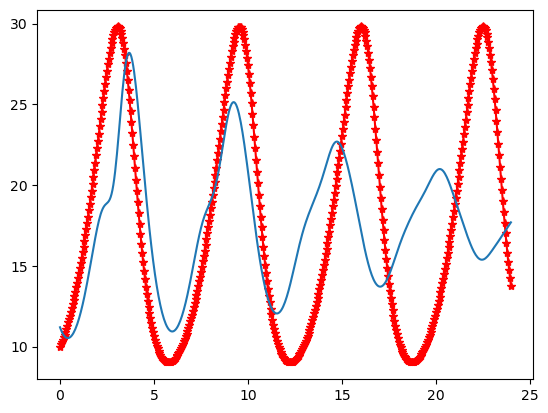

______________________________________________________________________0th iteration_________________________________________________________________
Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [ 0.16959631  0.91316336  0.7496067  -0.02985015]
Recovered u_sigma = 7.62170592812701 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 7.62170592812701}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [ 0.40696483  1.0082162   0.51000425 -0.02902485]
Recovered u_sigma = 6.900454514563404 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 6.900454514563404}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [ 0.72124548  1.16030358 -0.01646705 -0.02028169]
Recovered u_sigma = 5.881812227342292 


Progress: [#############

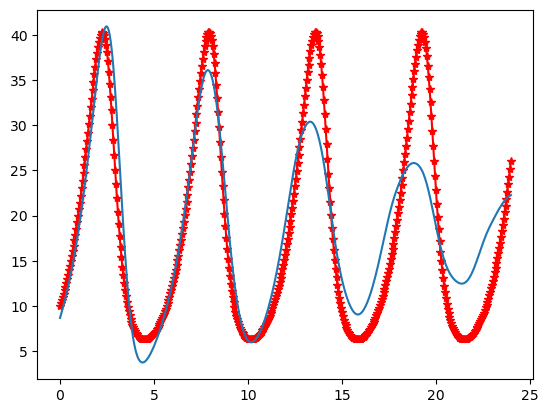

______________________________________________________________________0th iteration_________________________________________________________________
Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [0.32384559 0.3832729  0.51631044 0.0095804 ]
Recovered u_sigma = 4.25737433755202 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 4.25737433755202}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [ 2.93306469e-01  4.27404501e-01  6.53055417e-01 -1.03081242e-04]
Recovered u_sigma = 4.047947514223683 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 4.047947514223683}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [ 0.34523309  0.43837078  0.87588592 -0.01054009]
Recovered u_sigma = 3.814116343769989 


Progress: [#

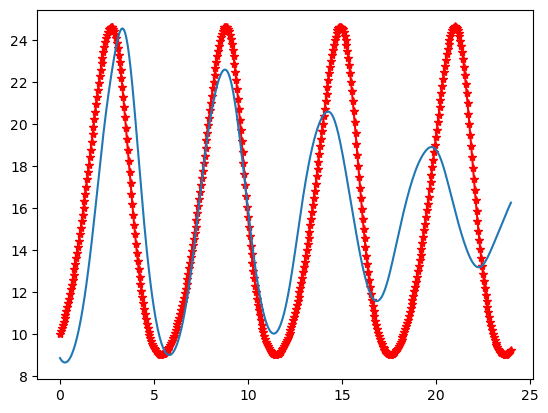

______________________________________________________________________0th iteration_________________________________________________________________
Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [-0.44806738  1.22280089  0.47280544 -0.0497118 ]
Recovered u_sigma = 5.83167355354303 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 5.83167355354303}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [-0.35522887  1.43005692  0.24651002 -0.05708238]
Recovered u_sigma = 5.027958312053936 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 5.027958312053936}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [-0.38302124  1.50449095  0.17330703 -0.05985099]
Recovered u_sigma = 4.931976501748095 


Progress: [#############

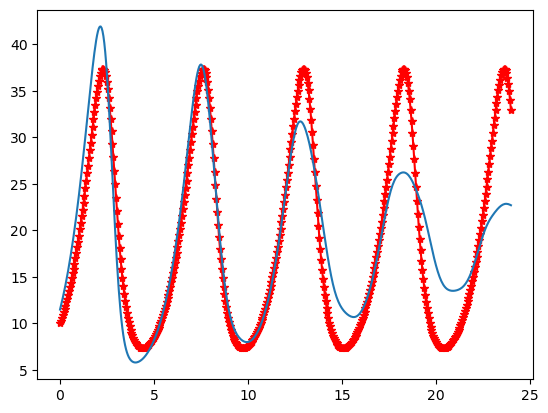

______________________________________________________________________0th iteration_________________________________________________________________
Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [-0.13711251  1.78888817  1.09740058 -0.1310679 ]
Recovered u_sigma = 8.102235693482001 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 8.102235693482001}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [-0.21518589  1.60347624  1.03442871 -0.11287138]
Recovered u_sigma = 7.907749647442813 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 7.907749647442813}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [-0.18422607  1.64188307  0.95349475 -0.11234918]
Recovered u_sigma = 7.929498462630319 


Progress: [###########

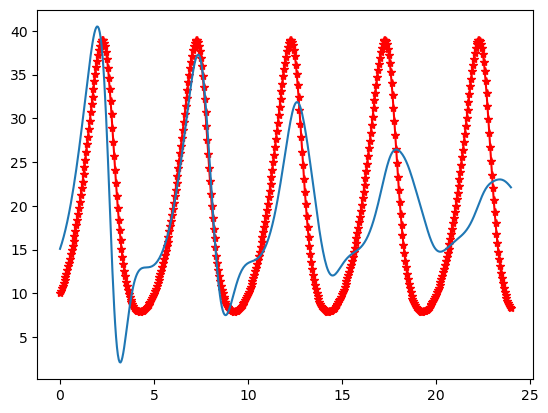

______________________________________________________________________0th iteration_________________________________________________________________
Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [-0.73233952  1.03281018 -0.20981387  0.02149087]
Recovered u_sigma = 4.442813032086105 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 4.442813032086105}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [-0.73596402  0.94461601 -0.43895016  0.03859219]
Recovered u_sigma = 4.173185541434268 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 4.173185541434268}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [-0.71828859  0.92895082 -0.49123451  0.04214453]
Recovered u_sigma = 4.074795850032027 


Progress: [###########

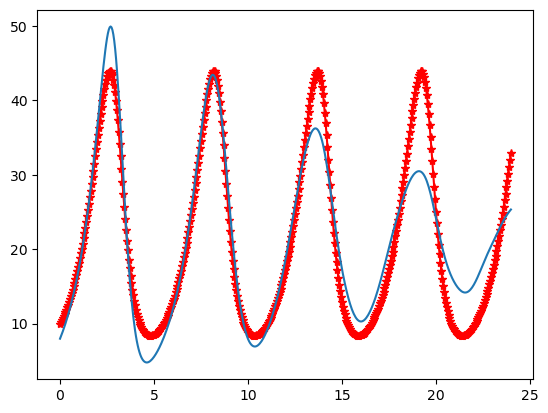

______________________________________________________________________0th iteration_________________________________________________________________
Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [ 1.73617631  0.95600788 -0.1403996  -0.00852241]
Recovered u_sigma = 2.9195805582123033 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 2.9195805582123033}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [ 1.67797658  0.93789244 -0.25566999 -0.0019632 ]
Recovered u_sigma = 2.850452025765587 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 2.850452025765587}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [ 1.79095076  0.91342718 -0.35944536  0.0041824 ]
Recovered u_sigma = 2.8581757515819253 


Progress: [########

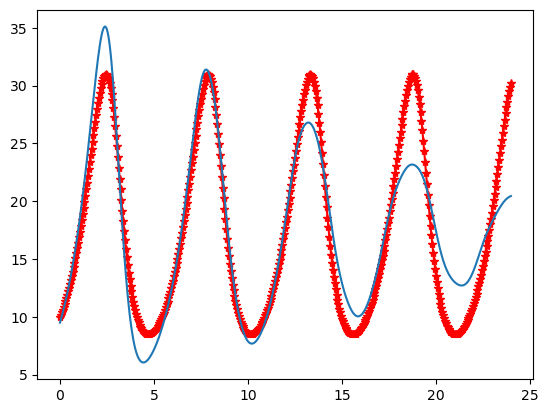

______________________________________________________________________0th iteration_________________________________________________________________
Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [ 0.14703428  1.10887556 -0.33416083  0.00527953]
Recovered u_sigma = 4.117603049368942 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 4.117603049368942}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [ 0.01786668  1.02016066 -0.52028577  0.02098919]
Recovered u_sigma = 3.8657755815962975 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 3.8657755815962975}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [ 0.05214489  1.01225674 -0.64699942  0.02691242]
Recovered u_sigma = 3.833120568392715 


Progress: [#########

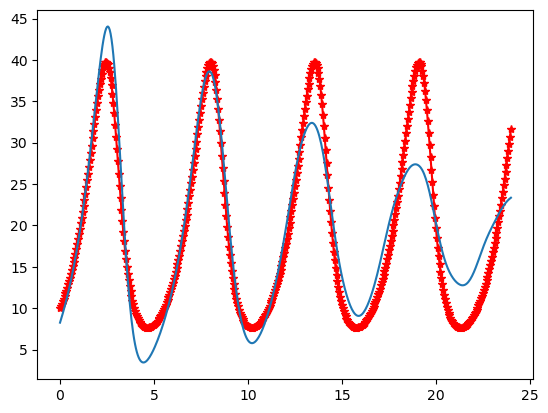

______________________________________________________________________0th iteration_________________________________________________________________
Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [ 0.3012231   0.23567461 -0.51386158  0.11266052]
Recovered u_sigma = 9.079739205726836 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 9.079739205726836}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [ 0.23562996  0.28176807 -0.08353425  0.09134821]
Recovered u_sigma = 8.56085856391311 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 8.56085856391311}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [0.20552157 0.23527832 0.19917467 0.0828126 ]
Recovered u_sigma = 8.485703562728071 


Progress: [#################

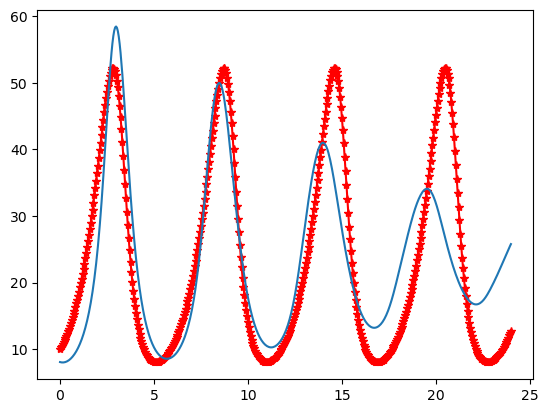

______________________________________________________________________0th iteration_________________________________________________________________
Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [-0.45151191  0.87402632 -0.38753229  0.02299723]
Recovered u_sigma = 3.2558502036576673 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 3.2558502036576673}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [-0.37592301  0.96075496 -0.3878267   0.0153977 ]
Recovered u_sigma = 3.1086563498202326 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 3.1086563498202326}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [-0.30641999  0.96788818 -0.39534599  0.01491669]
Recovered u_sigma = 3.067616157724394 


Progress: [#######

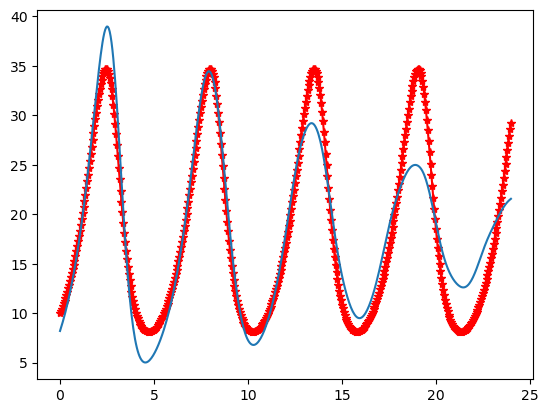

______________________________________________________________________0th iteration_________________________________________________________________
Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [ 0.70425113  1.56681698 -0.7231941  -0.0163297 ]
Recovered u_sigma = 5.936596873337749 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 5.936596873337749}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [ 0.38824016  1.5792835  -0.6576499  -0.01922908]
Recovered u_sigma = 5.96858753893893 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 5.96858753893893}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [ 0.34310901  1.55479224 -0.66008928 -0.01682137]
Recovered u_sigma = 5.9466547122551505 


Progress: [############

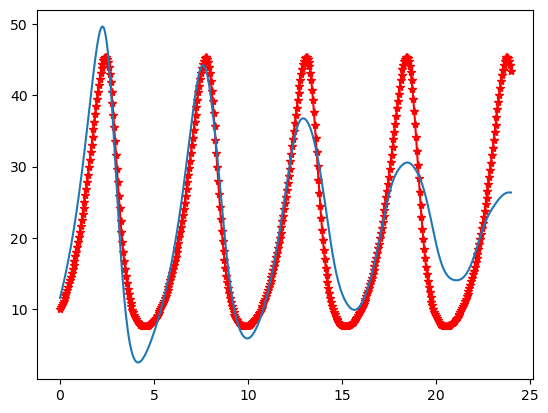

______________________________________________________________________0th iteration_________________________________________________________________
Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [-0.77387597  1.69338898 -0.9936409  -0.01022324]
Recovered u_sigma = 6.471718459343261 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 6.471718459343261}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [-0.61596733  1.69443671 -0.72189158 -0.02279155]
Recovered u_sigma = 6.319498280818266 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 6.319498280818266}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [-0.5496674   1.66912413 -0.72994234 -0.02044069]
Recovered u_sigma = 6.339969310567185 


Progress: [###########

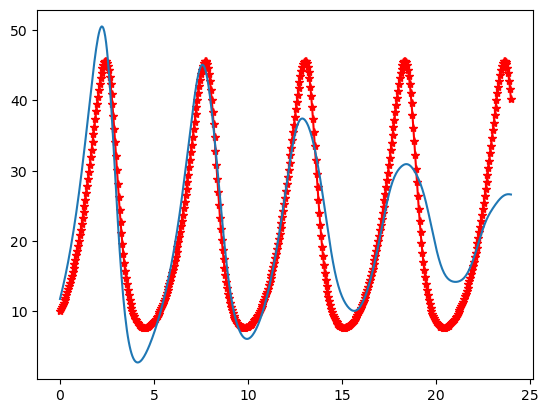

______________________________________________________________________0th iteration_________________________________________________________________
Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [-0.49365777  1.63594508  0.27800064 -0.05798147]
Recovered u_sigma = 12.200762068343455 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 12.200762068343455}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [-0.1221174   1.98774572  0.11096997 -0.0824587 ]
Recovered u_sigma = 11.239635337763012 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 11.239635337763012}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [ 0.03060576  1.99295153  0.01613928 -0.07835994]
Recovered u_sigma = 11.221342140708579 


Progress: [######

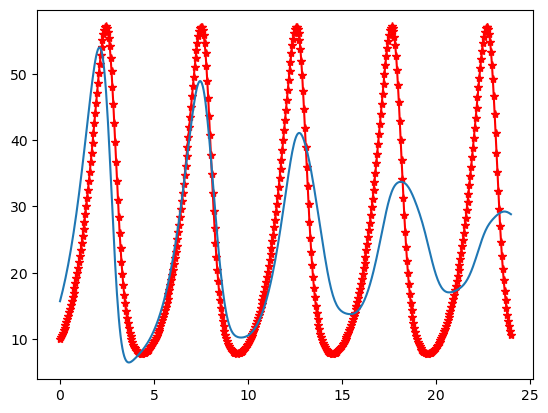

______________________________________________________________________0th iteration_________________________________________________________________
Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [-0.1475843   0.22705705  0.39192712  0.05887884]
Recovered u_sigma = 7.645256260135074 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 7.645256260135074}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [-0.21142084  0.08099651  1.16400415  0.03802965]
Recovered u_sigma = 6.764788548600883 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 6.764788548600883}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [0.66556565 0.21224886 1.32090207 0.01774298]
Recovered u_sigma = 6.519341421614796 


Progress: [###############

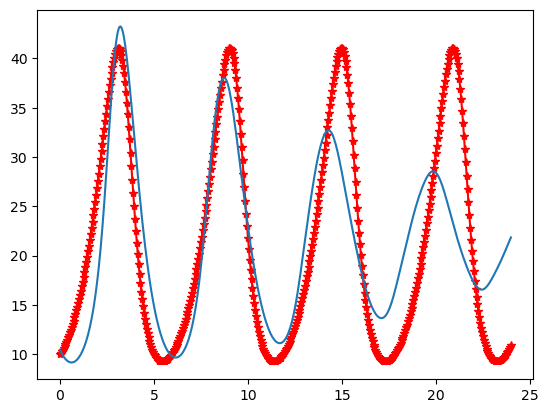

______________________________________________________________________0th iteration_________________________________________________________________
Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [ 0.22376179  0.82601021 -0.157631    0.0274147 ]
Recovered u_sigma = 4.534039930003897 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 4.534039930003897}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [-0.10362348  0.88627084 -0.32758586  0.03072358]
Recovered u_sigma = 4.316319190911232 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 4.316319190911232}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [-0.25526729  0.9094694  -0.50109754  0.03660109]
Recovered u_sigma = 4.13902657219139 


Progress: [############

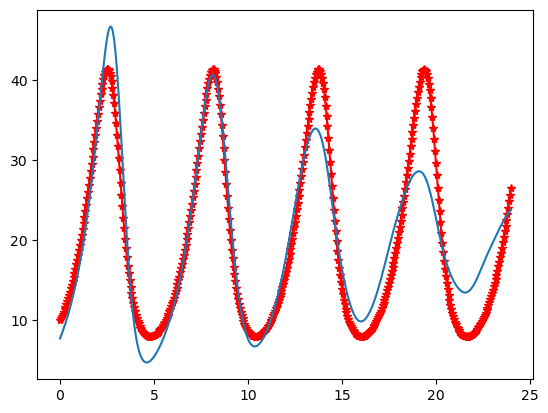

______________________________________________________________________0th iteration_________________________________________________________________
Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [-0.44978227  1.22739192 -0.20545508 -0.00538829]
Recovered u_sigma = 6.077644669275141 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 6.077644669275141}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [-5.19166229e-01  1.37887878e+00 -6.45595131e-01  1.29916197e-03]
Recovered u_sigma = 5.6927993851574294 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 5.6927993851574294}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [-0.48242205  1.48853046 -0.67455358 -0.00651876]
Recovered u_sigma = 5.674738479598114 


Prog

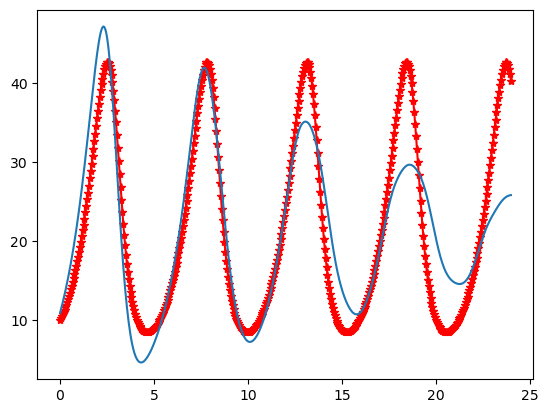

______________________________________________________________________0th iteration_________________________________________________________________
Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [ 0.48402906  0.76682985 -0.03735931  0.04419347]
Recovered u_sigma = 4.970132130912114 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 4.970132130912114}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [ 0.4705403   0.71016211 -0.19328112  0.05550658]
Recovered u_sigma = 4.713440524464312 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 4.713440524464312}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [ 0.46191356  0.68157689 -0.27456576  0.06105373]
Recovered u_sigma = 4.5826889889484415 


Progress: [##########

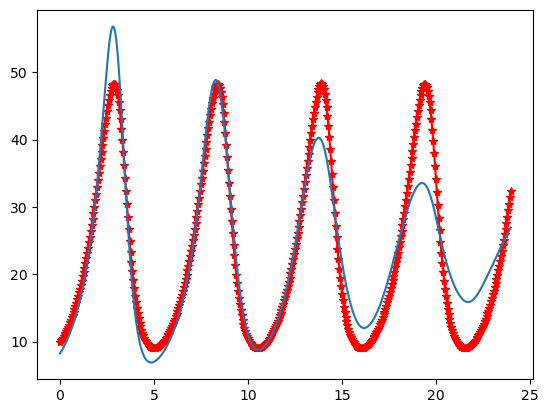

______________________________________________________________________0th iteration_________________________________________________________________
Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [-0.24658022 -0.17611252  1.61761927  0.06409593]
Recovered u_sigma = 9.000562028446412 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 9.000562028446412}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [-0.35987523  0.04872238  1.83925033  0.03679677]
Recovered u_sigma = 8.714139648286823 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 8.714139648286823}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [-0.57907624  0.12753724  1.96932622  0.02465345]
Recovered u_sigma = 8.679433040571176 


Progress: [###########

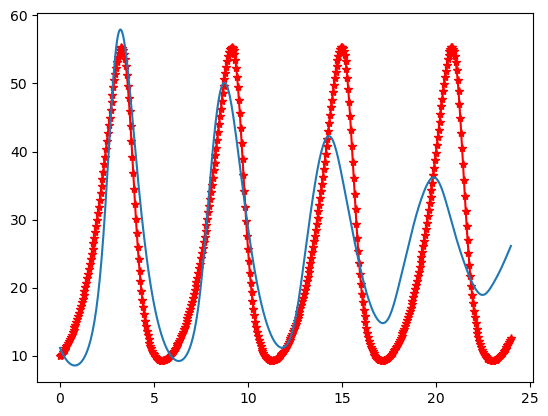

______________________________________________________________________0th iteration_________________________________________________________________
Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [-1.54929857  1.05031141 -1.4261139   0.06639305]
Recovered u_sigma = 5.073780481990658 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 5.073780481990658}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [-1.57106312  0.95379182 -1.18887265  0.06492468]
Recovered u_sigma = 4.481913448330838 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 4.481913448330838}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [-1.46314892  0.94167537 -0.57542844  0.03864698]
Recovered u_sigma = 3.5420082213493713 


Progress: [##########

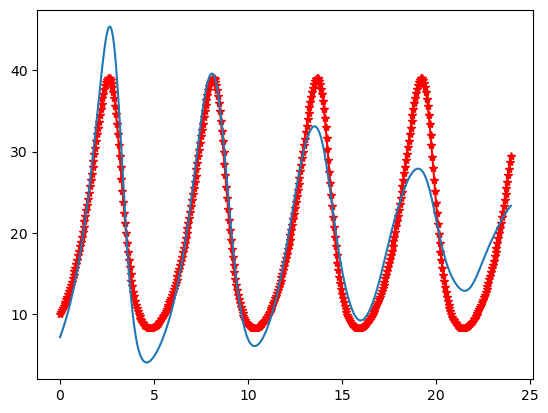

______________________________________________________________________0th iteration_________________________________________________________________
Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [ 1.05026313  1.96927155 -0.23342512 -0.08159638]
Recovered u_sigma = 9.28966455431806 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 9.28966455431806}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [ 1.0685748   1.99544317 -0.21939365 -0.08385429]
Recovered u_sigma = 9.204851201143537 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 9.204851201143537}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [ 1.02328228  1.99096207 -0.21556643 -0.08413155]
Recovered u_sigma = 9.159364105575518 


Progress: [#############

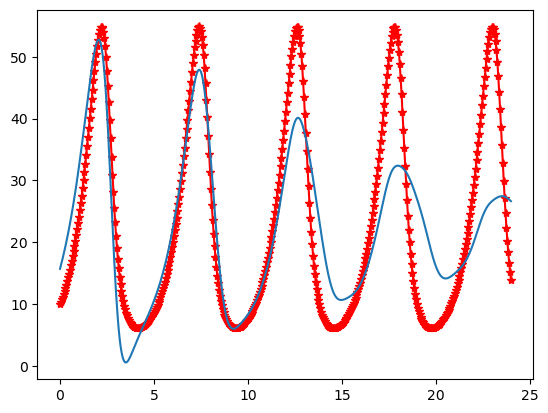

______________________________________________________________________0th iteration_________________________________________________________________
Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [-0.29574794  0.49101401 -0.49926401  0.04993763]
Recovered u_sigma = 4.607527384768418 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 4.607527384768418}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [-0.10026158  0.8430159  -0.5121054   0.02088359]
Recovered u_sigma = 3.794743906020445 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 3.794743906020445}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [ 0.0498442   0.77684067 -0.2667356   0.01538935]
Recovered u_sigma = 3.6045865221813966 


Progress: [##########

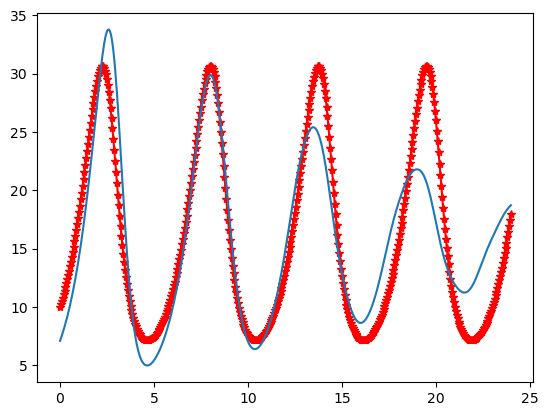

______________________________________________________________________0th iteration_________________________________________________________________
Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [1.93755505 0.26265796 0.23041211 0.04119349]
Recovered u_sigma = 5.231406157463479 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 5.231406157463479}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [1.94102894 0.42795471 0.07935134 0.03410324]
Recovered u_sigma = 4.32919566430151 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 4.32919566430151}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [ 0.96842293  0.65030259 -0.37414961  0.03830854]
Recovered u_sigma = 3.6281789621489975 


Progress: [####################

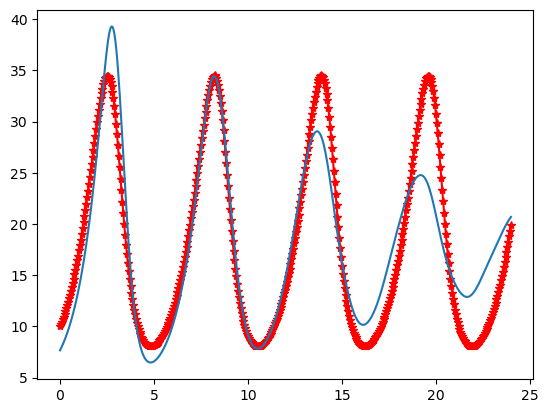

______________________________________________________________________0th iteration_________________________________________________________________
Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [-0.11958161  1.47232755  0.23928536 -0.0563096 ]
Recovered u_sigma = 5.239687848590528 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 5.239687848590528}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [ 2.78542925e-01  1.40734905e+00  1.32111174e-03 -4.19259296e-02]
Recovered u_sigma = 4.9399985689282655 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 4.9399985689282655}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [ 0.24022277  1.41503846 -0.11084866 -0.03774235]
Recovered u_sigma = 4.8028717207171105 


Pro

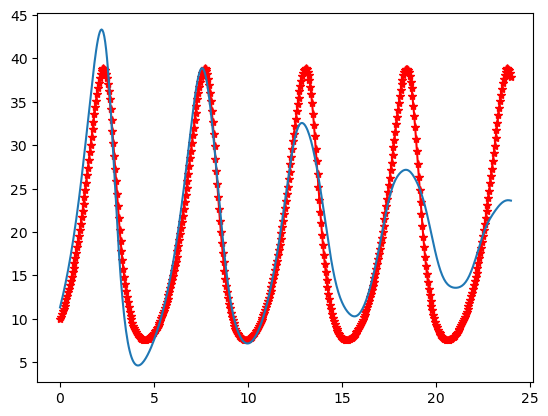

______________________________________________________________________0th iteration_________________________________________________________________
Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [-0.00629249  0.63745235 -0.41026804  0.06899094]
Recovered u_sigma = 4.312564061389602 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 4.312564061389602}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [ 0.09636772  0.62906743 -0.5313145   0.07438853]
Recovered u_sigma = 4.277141922112139 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 4.277141922112139}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [ 0.56129798  0.62016982 -0.56405684  0.07503723]
Recovered u_sigma = 4.305078689571905 


Progress: [###########

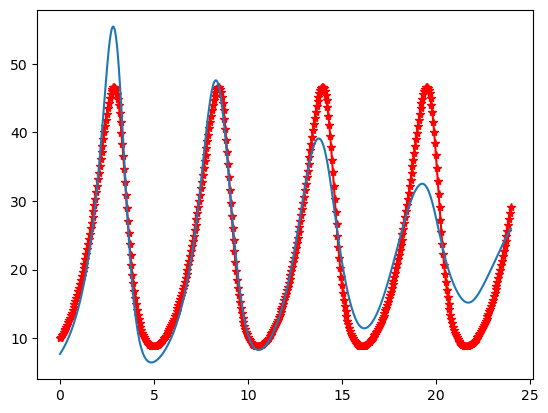

______________________________________________________________________0th iteration_________________________________________________________________
Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [-0.16614439  0.29498638  0.3313168   0.06641402]
Recovered u_sigma = 8.215387191905052 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 8.215387191905052}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [-0.16719873  0.33686249  0.32772157  0.06288018]
Recovered u_sigma = 8.216809989993346 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 8.216809989993346}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [-0.32571958  0.35239553  0.2662179   0.06481326]
Recovered u_sigma = 8.279880449720226 


Progress: [###########

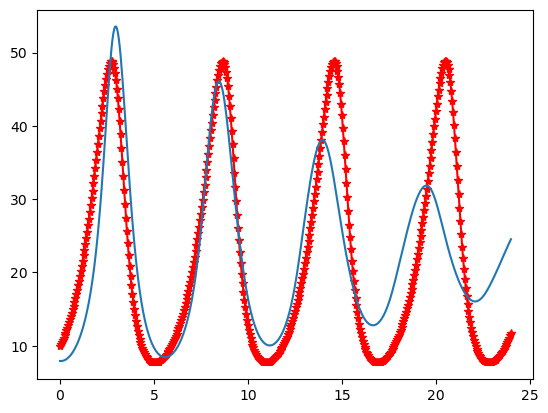

______________________________________________________________________0th iteration_________________________________________________________________
Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [-0.63054513  1.00689341 -0.13124685 -0.00807992]
Recovered u_sigma = 3.2601348170718256 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 3.2601348170718256}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [-0.61858969  1.09384446 -0.14618552 -0.01466309]
Recovered u_sigma = 3.0808598119648667 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 3.0808598119648667}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [-0.63407254  1.09348079 -0.23583144 -0.01054679]
Recovered u_sigma = 3.0348615472878366 


Progress: [######

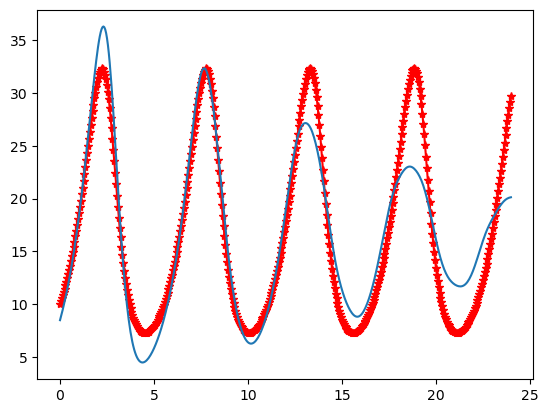

______________________________________________________________________0th iteration_________________________________________________________________
Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [ 1.23278359  0.64796492 -1.88184382  0.11398342]
Recovered u_sigma = 5.848945019263721 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 5.848945019263721}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [ 1.42395596  0.73458283 -1.59283794  0.09429433]
Recovered u_sigma = 5.062629647593633 


Progress: [##############################] 100 of 100 samples
sigma start = {'u_sigma': 5.062629647593633}
Progress: [##############################] 100 of 100 samples
Recovered u_params = [ 1.41488249  0.69060983 -1.33243015  0.08699294]
Recovered u_sigma = 4.564253207820496 


Progress: [###########

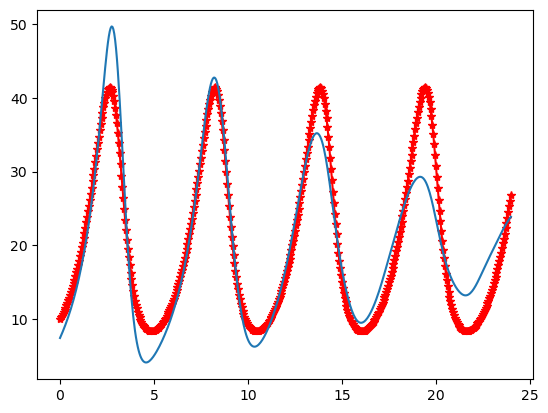

In [33]:
multi_u_Posterior_params = []
multi_u_Posterior_sigma = []
for i in range(len(path_dist)):
    u_dot_noisy = path_dist[i][:,0]

    # Initialize the parameters (params and sigma)
    u_start_params = np.zeros(4) #calc_mean(chain_param_ltk.params) #
    u_start_sigma = 0.1 #calc_mean(chain_eps_ltk.sigma) #
    num_step = 20
    
    
    u_Posterior_params = []
    u_Posterior_sigma = []
    # While the number of steps is less than a preset
    step = 0
    while step<num_step:
        if step%5 == 0:
            print(f'______________________________________________________________________{step}th iteration_________________________________________________________________')
        
        # Sample new params given sigma using ABC likelihood without gamma
        def log_likelihood(u_params):
            a,b,c,d = u_params
            sig = u_start_sigma
            
            # predict udot
            udot_predict = simulate_param(u_params, library).reshape(-1)
            
            model = smp.Model()
            # Log-likelihood
            model.add(smp.normal(udot_predict, mu=u_dot_noisy, sig=sig))   
        
            # log-priors
            model.add(smp.uniform(a, lower = -2, upper=2),
                      smp.uniform(b, lower = -2, upper=2),
                      smp.uniform(c, lower = -2, upper=2),
                      smp.uniform(d, lower = -2, upper=2)
                     )
            return model()
    
    
        u_start_params_ltk = {'u_params': u_start_params} # Set the starting model parameter
        # print(f'Params start = {u_start_params_ltk}') # Print the starting model parameter
        hmc_param_ltk = smp.Slice(log_likelihood, u_start_params_ltk)
        chain_param_ltk = hmc_param_ltk.sample(100, burn=50, n_chains=1)
        #Replace current with accepted params
        u_start_params = calc_mean(chain_param_ltk.u_params)
        
        
       
        # Sample new sigma given new params using sigma likelihood
        def sigma_likelihood(u_sigma):
            sig = u_sigma
            
            # predict udot
            udot_predict = simulate_param(u_start_params, library).reshape(-1)
            
            model = smp.Model()
            
            # Log-likelihood
            model.add(smp.normal(udot_predict, mu=u_dot_noisy, sig=sig))    
            # log-priors
            model.add(smp.exponential(sig))
            return model()
        
        #Sampling sigma given the parameters
        start_eps_ltk = {'u_sigma': u_start_sigma} # Set the starting sigma parameter
        print(f'sigma start = {start_eps_ltk}') # Print the starting sigma parameter
        hmc_eps_ltk = smp.Slice(sigma_likelihood, start_eps_ltk) #Hamiltonian, Slice, NUTS, Metropolis
        chain_eps_ltk = hmc_eps_ltk.sample(100, burn=50, n_chains=1)
        u_start_sigma = calc_mean(chain_eps_ltk.u_sigma)
        
        # Store the new params and sigma
        u_Posterior_params.append(u_start_params)
        u_Posterior_sigma.append(u_start_sigma)
        
        
        #Repeat step 3-5 
        step +=1
        # mean_params = start_params
        print(f'Recovered u_params = {u_start_params}')
        print(f'Recovered u_sigma = {u_start_sigma} \n\n')
    
    print(calc_mean(u_Posterior_params), calc_mean(u_Posterior_sigma))
    u_dot_post = simulate_param(calc_mean(u_Posterior_params), library)
    plt.plot(t, u_dot_noisy, 'r*-')
    plt.plot(t, u_dot_post)
    plt.show()
    
    multi_u_Posterior_params.append(calc_mean(u_Posterior_params))
    multi_u_Posterior_sigma.append(calc_mean(u_Posterior_sigma))    

______________________________________________________________________0th iteration_________________________________________________________________
Params start = {'v_params': array([0., 0., 0., 0.])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [-0.37723979  0.22200549  0.89776436 -0.0246767 ]
Recovered v_sigma = 5.249999133429768 


Params start = {'v_params': array([-0.37723979,  0.22200549,  0.89776436, -0.0246767 ])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 5.249999133429768}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [-0.01277533  0.22432695  1.82177878 -0.06599577]
Recovered v_sigma = 3.8362607213946562 


Params start = {'v_params': array([-0.01277533,  0.22432695,  1.82177878, -0.06599577])}
Progress: [##############################] 100 of 100 samples
sigma sta

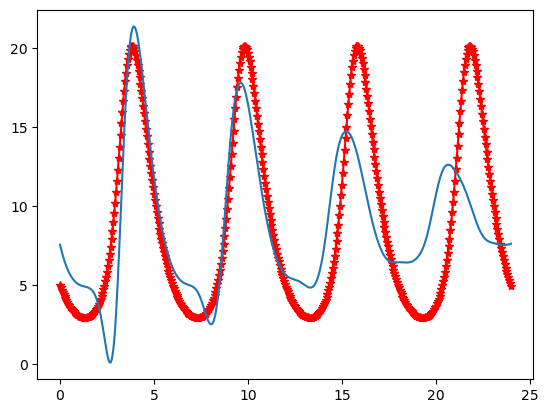

______________________________________________________________________0th iteration_________________________________________________________________
Params start = {'v_params': array([0., 0., 0., 0.])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [ 1.07211415 -0.31229983  0.67077221  0.03668107]
Recovered v_sigma = 3.3988820392543433 


Params start = {'v_params': array([ 1.07211415, -0.31229983,  0.67077221,  0.03668107])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 3.3988820392543433}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [ 1.04229918 -0.25293292  0.84186478  0.02480191]
Recovered v_sigma = 3.0824934457519886 


Params start = {'v_params': array([ 1.04229918, -0.25293292,  0.84186478,  0.02480191])}
Progress: [##############################] 100 of 100 samples
sigma s

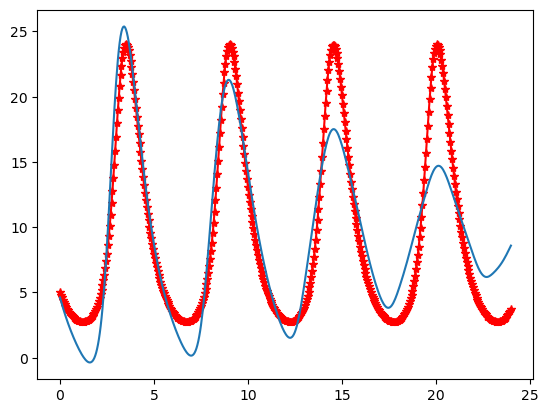

______________________________________________________________________0th iteration_________________________________________________________________
Params start = {'v_params': array([0., 0., 0., 0.])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [ 0.05803629 -0.19812343  0.23481188  0.05818917]
Recovered v_sigma = 3.215564374291621 


Params start = {'v_params': array([ 0.05803629, -0.19812343,  0.23481188,  0.05818917])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 3.215564374291621}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [ 0.00394061 -0.16790099  0.45748177  0.04640952]
Recovered v_sigma = 3.0563586604330437 


Params start = {'v_params': array([ 0.00394061, -0.16790099,  0.45748177,  0.04640952])}
Progress: [##############################] 100 of 100 samples
sigma sta

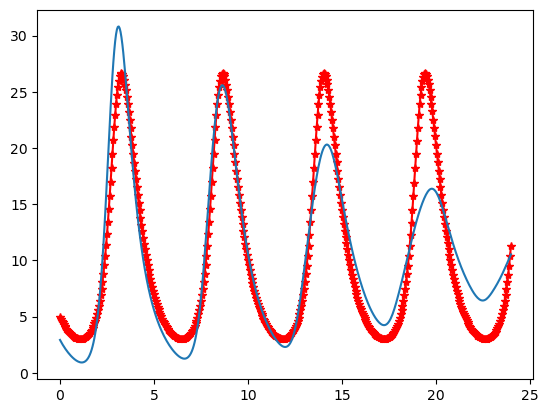

______________________________________________________________________0th iteration_________________________________________________________________
Params start = {'v_params': array([0., 0., 0., 0.])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [-0.2752945  -0.16487453  1.5108586  -0.00604648]
Recovered v_sigma = 3.2475821090161845 


Params start = {'v_params': array([-0.2752945 , -0.16487453,  1.5108586 , -0.00604648])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 3.2475821090161845}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [-0.27401293 -0.14624739  1.58456399 -0.01065389]
Recovered v_sigma = 3.153240696417778 


Params start = {'v_params': array([-0.27401293, -0.14624739,  1.58456399, -0.01065389])}
Progress: [##############################] 100 of 100 samples
sigma st

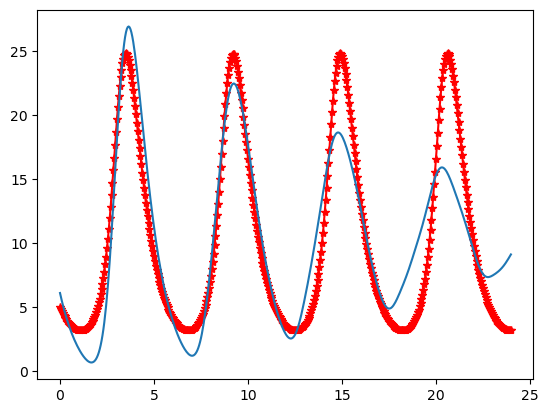

______________________________________________________________________0th iteration_________________________________________________________________
Params start = {'v_params': array([0., 0., 0., 0.])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [ 0.40069235 -0.10093697  0.6582644   0.01843529]
Recovered v_sigma = 3.727659495730319 


Params start = {'v_params': array([ 0.40069235, -0.10093697,  0.6582644 ,  0.01843529])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 3.727659495730319}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [ 0.45137815 -0.19033355  0.98925587  0.01162878]
Recovered v_sigma = 2.957767109398446 


Params start = {'v_params': array([ 0.45137815, -0.19033355,  0.98925587,  0.01162878])}
Progress: [##############################] 100 of 100 samples
sigma star

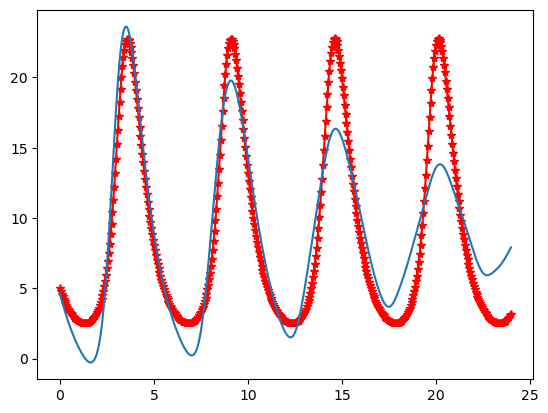

______________________________________________________________________0th iteration_________________________________________________________________
Params start = {'v_params': array([0., 0., 0., 0.])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [-0.1517317   0.36571305 -0.21065739  0.04443446]
Recovered v_sigma = 8.105569041737484 


Params start = {'v_params': array([-0.1517317 ,  0.36571305, -0.21065739,  0.04443446])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 8.105569041737484}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [-0.27236465  0.43045109 -0.43028625  0.04863305]
Recovered v_sigma = 7.94925205967707 


Params start = {'v_params': array([-0.27236465,  0.43045109, -0.43028625,  0.04863305])}
Progress: [##############################] 100 of 100 samples
sigma start

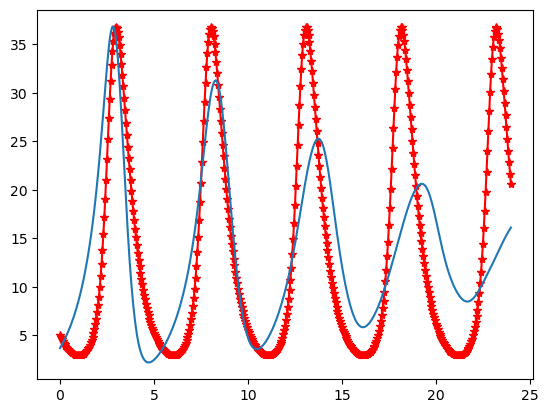

______________________________________________________________________0th iteration_________________________________________________________________
Params start = {'v_params': array([0., 0., 0., 0.])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [-0.04058941  0.04124708  0.3621627   0.0131821 ]
Recovered v_sigma = 4.305297521890585 


Params start = {'v_params': array([-0.04058941,  0.04124708,  0.3621627 ,  0.0131821 ])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 4.305297521890585}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [-0.23918137 -0.03920458  0.66389839  0.00845781]
Recovered v_sigma = 3.309596453392461 


Params start = {'v_params': array([-0.23918137, -0.03920458,  0.66389839,  0.00845781])}
Progress: [##############################] 100 of 100 samples
sigma star

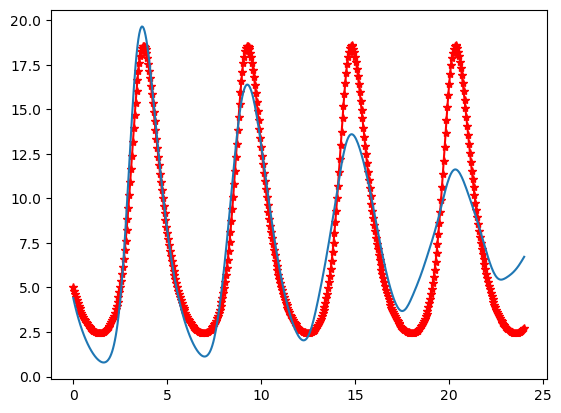

______________________________________________________________________0th iteration_________________________________________________________________
Params start = {'v_params': array([0., 0., 0., 0.])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [ 0.35662127 -0.10322835  1.39156359 -0.00593291]
Recovered v_sigma = 3.735108929925035 


Params start = {'v_params': array([ 0.35662127, -0.10322835,  1.39156359, -0.00593291])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 3.735108929925035}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [ 0.48259092 -0.0637543   1.45873434 -0.01249516]
Recovered v_sigma = 3.68720233439293 


Params start = {'v_params': array([ 0.48259092, -0.0637543 ,  1.45873434, -0.01249516])}
Progress: [##############################] 100 of 100 samples
sigma start

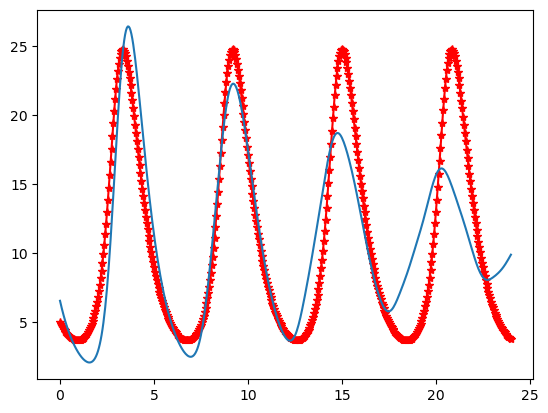

______________________________________________________________________0th iteration_________________________________________________________________
Params start = {'v_params': array([0., 0., 0., 0.])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [-0.45636279 -0.08603358  0.9590668   0.00651549]
Recovered v_sigma = 3.33925210178937 


Params start = {'v_params': array([-0.45636279, -0.08603358,  0.9590668 ,  0.00651549])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 3.33925210178937}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [-0.52170894 -0.03287809  1.19292454 -0.00759091]
Recovered v_sigma = 2.8521236926460203 


Params start = {'v_params': array([-0.52170894, -0.03287809,  1.19292454, -0.00759091])}
Progress: [##############################] 100 of 100 samples
sigma start

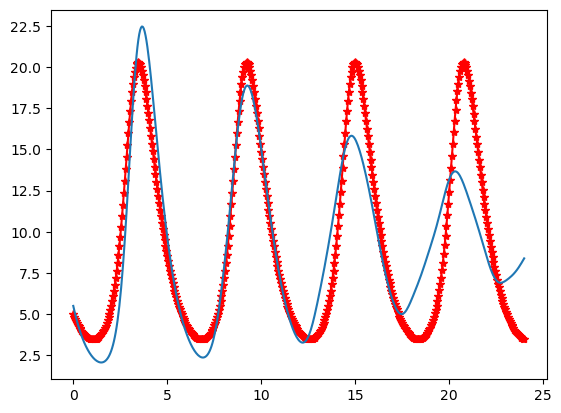

______________________________________________________________________0th iteration_________________________________________________________________
Params start = {'v_params': array([0., 0., 0., 0.])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [-0.06467205  0.17837945  0.2135976   0.01730283]
Recovered v_sigma = 8.953809887690532 


Params start = {'v_params': array([-0.06467205,  0.17837945,  0.2135976 ,  0.01730283])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 8.953809887690532}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [-0.18857006 -0.06430491  1.16659361 -0.00327376]
Recovered v_sigma = 6.643786479307996 


Params start = {'v_params': array([-0.18857006, -0.06430491,  1.16659361, -0.00327376])}
Progress: [##############################] 100 of 100 samples
sigma star

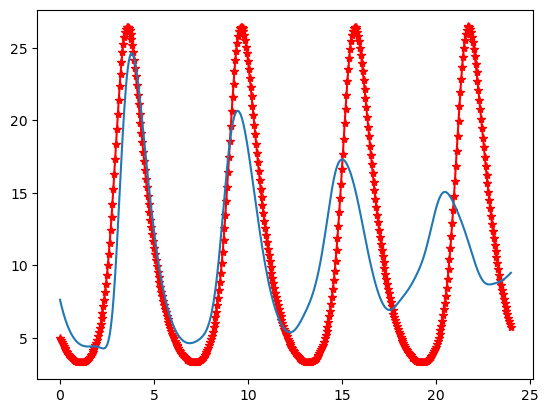

______________________________________________________________________0th iteration_________________________________________________________________
Params start = {'v_params': array([0., 0., 0., 0.])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [ 1.02995402  0.13209312  0.82990546 -0.02346551]
Recovered v_sigma = 3.3479073267123556 


Params start = {'v_params': array([ 1.02995402,  0.13209312,  0.82990546, -0.02346551])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 3.3479073267123556}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [ 1.09668667  0.07790754  1.04021916 -0.02797567]
Recovered v_sigma = 2.81765088545295 


Params start = {'v_params': array([ 1.09668667,  0.07790754,  1.04021916, -0.02797567])}
Progress: [##############################] 100 of 100 samples
sigma sta

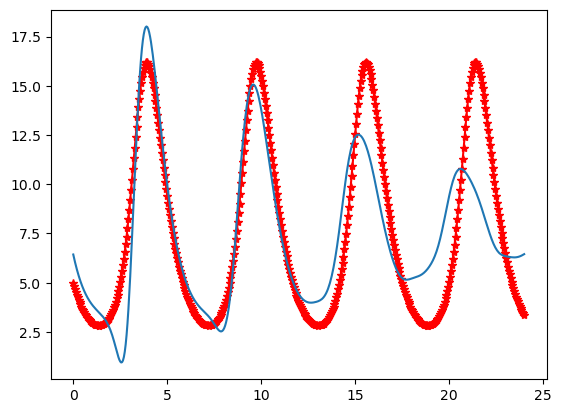

______________________________________________________________________0th iteration_________________________________________________________________
Params start = {'v_params': array([0., 0., 0., 0.])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [0.02366411 0.00517841 0.25233815 0.01986689]
Recovered v_sigma = 6.4598115624533285 


Params start = {'v_params': array([0.02366411, 0.00517841, 0.25233815, 0.01986689])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 6.4598115624533285}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [ 0.02632345 -0.09158053  0.71657736  0.00733014]
Recovered v_sigma = 4.963716784231214 


Params start = {'v_params': array([ 0.02632345, -0.09158053,  0.71657736,  0.00733014])}
Progress: [##############################] 100 of 100 samples
sigma start = {'

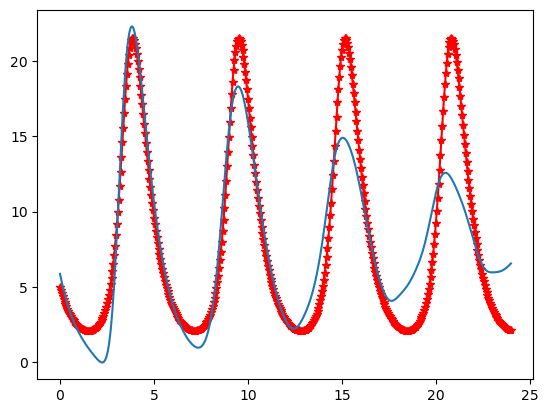

______________________________________________________________________0th iteration_________________________________________________________________
Params start = {'v_params': array([0., 0., 0., 0.])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [-0.11428925 -0.02558861  0.06005693  0.02802263]
Recovered v_sigma = 6.407462226632306 


Params start = {'v_params': array([-0.11428925, -0.02558861,  0.06005693,  0.02802263])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 6.407462226632306}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [-0.2975175   0.29329784  1.03640018 -0.03884652]
Recovered v_sigma = 3.649080056322372 


Params start = {'v_params': array([-0.2975175 ,  0.29329784,  1.03640018, -0.03884652])}
Progress: [##############################] 100 of 100 samples
sigma star

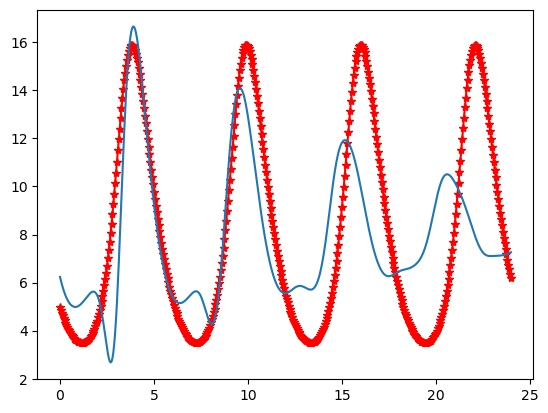

______________________________________________________________________0th iteration_________________________________________________________________
Params start = {'v_params': array([0., 0., 0., 0.])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [ 0.06973658  0.36586591  0.52092452 -0.0261169 ]
Recovered v_sigma = 5.557264327241613 


Params start = {'v_params': array([ 0.06973658,  0.36586591,  0.52092452, -0.0261169 ])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 5.557264327241613}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [ 0.31486329  0.27500935  1.16495359 -0.04704351]
Recovered v_sigma = 4.494556329073077 


Params start = {'v_params': array([ 0.31486329,  0.27500935,  1.16495359, -0.04704351])}
Progress: [##############################] 100 of 100 samples
sigma star

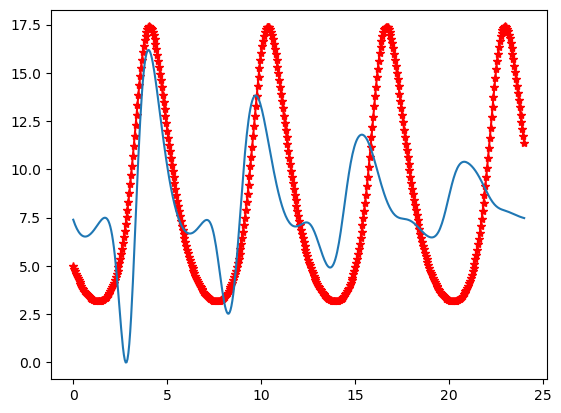

______________________________________________________________________0th iteration_________________________________________________________________
Params start = {'v_params': array([0., 0., 0., 0.])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [ 0.05127842 -0.02402265  0.06574445  0.04065672]
Recovered v_sigma = 3.422629933975543 


Params start = {'v_params': array([ 0.05127842, -0.02402265,  0.06574445,  0.04065672])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 3.422629933975543}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [ 0.03643239 -0.04312333  0.04061938  0.04350853]
Recovered v_sigma = 3.4424401862304648 


Params start = {'v_params': array([ 0.03643239, -0.04312333,  0.04061938,  0.04350853])}
Progress: [##############################] 100 of 100 samples
sigma sta

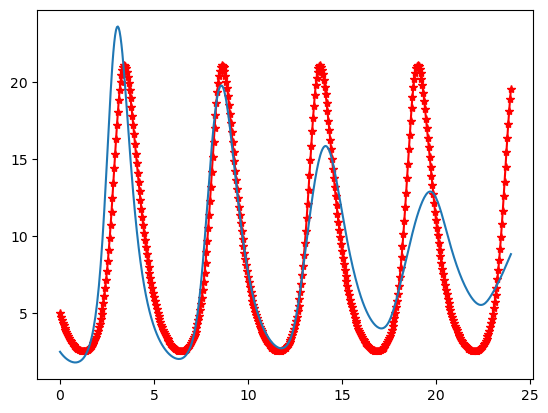

______________________________________________________________________0th iteration_________________________________________________________________
Params start = {'v_params': array([0., 0., 0., 0.])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [0.35364814 0.022402   0.10476535 0.03285062]
Recovered v_sigma = 2.0804576384822604 


Params start = {'v_params': array([0.35364814, 0.022402  , 0.10476535, 0.03285062])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 2.0804576384822604}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [0.37585016 0.02736119 0.15234225 0.03045981]
Recovered v_sigma = 1.9974055023511859 


Params start = {'v_params': array([0.37585016, 0.02736119, 0.15234225, 0.03045981])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma

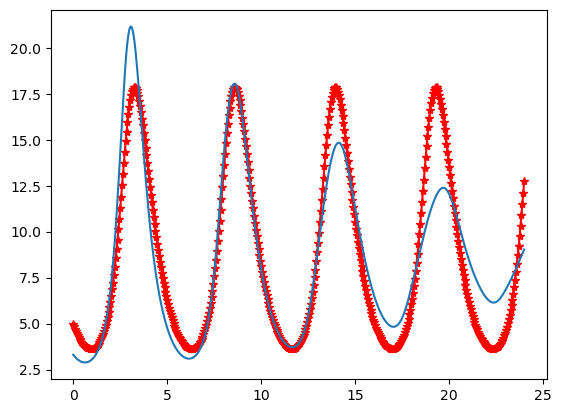

______________________________________________________________________0th iteration_________________________________________________________________
Params start = {'v_params': array([0., 0., 0., 0.])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [0.02183537 0.08607805 0.08823257 0.02888632]
Recovered v_sigma = 2.2630406461829735 


Params start = {'v_params': array([0.02183537, 0.08607805, 0.08823257, 0.02888632])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 2.2630406461829735}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [-0.0630735   0.06690136  0.21840985  0.02516038]
Recovered v_sigma = 2.1827950712892816 


Params start = {'v_params': array([-0.0630735 ,  0.06690136,  0.21840985,  0.02516038])}
Progress: [##############################] 100 of 100 samples
sigma start = {

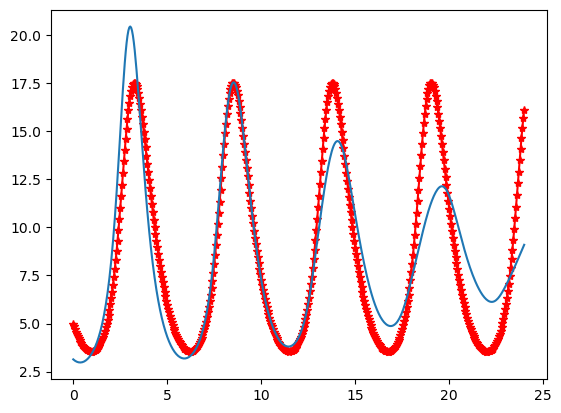

______________________________________________________________________0th iteration_________________________________________________________________
Params start = {'v_params': array([0., 0., 0., 0.])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [0.01680209 0.25504783 0.43309387 0.00380179]
Recovered v_sigma = 5.195279765962954 


Params start = {'v_params': array([0.01680209, 0.25504783, 0.43309387, 0.00380179])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 5.195279765962954}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [2.40173006e-01 1.72069200e-01 6.70596299e-01 1.35339148e-04]
Recovered v_sigma = 4.467530828703099 


Params start = {'v_params': array([2.40173006e-01, 1.72069200e-01, 6.70596299e-01, 1.35339148e-04])}
Progress: [##############################] 100 of 100 sa

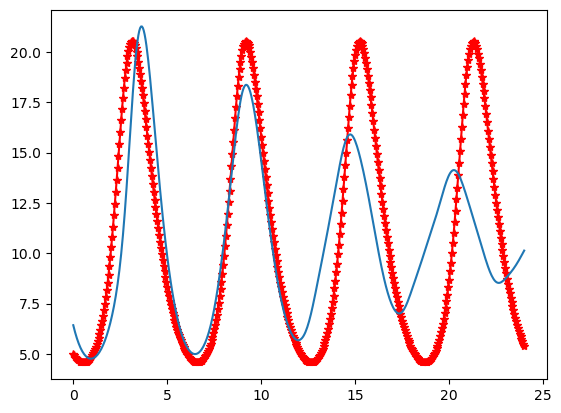

______________________________________________________________________0th iteration_________________________________________________________________
Params start = {'v_params': array([0., 0., 0., 0.])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [-0.0248575   0.0272698   0.11394073  0.04612331]
Recovered v_sigma = 3.006450971049844 


Params start = {'v_params': array([-0.0248575 ,  0.0272698 ,  0.11394073,  0.04612331])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 3.006450971049844}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [-0.14351275  0.04279141  0.12195247  0.04495204]
Recovered v_sigma = 3.020895510903379 


Params start = {'v_params': array([-0.14351275,  0.04279141,  0.12195247,  0.04495204])}
Progress: [##############################] 100 of 100 samples
sigma star

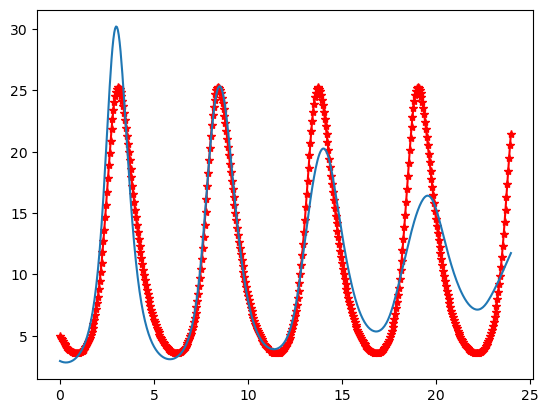

______________________________________________________________________0th iteration_________________________________________________________________
Params start = {'v_params': array([0., 0., 0., 0.])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [-0.97198491 -0.16066729 -0.27297261  0.08261699]
Recovered v_sigma = 5.157783688720241 


Params start = {'v_params': array([-0.97198491, -0.16066729, -0.27297261,  0.08261699])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 5.157783688720241}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [-0.81026305 -0.05098592  0.06231458  0.05821644]
Recovered v_sigma = 4.813289494637192 


Params start = {'v_params': array([-0.81026305, -0.05098592,  0.06231458,  0.05821644])}
Progress: [##############################] 100 of 100 samples
sigma star

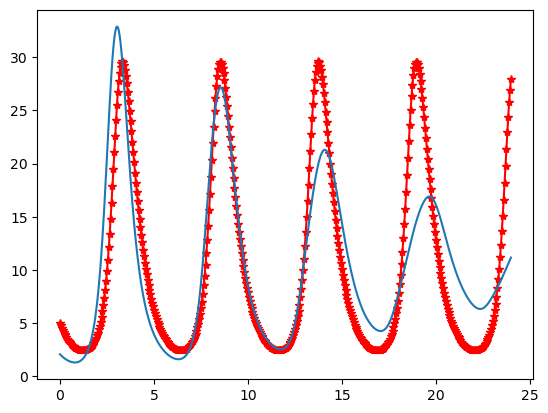

______________________________________________________________________0th iteration_________________________________________________________________
Params start = {'v_params': array([0., 0., 0., 0.])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [-1.42416248  0.21858878  1.80434452 -0.05902654]
Recovered v_sigma = 3.7217906815112434 


Params start = {'v_params': array([-1.42416248,  0.21858878,  1.80434452, -0.05902654])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 3.7217906815112434}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [-1.53722997  0.23378024  1.76813706 -0.05837222]
Recovered v_sigma = 3.7477776118292154 


Params start = {'v_params': array([-1.53722997,  0.23378024,  1.76813706, -0.05837222])}
Progress: [##############################] 100 of 100 samples
sigma s

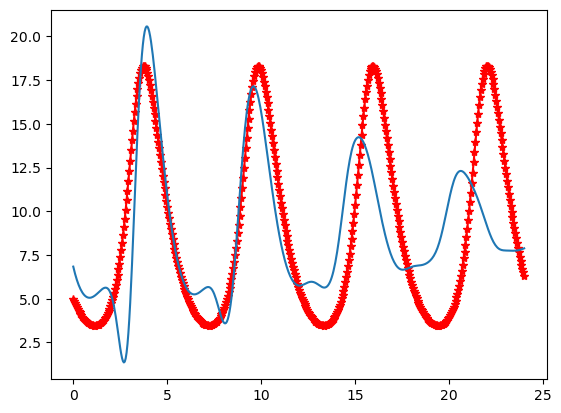

______________________________________________________________________0th iteration_________________________________________________________________
Params start = {'v_params': array([0., 0., 0., 0.])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [-0.30662655  0.43742659 -0.09126824  0.02062536]
Recovered v_sigma = 6.688456758901417 


Params start = {'v_params': array([-0.30662655,  0.43742659, -0.09126824,  0.02062536])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 6.688456758901417}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [-0.32063382  0.36855945 -0.10643281  0.02736572]
Recovered v_sigma = 6.6918824319509085 


Params start = {'v_params': array([-0.32063382,  0.36855945, -0.10643281,  0.02736572])}
Progress: [##############################] 100 of 100 samples
sigma sta

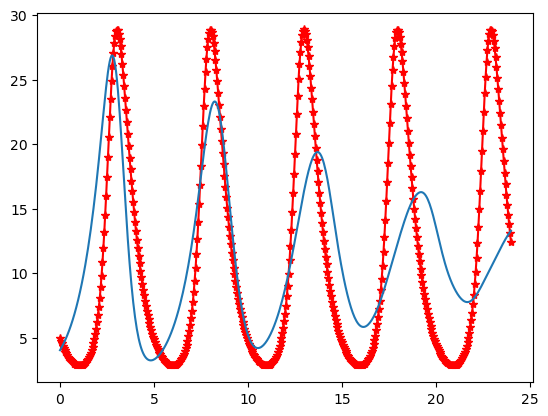

______________________________________________________________________0th iteration_________________________________________________________________
Params start = {'v_params': array([0., 0., 0., 0.])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [-0.35914526 -0.20174761  0.53771867  0.05003069]
Recovered v_sigma = 4.654400543389669 


Params start = {'v_params': array([-0.35914526, -0.20174761,  0.53771867,  0.05003069])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 4.654400543389669}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [-0.34507011 -0.32300154  0.85432147  0.04667267]
Recovered v_sigma = 4.066553750775159 


Params start = {'v_params': array([-0.34507011, -0.32300154,  0.85432147,  0.04667267])}
Progress: [##############################] 100 of 100 samples
sigma star

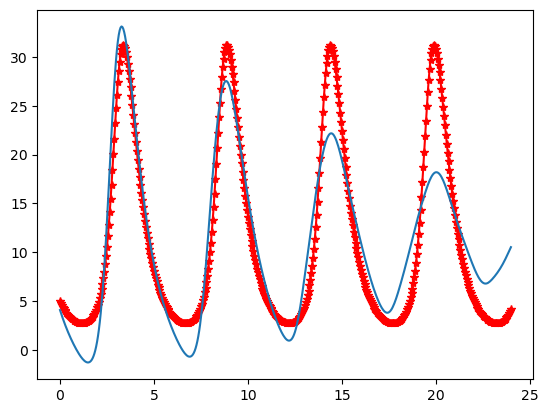

______________________________________________________________________0th iteration_________________________________________________________________
Params start = {'v_params': array([0., 0., 0., 0.])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [-0.03040682 -0.00176344  0.18518181  0.02941597]
Recovered v_sigma = 3.0378652294118784 


Params start = {'v_params': array([-0.03040682, -0.00176344,  0.18518181,  0.02941597])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 3.0378652294118784}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [ 0.07726541 -0.01496455  0.60250467  0.01248474]
Recovered v_sigma = 1.9576879581036835 


Params start = {'v_params': array([ 0.07726541, -0.01496455,  0.60250467,  0.01248474])}
Progress: [##############################] 100 of 100 samples
sigma s

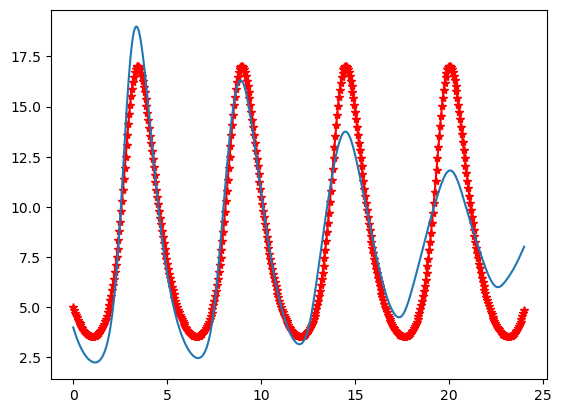

______________________________________________________________________0th iteration_________________________________________________________________
Params start = {'v_params': array([0., 0., 0., 0.])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [-0.1860252  -0.18298005  0.49674417  0.04009342]
Recovered v_sigma = 3.4861871908072777 


Params start = {'v_params': array([-0.1860252 , -0.18298005,  0.49674417,  0.04009342])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 3.4861871908072777}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [ 0.05124259 -0.19364826  0.8164696   0.02673516]
Recovered v_sigma = 2.9889086840751546 


Params start = {'v_params': array([ 0.05124259, -0.19364826,  0.8164696 ,  0.02673516])}
Progress: [##############################] 100 of 100 samples
sigma s

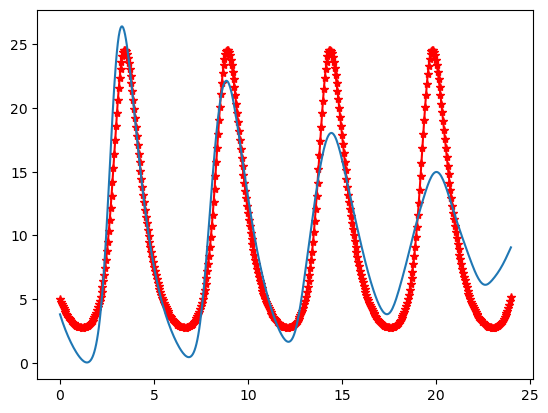

______________________________________________________________________0th iteration_________________________________________________________________
Params start = {'v_params': array([0., 0., 0., 0.])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [ 0.83446894  0.08353132  1.33517091 -0.03560899]
Recovered v_sigma = 2.74623457750599 


Params start = {'v_params': array([ 0.83446894,  0.08353132,  1.33517091, -0.03560899])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 2.74623457750599}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [ 0.76376293  0.04324234  1.37519739 -0.03371606]
Recovered v_sigma = 2.581209905672159 


Params start = {'v_params': array([ 0.76376293,  0.04324234,  1.37519739, -0.03371606])}
Progress: [##############################] 100 of 100 samples
sigma start 

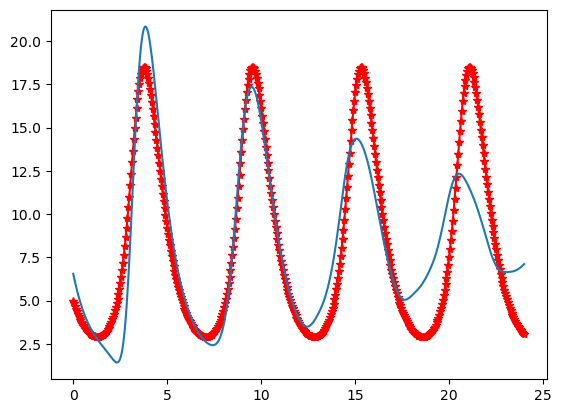

______________________________________________________________________0th iteration_________________________________________________________________
Params start = {'v_params': array([0., 0., 0., 0.])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [-0.02375414  0.0992774   0.05774741  0.03633002]
Recovered v_sigma = 2.112878340960571 


Params start = {'v_params': array([-0.02375414,  0.0992774 ,  0.05774741,  0.03633002])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 2.112878340960571}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [-0.00108623  0.08605934  0.17838455  0.03221359]
Recovered v_sigma = 2.0588708635804163 


Params start = {'v_params': array([-0.00108623,  0.08605934,  0.17838455,  0.03221359])}
Progress: [##############################] 100 of 100 samples
sigma sta

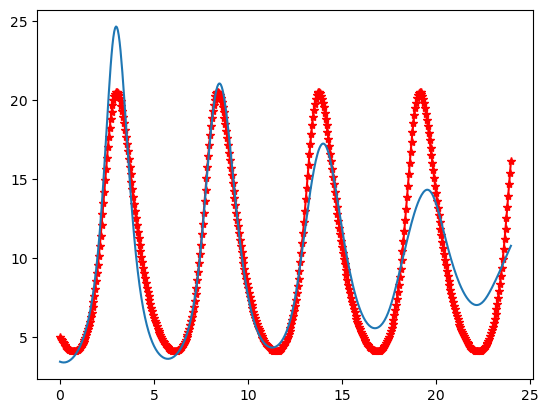

______________________________________________________________________0th iteration_________________________________________________________________
Params start = {'v_params': array([0., 0., 0., 0.])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [ 0.03179452  0.22065016  0.27259387 -0.00446335]
Recovered v_sigma = 5.981016463903952 


Params start = {'v_params': array([ 0.03179452,  0.22065016,  0.27259387, -0.00446335])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 5.981016463903952}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [-0.033065    0.34606878  0.32808679 -0.01714542]
Recovered v_sigma = 5.694425545205799 


Params start = {'v_params': array([-0.033065  ,  0.34606878,  0.32808679, -0.01714542])}
Progress: [##############################] 100 of 100 samples
sigma star

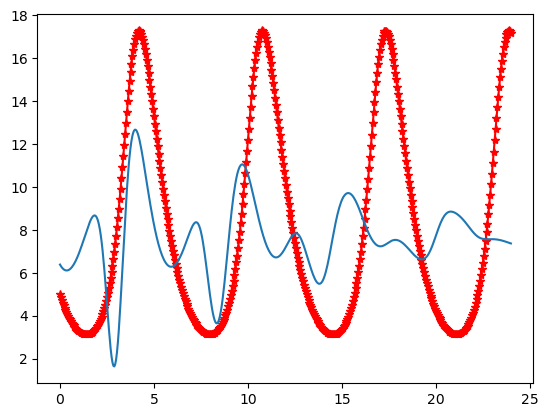

______________________________________________________________________0th iteration_________________________________________________________________
Params start = {'v_params': array([0., 0., 0., 0.])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [ 0.20034218 -0.12467914  1.35122818 -0.00271632]
Recovered v_sigma = 4.41224577124731 


Params start = {'v_params': array([ 0.20034218, -0.12467914,  1.35122818, -0.00271632])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 4.41224577124731}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [ 0.22801686 -0.14455882  1.4515572  -0.00449422]
Recovered v_sigma = 4.230792545075953 


Params start = {'v_params': array([ 0.22801686, -0.14455882,  1.4515572 , -0.00449422])}
Progress: [##############################] 100 of 100 samples
sigma start 

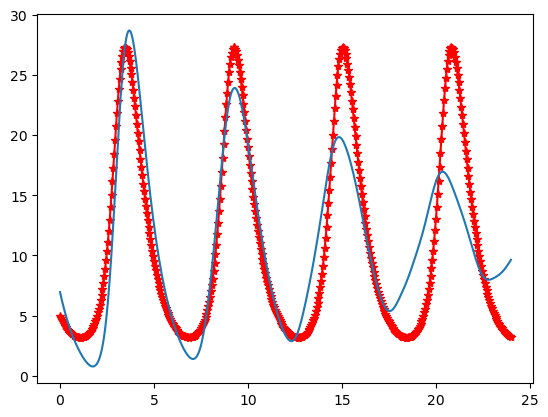

______________________________________________________________________0th iteration_________________________________________________________________
Params start = {'v_params': array([0., 0., 0., 0.])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [-0.16109144 -0.04260271  1.22129484 -0.00287147]
Recovered v_sigma = 4.373893993848149 


Params start = {'v_params': array([-0.16109144, -0.04260271,  1.22129484, -0.00287147])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 4.373893993848149}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [-0.36599791 -0.18261309  1.78746389 -0.0146772 ]
Recovered v_sigma = 3.456082461002838 


Params start = {'v_params': array([-0.36599791, -0.18261309,  1.78746389, -0.0146772 ])}
Progress: [##############################] 100 of 100 samples
sigma star

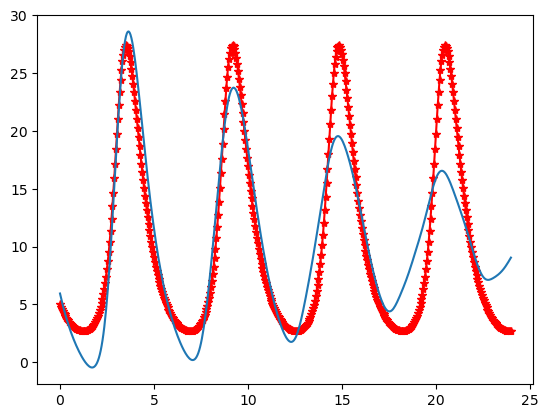

______________________________________________________________________0th iteration_________________________________________________________________
Params start = {'v_params': array([0., 0., 0., 0.])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [-0.16957348 -0.08753337  0.05252281  0.06406552]
Recovered v_sigma = 3.385615914017489 


Params start = {'v_params': array([-0.16957348, -0.08753337,  0.05252281,  0.06406552])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 3.385615914017489}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [-0.08772268 -0.10604947  0.09659819  0.06351044]
Recovered v_sigma = 3.320556741370817 


Params start = {'v_params': array([-0.08772268, -0.10604947,  0.09659819,  0.06351044])}
Progress: [##############################] 100 of 100 samples
sigma star

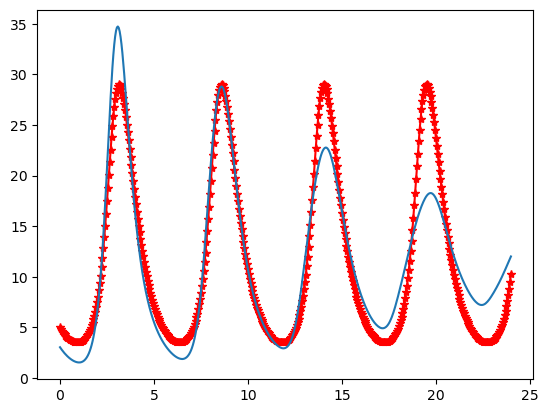

______________________________________________________________________0th iteration_________________________________________________________________
Params start = {'v_params': array([0., 0., 0., 0.])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [-0.04080496 -0.14664258  0.2646317   0.05480243]
Recovered v_sigma = 3.9883421530830208 


Params start = {'v_params': array([-0.04080496, -0.14664258,  0.2646317 ,  0.05480243])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 3.9883421530830208}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [-0.04673635 -0.23667634  0.27714053  0.06196893]
Recovered v_sigma = 3.908759646556782 


Params start = {'v_params': array([-0.04673635, -0.23667634,  0.27714053,  0.06196893])}
Progress: [##############################] 100 of 100 samples
sigma st

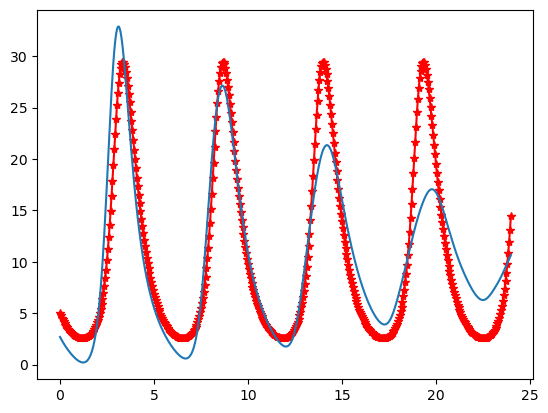

______________________________________________________________________0th iteration_________________________________________________________________
Params start = {'v_params': array([0., 0., 0., 0.])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [-0.05250526  0.13471515  0.15397678  0.03051751]
Recovered v_sigma = 2.3506430352275847 


Params start = {'v_params': array([-0.05250526,  0.13471515,  0.15397678,  0.03051751])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 2.3506430352275847}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [-0.06288817  0.13586128  0.13866958  0.03111419]
Recovered v_sigma = 2.3557544355534654 


Params start = {'v_params': array([-0.06288817,  0.13586128,  0.13866958,  0.03111419])}
Progress: [##############################] 100 of 100 samples
sigma s

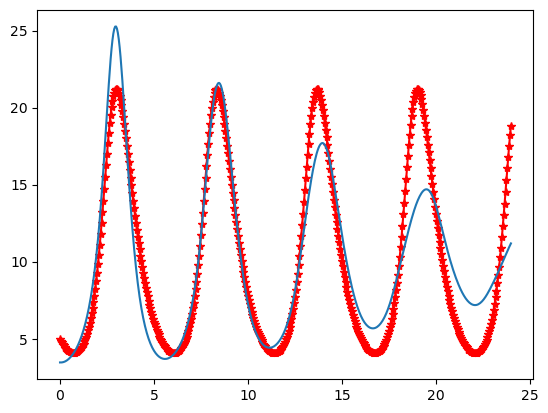

______________________________________________________________________0th iteration_________________________________________________________________
Params start = {'v_params': array([0., 0., 0., 0.])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [-0.49522693 -0.27595464  0.31539326  0.05487536]
Recovered v_sigma = 4.397187273582988 


Params start = {'v_params': array([-0.49522693, -0.27595464,  0.31539326,  0.05487536])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 4.397187273582988}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [-0.45255757 -0.18121719  0.44995909  0.04126024]
Recovered v_sigma = 3.5802946439623087 


Params start = {'v_params': array([-0.45255757, -0.18121719,  0.44995909,  0.04126024])}
Progress: [##############################] 100 of 100 samples
sigma sta

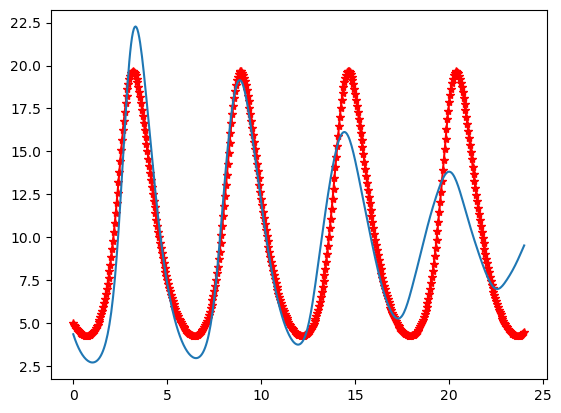

______________________________________________________________________0th iteration_________________________________________________________________
Params start = {'v_params': array([0., 0., 0., 0.])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [ 0.51608351 -0.13403936  0.80038182  0.01054473]
Recovered v_sigma = 2.3693796113375667 


Params start = {'v_params': array([ 0.51608351, -0.13403936,  0.80038182,  0.01054473])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 2.3693796113375667}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [ 0.70680304 -0.06403805  1.16989734 -0.01185234]
Recovered v_sigma = 2.0296407392870046 


Params start = {'v_params': array([ 0.70680304, -0.06403805,  1.16989734, -0.01185234])}
Progress: [##############################] 100 of 100 samples
sigma s

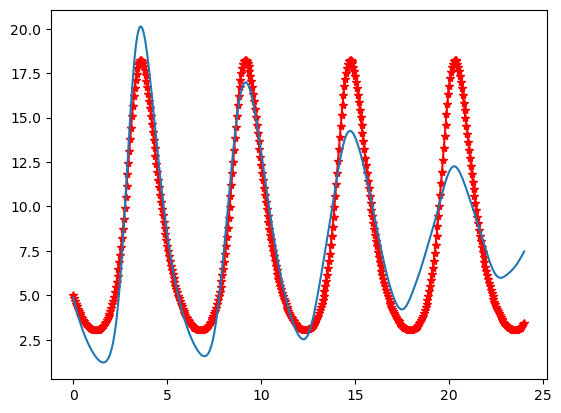

______________________________________________________________________0th iteration_________________________________________________________________
Params start = {'v_params': array([0., 0., 0., 0.])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [-0.70691543 -0.16604694  0.74828972  0.0295986 ]
Recovered v_sigma = 4.64670883142294 


Params start = {'v_params': array([-0.70691543, -0.16604694,  0.74828972,  0.0295986 ])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 4.64670883142294}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [-1.69429287 -0.03936846  1.60617297 -0.01408043]
Recovered v_sigma = 3.271953908353357 


Params start = {'v_params': array([-1.69429287, -0.03936846,  1.60617297, -0.01408043])}
Progress: [##############################] 100 of 100 samples
sigma start 

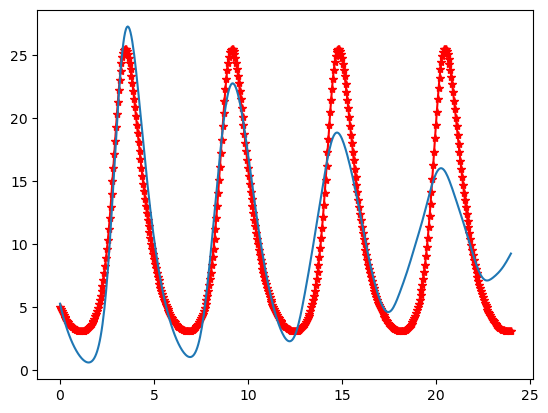

______________________________________________________________________0th iteration_________________________________________________________________
Params start = {'v_params': array([0., 0., 0., 0.])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [ 0.18422607 -0.24509856  0.45422402  0.05519964]
Recovered v_sigma = 4.210734648116058 


Params start = {'v_params': array([ 0.18422607, -0.24509856,  0.45422402,  0.05519964])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 4.210734648116058}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [-0.09118549 -0.255165    0.8337631   0.04103665]
Recovered v_sigma = 3.7557031667133858 


Params start = {'v_params': array([-0.09118549, -0.255165  ,  0.8337631 ,  0.04103665])}
Progress: [##############################] 100 of 100 samples
sigma sta

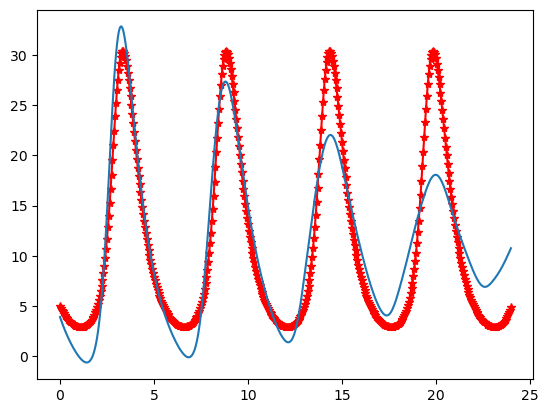

______________________________________________________________________0th iteration_________________________________________________________________
Params start = {'v_params': array([0., 0., 0., 0.])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [-0.02747134 -0.06084597  0.62093661  0.01418424]
Recovered v_sigma = 2.3493592792086475 


Params start = {'v_params': array([-0.02747134, -0.06084597,  0.62093661,  0.01418424])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 2.3493592792086475}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [-0.0314109  -0.08854746  0.82179503  0.00789973]
Recovered v_sigma = 1.9798981391998418 


Params start = {'v_params': array([-0.0314109 , -0.08854746,  0.82179503,  0.00789973])}
Progress: [##############################] 100 of 100 samples
sigma s

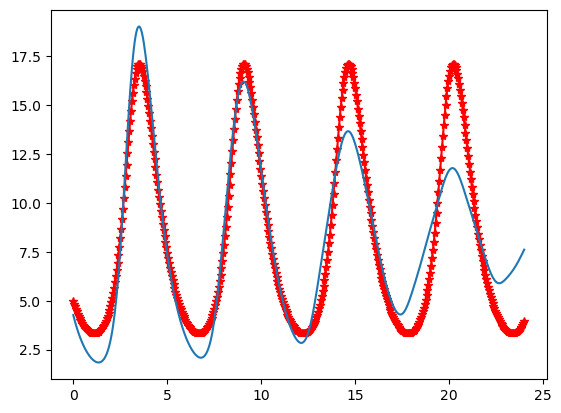

______________________________________________________________________0th iteration_________________________________________________________________
Params start = {'v_params': array([0., 0., 0., 0.])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [ 0.08573907 -0.16556558  0.36955254  0.04832786]
Recovered v_sigma = 5.808047972248756 


Params start = {'v_params': array([ 0.08573907, -0.16556558,  0.36955254,  0.04832786])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 5.808047972248756}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [ 0.17698501 -0.15240068  0.76745082  0.02906418]
Recovered v_sigma = 4.744030352743165 


Params start = {'v_params': array([ 0.17698501, -0.15240068,  0.76745082,  0.02906418])}
Progress: [##############################] 100 of 100 samples
sigma star

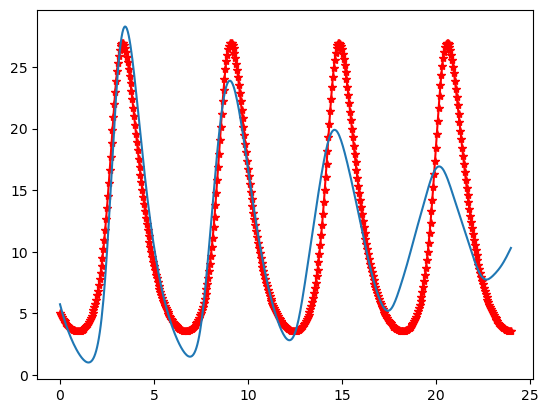

______________________________________________________________________0th iteration_________________________________________________________________
Params start = {'v_params': array([0., 0., 0., 0.])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [-0.15953518  0.33268658 -0.19534877  0.040664  ]
Recovered v_sigma = 7.310099633620992 


Params start = {'v_params': array([-0.15953518,  0.33268658, -0.19534877,  0.040664  ])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 7.310099633620992}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [-0.298665    0.31265643 -0.31246311  0.04792926]
Recovered v_sigma = 7.319186226255073 


Params start = {'v_params': array([-0.298665  ,  0.31265643, -0.31246311,  0.04792926])}
Progress: [##############################] 100 of 100 samples
sigma star

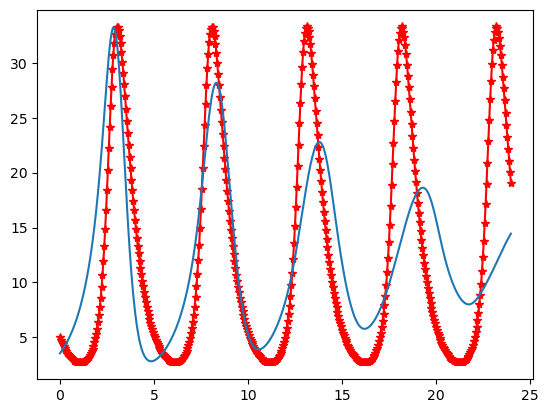

______________________________________________________________________0th iteration_________________________________________________________________
Params start = {'v_params': array([0., 0., 0., 0.])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [-0.09880646  0.01351754  0.60298     0.0156675 ]
Recovered v_sigma = 4.657664874223624 


Params start = {'v_params': array([-0.09880646,  0.01351754,  0.60298   ,  0.0156675 ])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 4.657664874223624}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [-0.20960514  0.03927875  1.38774668 -0.01973034]
Recovered v_sigma = 3.4372799431375025 


Params start = {'v_params': array([-0.20960514,  0.03927875,  1.38774668, -0.01973034])}
Progress: [##############################] 100 of 100 samples
sigma sta

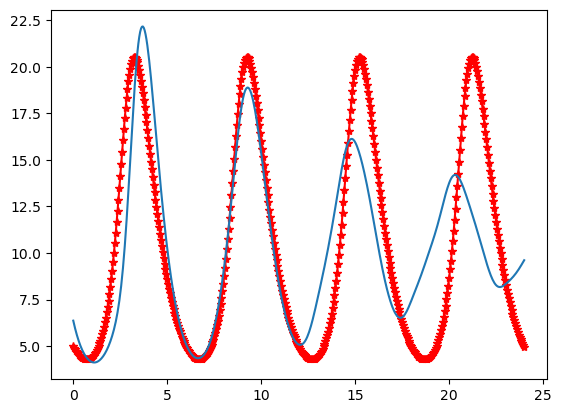

______________________________________________________________________0th iteration_________________________________________________________________
Params start = {'v_params': array([0., 0., 0., 0.])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [-1.58726908  0.04539011  1.01892308 -0.01589894]
Recovered v_sigma = 6.537400845594838 


Params start = {'v_params': array([-1.58726908,  0.04539011,  1.01892308, -0.01589894])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 6.537400845594838}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [-0.38694526  0.22534017  1.83643949 -0.06981988]
Recovered v_sigma = 4.631799504329853 


Params start = {'v_params': array([-0.38694526,  0.22534017,  1.83643949, -0.06981988])}
Progress: [##############################] 100 of 100 samples
sigma star

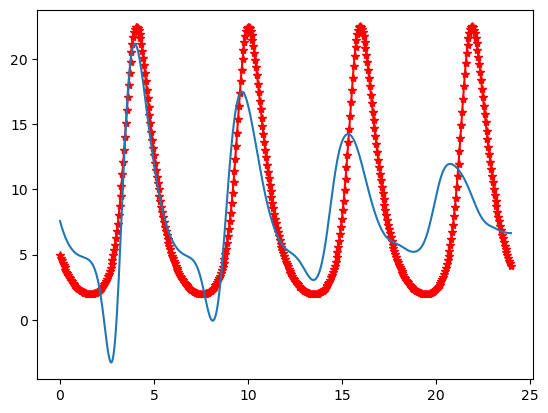

______________________________________________________________________0th iteration_________________________________________________________________
Params start = {'v_params': array([0., 0., 0., 0.])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [0.29820984 0.01262938 0.4928818  0.01119858]
Recovered v_sigma = 3.3480404593768536 


Params start = {'v_params': array([0.29820984, 0.01262938, 0.4928818 , 0.01119858])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 3.3480404593768536}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [ 0.02801152  0.00629985  0.91802511 -0.00530599]
Recovered v_sigma = 2.342669218417606 


Params start = {'v_params': array([ 0.02801152,  0.00629985,  0.91802511, -0.00530599])}
Progress: [##############################] 100 of 100 samples
sigma start = {'

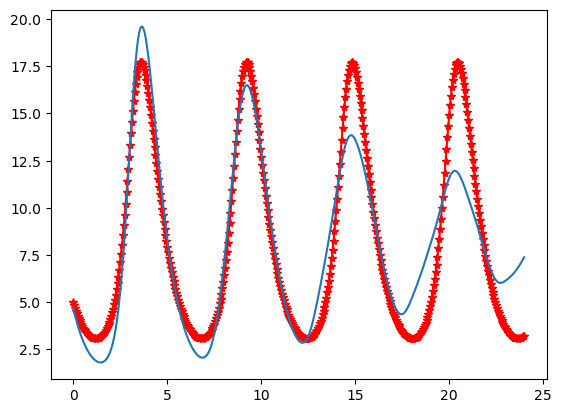

______________________________________________________________________0th iteration_________________________________________________________________
Params start = {'v_params': array([0., 0., 0., 0.])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [0.13787295 0.04645786 0.3419368  0.01731388]
Recovered v_sigma = 5.759606163465105 


Params start = {'v_params': array([0.13787295, 0.04645786, 0.3419368 , 0.01731388])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 5.759606163465105}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [ 0.79536234 -0.0494068   1.00984746 -0.00582322]
Recovered v_sigma = 3.805383614405966 


Params start = {'v_params': array([ 0.79536234, -0.0494068 ,  1.00984746, -0.00582322])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_

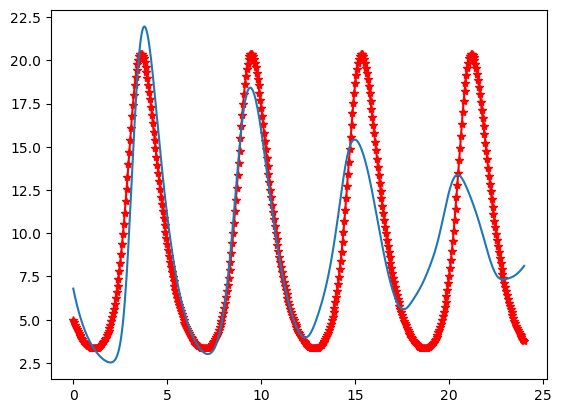

______________________________________________________________________0th iteration_________________________________________________________________
Params start = {'v_params': array([0., 0., 0., 0.])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [ 0.51507525 -0.23702588  0.75028254  0.02096164]
Recovered v_sigma = 3.631168102179095 


Params start = {'v_params': array([ 0.51507525, -0.23702588,  0.75028254,  0.02096164])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 3.631168102179095}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [ 5.85675022e-01 -1.21911462e-01  1.02135444e+00  2.70337264e-04]
Recovered v_sigma = 2.940790510561083 


Params start = {'v_params': array([ 5.85675022e-01, -1.21911462e-01,  1.02135444e+00,  2.70337264e-04])}
Progress: [#############################

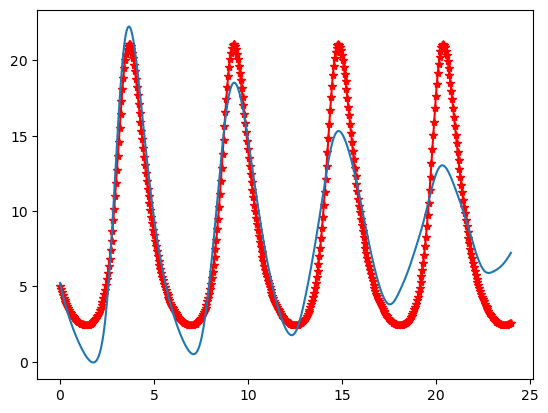

______________________________________________________________________0th iteration_________________________________________________________________
Params start = {'v_params': array([0., 0., 0., 0.])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [-0.86925522  0.27489474 -0.5498732   0.06126755]
Recovered v_sigma = 5.110751913995631 


Params start = {'v_params': array([-0.86925522,  0.27489474, -0.5498732 ,  0.06126755])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 5.110751913995631}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [-0.9182189   0.30890226 -0.39709904  0.05216201]
Recovered v_sigma = 5.054068039442257 


Params start = {'v_params': array([-0.9182189 ,  0.30890226, -0.39709904,  0.05216201])}
Progress: [##############################] 100 of 100 samples
sigma star

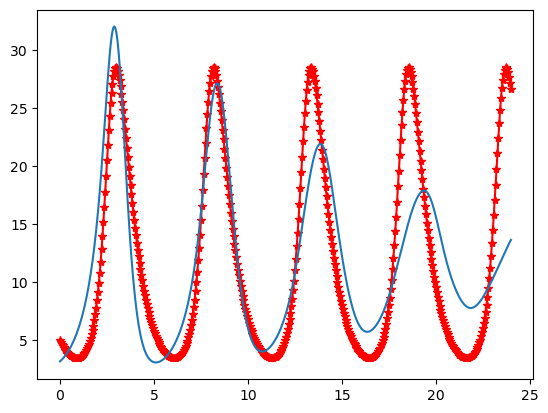

______________________________________________________________________0th iteration_________________________________________________________________
Params start = {'v_params': array([0., 0., 0., 0.])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [0.12094535 0.01167717 0.35989442 0.02525699]
Recovered v_sigma = 2.6682805746655167 


Params start = {'v_params': array([0.12094535, 0.01167717, 0.35989442, 0.02525699])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 2.6682805746655167}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [0.38459828 0.02987195 0.60546197 0.0123026 ]
Recovered v_sigma = 2.1789042638111495 


Params start = {'v_params': array([0.38459828, 0.02987195, 0.60546197, 0.0123026 ])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma

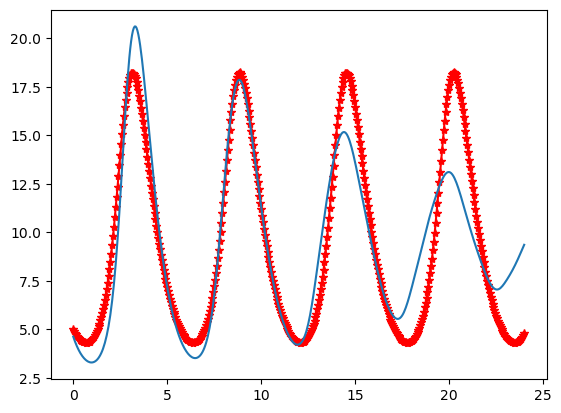

______________________________________________________________________0th iteration_________________________________________________________________
Params start = {'v_params': array([0., 0., 0., 0.])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [-0.07815033 -0.28485988  0.19051654  0.05682846]
Recovered v_sigma = 6.174076800573627 


Params start = {'v_params': array([-0.07815033, -0.28485988,  0.19051654,  0.05682846])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 6.174076800573627}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [ 0.13887773 -0.23313893  0.5735222   0.03594576]
Recovered v_sigma = 4.846968349299566 


Params start = {'v_params': array([ 0.13887773, -0.23313893,  0.5735222 ,  0.03594576])}
Progress: [##############################] 100 of 100 samples
sigma star

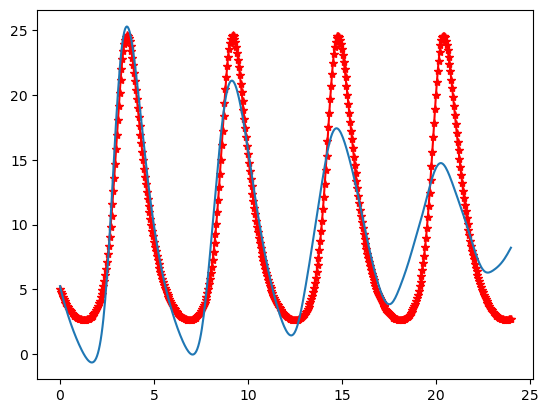

______________________________________________________________________0th iteration_________________________________________________________________
Params start = {'v_params': array([0., 0., 0., 0.])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [0.16238485 0.04328167 0.12415437 0.03356206]
Recovered v_sigma = 2.7514711111565786 


Params start = {'v_params': array([0.16238485, 0.04328167, 0.12415437, 0.03356206])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 2.7514711111565786}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [0.16600222 0.04562391 0.13610564 0.03284329]
Recovered v_sigma = 2.734032160241948 


Params start = {'v_params': array([0.16600222, 0.04562391, 0.13610564, 0.03284329])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma'

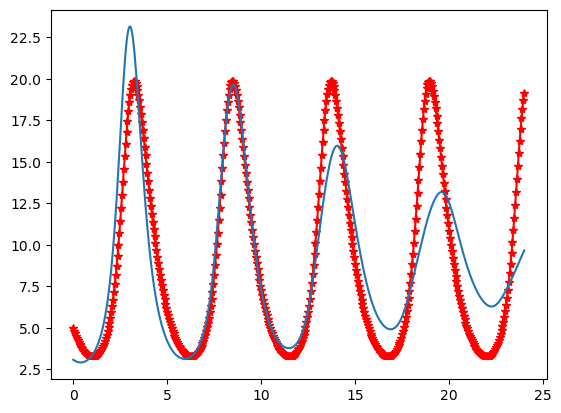

______________________________________________________________________0th iteration_________________________________________________________________
Params start = {'v_params': array([0., 0., 0., 0.])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [ 0.23151264  0.37799702  1.31251937 -0.05678893]
Recovered v_sigma = 5.613169868912712 


Params start = {'v_params': array([ 0.23151264,  0.37799702,  1.31251937, -0.05678893])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 5.613169868912712}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [ 0.42938366  0.32084209  1.33774449 -0.05354547]
Recovered v_sigma = 5.5510909739090835 


Params start = {'v_params': array([ 0.42938366,  0.32084209,  1.33774449, -0.05354547])}
Progress: [##############################] 100 of 100 samples
sigma sta

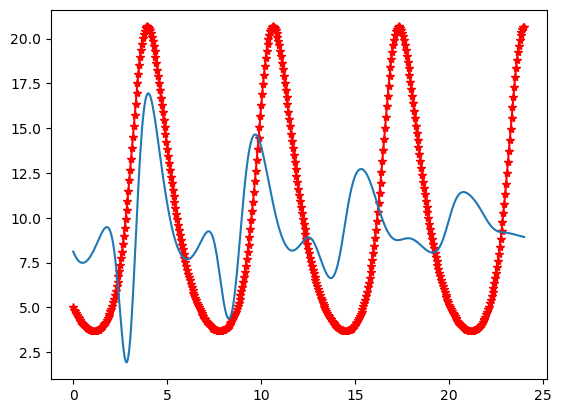

______________________________________________________________________0th iteration_________________________________________________________________
Params start = {'v_params': array([0., 0., 0., 0.])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [ 0.66104912 -0.1916693   0.15139779  0.06577196]
Recovered v_sigma = 3.290829720843438 


Params start = {'v_params': array([ 0.66104912, -0.1916693 ,  0.15139779,  0.06577196])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 3.290829720843438}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [ 0.51100645 -0.16693328  0.31319971  0.05731563]
Recovered v_sigma = 3.168188775528677 


Params start = {'v_params': array([ 0.51100645, -0.16693328,  0.31319971,  0.05731563])}
Progress: [##############################] 100 of 100 samples
sigma star

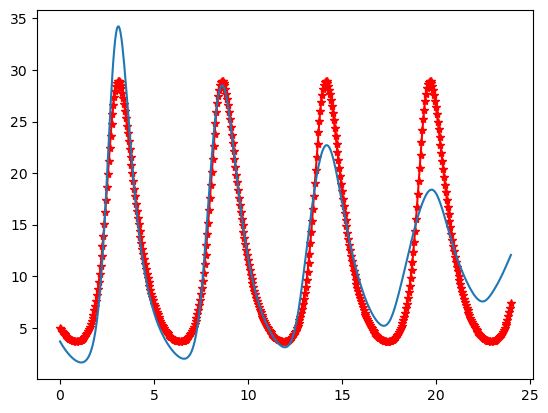

______________________________________________________________________0th iteration_________________________________________________________________
Params start = {'v_params': array([0., 0., 0., 0.])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [-0.52589465 -0.33290082  0.92830473  0.03229394]
Recovered v_sigma = 4.07320496417178 


Params start = {'v_params': array([-0.52589465, -0.33290082,  0.92830473,  0.03229394])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 4.07320496417178}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [-0.47849731 -0.30463963  1.01003435  0.0261988 ]
Recovered v_sigma = 3.9525846388157957 


Params start = {'v_params': array([-0.47849731, -0.30463963,  1.01003435,  0.0261988 ])}
Progress: [##############################] 100 of 100 samples
sigma start

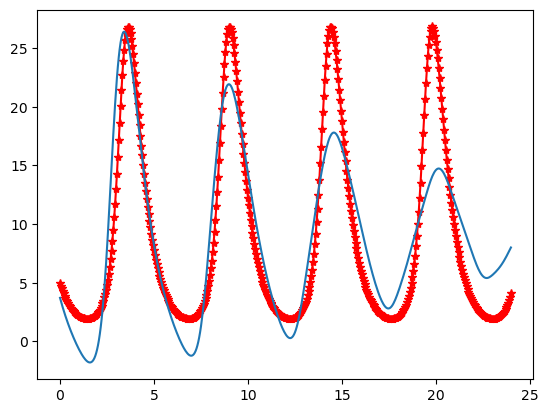

______________________________________________________________________0th iteration_________________________________________________________________
Params start = {'v_params': array([0., 0., 0., 0.])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [-0.10944844  0.04453411 -0.03808974  0.05509821]
Recovered v_sigma = 3.368552827840941 


Params start = {'v_params': array([-0.10944844,  0.04453411, -0.03808974,  0.05509821])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 3.368552827840941}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [-0.13344976  0.04820113 -0.03524951  0.0548381 ]
Recovered v_sigma = 3.3834222797615467 


Params start = {'v_params': array([-0.13344976,  0.04820113, -0.03524951,  0.0548381 ])}
Progress: [##############################] 100 of 100 samples
sigma sta

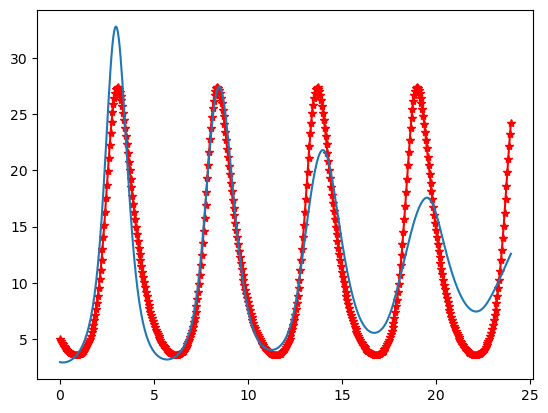

______________________________________________________________________0th iteration_________________________________________________________________
Params start = {'v_params': array([0., 0., 0., 0.])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [-1.05776319 -0.15067672  0.80984783  0.02803806]
Recovered v_sigma = 6.101926164472023 


Params start = {'v_params': array([-1.05776319, -0.15067672,  0.80984783,  0.02803806])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 6.101926164472023}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [-1.14975489 -0.01162871  1.25471614 -0.00202198]
Recovered v_sigma = 4.991511415522089 


Params start = {'v_params': array([-1.14975489, -0.01162871,  1.25471614, -0.00202198])}
Progress: [##############################] 100 of 100 samples
sigma star

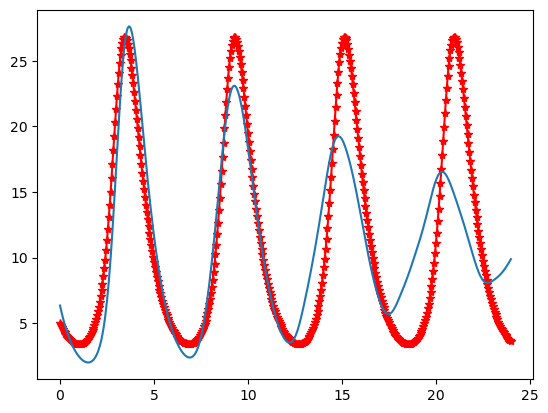

______________________________________________________________________0th iteration_________________________________________________________________
Params start = {'v_params': array([0., 0., 0., 0.])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [ 1.30110476  0.19612049  1.34005093 -0.05121621]
Recovered v_sigma = 3.4883554263484973 


Params start = {'v_params': array([ 1.30110476,  0.19612049,  1.34005093, -0.05121621])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 3.4883554263484973}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [ 1.305773    0.17155376  1.35431351 -0.04945246]
Recovered v_sigma = 3.5128750047020407 


Params start = {'v_params': array([ 1.305773  ,  0.17155376,  1.35431351, -0.04945246])}
Progress: [##############################] 100 of 100 samples
sigma s

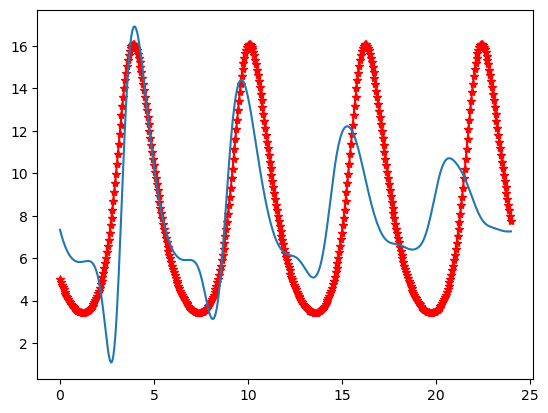

______________________________________________________________________0th iteration_________________________________________________________________
Params start = {'v_params': array([0., 0., 0., 0.])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [ 0.27283308  0.16968186 -0.04186595  0.04635732]
Recovered v_sigma = 7.53168414207553 


Params start = {'v_params': array([ 0.27283308,  0.16968186, -0.04186595,  0.04635732])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 7.53168414207553}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [ 0.23389598  0.26279023 -0.10982886  0.04146922]
Recovered v_sigma = 7.538237338521668 


Params start = {'v_params': array([ 0.23389598,  0.26279023, -0.10982886,  0.04146922])}
Progress: [##############################] 100 of 100 samples
sigma start 

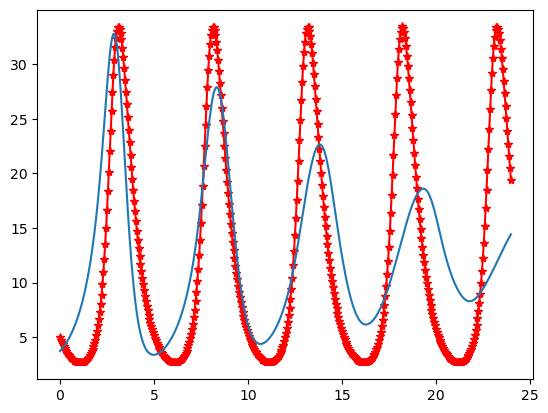

______________________________________________________________________0th iteration_________________________________________________________________
Params start = {'v_params': array([0., 0., 0., 0.])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [ 0.32190327  0.07551263  0.79277959 -0.00388629]
Recovered v_sigma = 6.920793269967456 


Params start = {'v_params': array([ 0.32190327,  0.07551263,  0.79277959, -0.00388629])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 6.920793269967456}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [ 0.34028302  0.22809345  1.48119472 -0.04605538]
Recovered v_sigma = 5.701536140848749 


Params start = {'v_params': array([ 0.34028302,  0.22809345,  1.48119472, -0.04605538])}
Progress: [##############################] 100 of 100 samples
sigma star

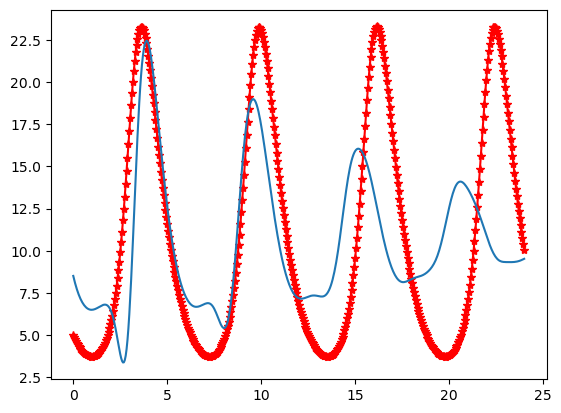

______________________________________________________________________0th iteration_________________________________________________________________
Params start = {'v_params': array([0., 0., 0., 0.])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [ 0.0379294  -0.14087263  0.35485202  0.05423592]
Recovered v_sigma = 3.5819633376795177 


Params start = {'v_params': array([ 0.0379294 , -0.14087263,  0.35485202,  0.05423592])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 3.5819633376795177}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [ 0.0253872  -0.14651701  0.45281095  0.05028122]
Recovered v_sigma = 3.4435660855226984 


Params start = {'v_params': array([ 0.0253872 , -0.14651701,  0.45281095,  0.05028122])}
Progress: [##############################] 100 of 100 samples
sigma s

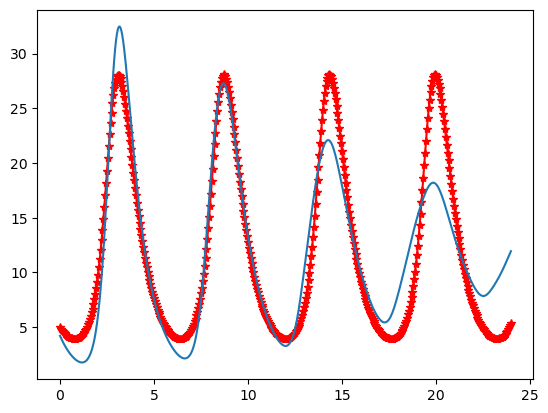

______________________________________________________________________0th iteration_________________________________________________________________
Params start = {'v_params': array([0., 0., 0., 0.])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [-0.05168161 -0.05918845  0.79312601  0.01769066]
Recovered v_sigma = 4.370193941079673 


Params start = {'v_params': array([-0.05168161, -0.05918845,  0.79312601,  0.01769066])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 4.370193941079673}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [-0.06038174 -0.19970269  0.92294116  0.02389185]
Recovered v_sigma = 3.908336163978062 


Params start = {'v_params': array([-0.06038174, -0.19970269,  0.92294116,  0.02389185])}
Progress: [##############################] 100 of 100 samples
sigma star

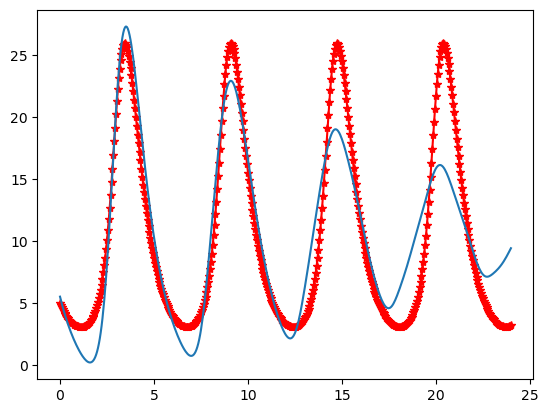

______________________________________________________________________0th iteration_________________________________________________________________
Params start = {'v_params': array([0., 0., 0., 0.])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [-1.29474668  0.41017622  1.99167314 -0.08074508]
Recovered v_sigma = 4.219192869159047 


Params start = {'v_params': array([-1.29474668,  0.41017622,  1.99167314, -0.08074508])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 4.219192869159047}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [-1.74727338  0.10041333  1.88175422 -0.04852277]
Recovered v_sigma = 3.0179018546463556 


Params start = {'v_params': array([-1.74727338,  0.10041333,  1.88175422, -0.04852277])}
Progress: [##############################] 100 of 100 samples
sigma sta

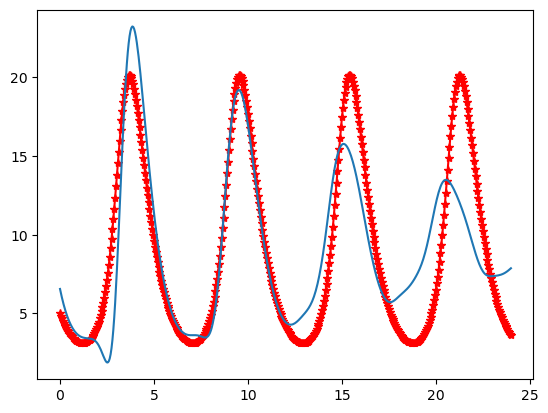

______________________________________________________________________0th iteration_________________________________________________________________
Params start = {'v_params': array([0., 0., 0., 0.])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [ 0.00886759 -0.00788656  0.12391456  0.03983829]
Recovered v_sigma = 4.083703981672188 


Params start = {'v_params': array([ 0.00886759, -0.00788656,  0.12391456,  0.03983829])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 4.083703981672188}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [-0.02159311 -0.01266958  0.21391025  0.03660924]
Recovered v_sigma = 4.120378647929701 


Params start = {'v_params': array([-0.02159311, -0.01266958,  0.21391025,  0.03660924])}
Progress: [##############################] 100 of 100 samples
sigma star

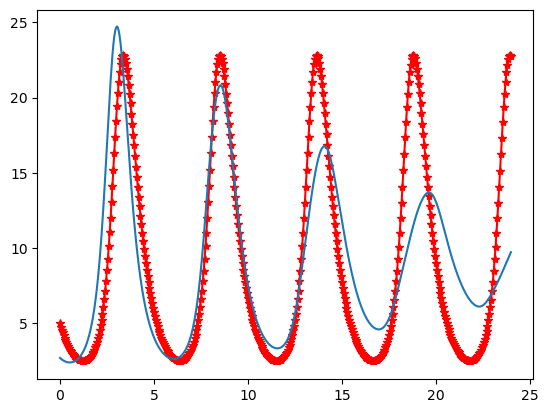

______________________________________________________________________0th iteration_________________________________________________________________
Params start = {'v_params': array([0., 0., 0., 0.])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [-0.02375062 -0.24428905  1.19882396  0.00823602]
Recovered v_sigma = 3.487591562530107 


Params start = {'v_params': array([-0.02375062, -0.24428905,  1.19882396,  0.00823602])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 3.487591562530107}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [-0.11542685 -0.25517372  1.21979722  0.00856277]
Recovered v_sigma = 3.4749348885532902 


Params start = {'v_params': array([-0.11542685, -0.25517372,  1.21979722,  0.00856277])}
Progress: [##############################] 100 of 100 samples
sigma sta

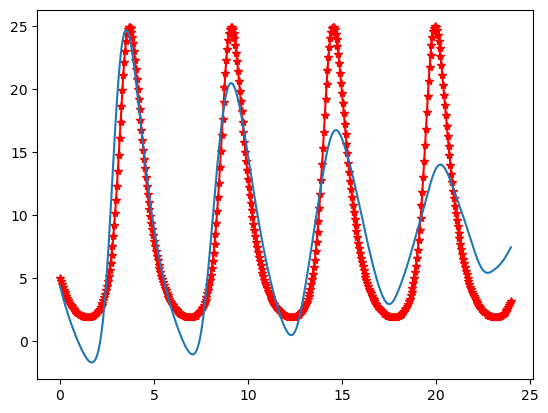

______________________________________________________________________0th iteration_________________________________________________________________
Params start = {'v_params': array([0., 0., 0., 0.])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [ 0.41004096  0.10413513 -0.23442001  0.05375641]
Recovered v_sigma = 3.137206027354408 


Params start = {'v_params': array([ 0.41004096,  0.10413513, -0.23442001,  0.05375641])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 3.137206027354408}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [ 0.44450747  0.05320738 -0.11391772  0.05271832]
Recovered v_sigma = 3.106519558317465 


Params start = {'v_params': array([ 0.44450747,  0.05320738, -0.11391772,  0.05271832])}
Progress: [##############################] 100 of 100 samples
sigma star

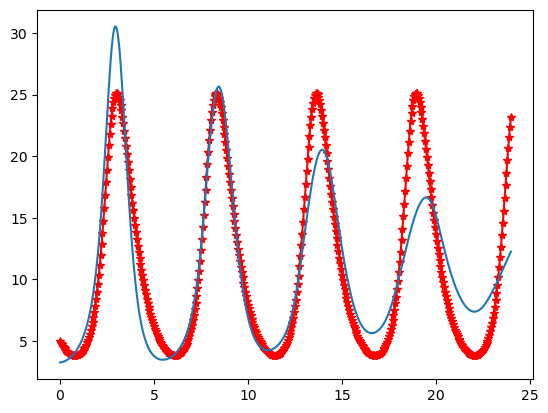

______________________________________________________________________0th iteration_________________________________________________________________
Params start = {'v_params': array([0., 0., 0., 0.])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [ 0.85485334  0.27633645 -0.10596252  0.04453322]
Recovered v_sigma = 5.906516994050429 


Params start = {'v_params': array([ 0.85485334,  0.27633645, -0.10596252,  0.04453322])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 5.906516994050429}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [ 0.8686965   0.28813308 -0.19547834  0.04714724]
Recovered v_sigma = 5.794246212566633 


Params start = {'v_params': array([ 0.8686965 ,  0.28813308, -0.19547834,  0.04714724])}
Progress: [##############################] 100 of 100 samples
sigma star

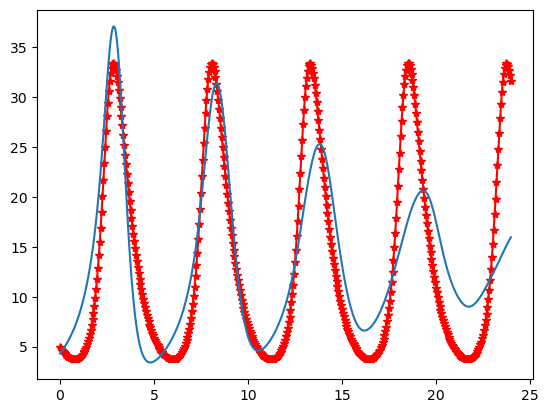

______________________________________________________________________0th iteration_________________________________________________________________
Params start = {'v_params': array([0., 0., 0., 0.])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [-0.0728918   0.38034022 -0.07320433  0.01941844]
Recovered v_sigma = 5.3528564631382505 


Params start = {'v_params': array([-0.0728918 ,  0.38034022, -0.07320433,  0.01941844])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 5.3528564631382505}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [ 0.0132292   0.4112554  -0.15592091  0.02020147]
Recovered v_sigma = 5.291177782835156 


Params start = {'v_params': array([ 0.0132292 ,  0.4112554 , -0.15592091,  0.02020147])}
Progress: [##############################] 100 of 100 samples
sigma st

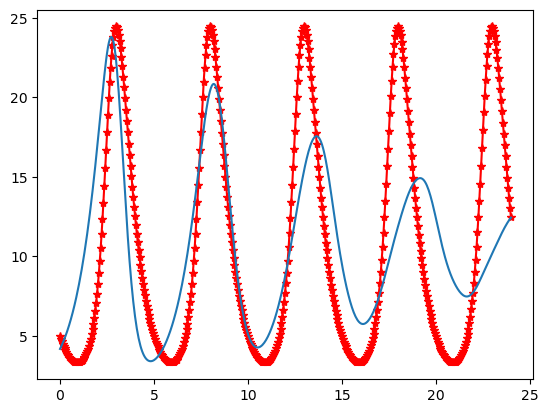

______________________________________________________________________0th iteration_________________________________________________________________
Params start = {'v_params': array([0., 0., 0., 0.])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [-0.2395768   0.07227383  0.39788451  0.00570289]
Recovered v_sigma = 5.575363369846628 


Params start = {'v_params': array([-0.2395768 ,  0.07227383,  0.39788451,  0.00570289])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 5.575363369846628}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [-0.07608003  0.06698484  0.92026559 -0.01710815]
Recovered v_sigma = 4.034924681423436 


Params start = {'v_params': array([-0.07608003,  0.06698484,  0.92026559, -0.01710815])}
Progress: [##############################] 100 of 100 samples
sigma star

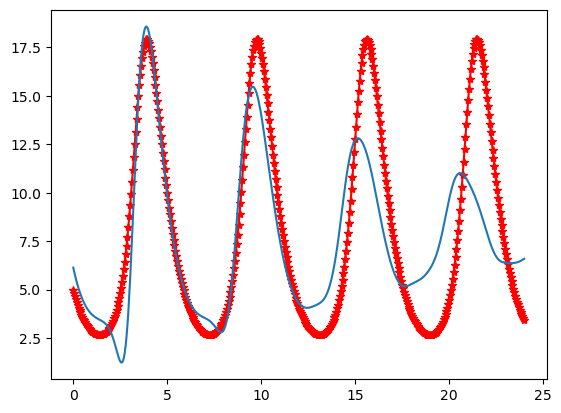

______________________________________________________________________0th iteration_________________________________________________________________
Params start = {'v_params': array([0., 0., 0., 0.])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [ 0.02410191 -0.03828762  0.27396419  0.02930946]
Recovered v_sigma = 2.9912954842243202 


Params start = {'v_params': array([ 0.02410191, -0.03828762,  0.27396419,  0.02930946])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 2.9912954842243202}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [ 0.07583806 -0.11893886  0.52741494  0.0248606 ]
Recovered v_sigma = 2.360783749818575 


Params start = {'v_params': array([ 0.07583806, -0.11893886,  0.52741494,  0.0248606 ])}
Progress: [##############################] 100 of 100 samples
sigma st

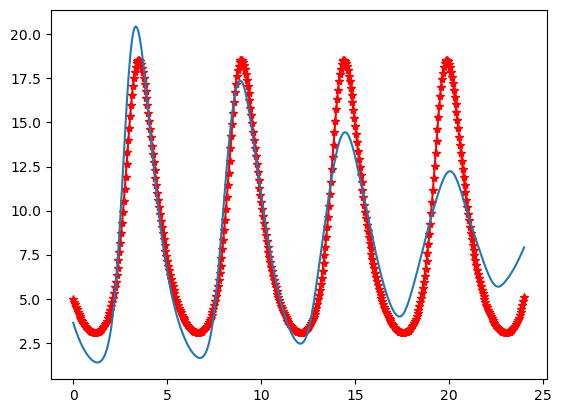

______________________________________________________________________0th iteration_________________________________________________________________
Params start = {'v_params': array([0., 0., 0., 0.])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [ 0.0988038   0.29877029  1.18163278 -0.04967006]
Recovered v_sigma = 5.488348119950486 


Params start = {'v_params': array([ 0.0988038 ,  0.29877029,  1.18163278, -0.04967006])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 5.488348119950486}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [ 0.62266698  0.12821164  1.63260362 -0.05671106]
Recovered v_sigma = 4.924436830702592 


Params start = {'v_params': array([ 0.62266698,  0.12821164,  1.63260362, -0.05671106])}
Progress: [##############################] 100 of 100 samples
sigma star

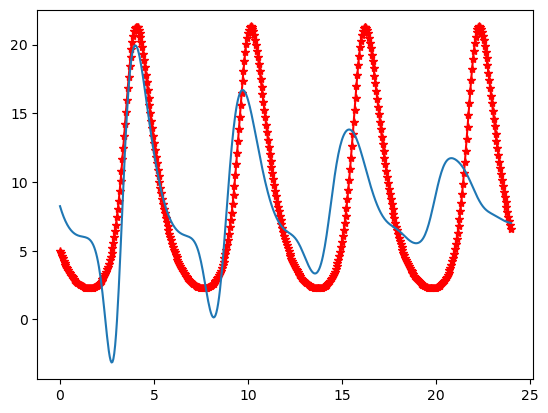

______________________________________________________________________0th iteration_________________________________________________________________
Params start = {'v_params': array([0., 0., 0., 0.])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [-0.07952558 -0.00913355  0.17707741  0.03550035]
Recovered v_sigma = 2.564785208560169 


Params start = {'v_params': array([-0.07952558, -0.00913355,  0.17707741,  0.03550035])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 2.564785208560169}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [-0.0006595  -0.00407757  0.23904384  0.03211773]
Recovered v_sigma = 2.5329929182116926 


Params start = {'v_params': array([-0.0006595 , -0.00407757,  0.23904384,  0.03211773])}
Progress: [##############################] 100 of 100 samples
sigma sta

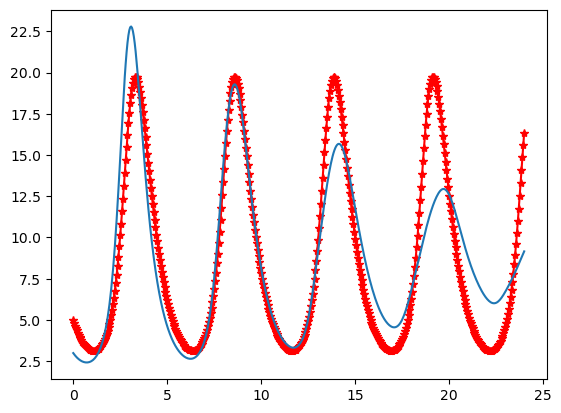

______________________________________________________________________0th iteration_________________________________________________________________
Params start = {'v_params': array([0., 0., 0., 0.])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [-0.17933233 -0.04277898 -0.36019534  0.07487218]
Recovered v_sigma = 4.465417980486574 


Params start = {'v_params': array([-0.17933233, -0.04277898, -0.36019534,  0.07487218])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 4.465417980486574}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [-0.19429515 -0.0836224  -0.10131953  0.06674575]
Recovered v_sigma = 3.7286698020629245 


Params start = {'v_params': array([-0.19429515, -0.0836224 , -0.10131953,  0.06674575])}
Progress: [##############################] 100 of 100 samples
sigma sta

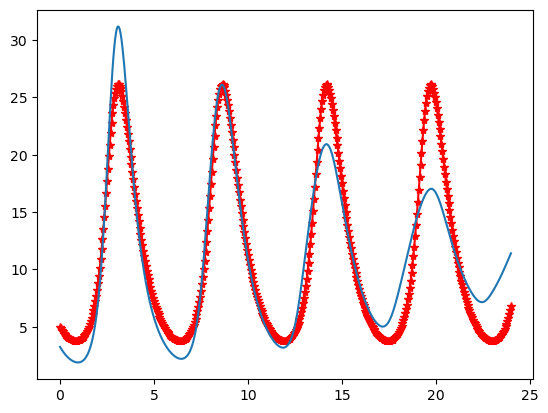

______________________________________________________________________0th iteration_________________________________________________________________
Params start = {'v_params': array([0., 0., 0., 0.])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [-0.11669771 -0.11554887  0.30169939  0.04201105]
Recovered v_sigma = 2.811585905518557 


Params start = {'v_params': array([-0.11669771, -0.11554887,  0.30169939,  0.04201105])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 2.811585905518557}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [-0.11044334 -0.09923699  0.2946492   0.04094014]
Recovered v_sigma = 2.792704110135374 


Params start = {'v_params': array([-0.11044334, -0.09923699,  0.2946492 ,  0.04094014])}
Progress: [##############################] 100 of 100 samples
sigma star

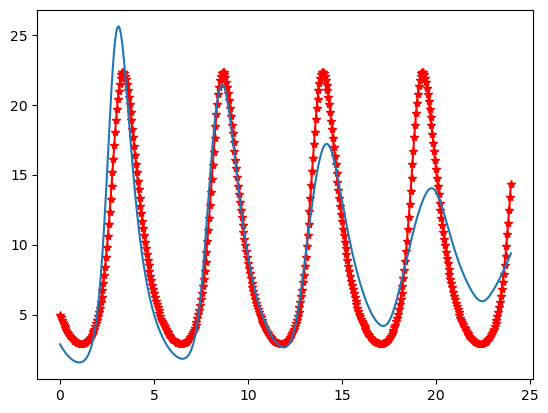

______________________________________________________________________0th iteration_________________________________________________________________
Params start = {'v_params': array([0., 0., 0., 0.])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [ 0.11794298 -0.0402328   0.15464844  0.04133581]
Recovered v_sigma = 3.7734498012137476 


Params start = {'v_params': array([ 0.11794298, -0.0402328 ,  0.15464844,  0.04133581])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 3.7734498012137476}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [ 0.20136275 -0.04760031  0.19072619  0.04022135]
Recovered v_sigma = 3.727244574103902 


Params start = {'v_params': array([ 0.20136275, -0.04760031,  0.19072619,  0.04022135])}
Progress: [##############################] 100 of 100 samples
sigma st

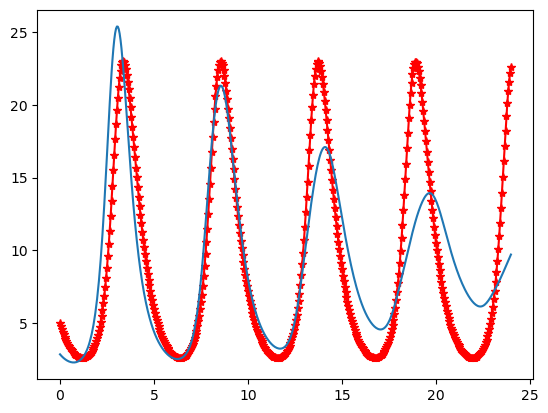

______________________________________________________________________0th iteration_________________________________________________________________
Params start = {'v_params': array([0., 0., 0., 0.])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [0.20243326 0.04267929 0.13133322 0.01845478]
Recovered v_sigma = 5.695011785167512 


Params start = {'v_params': array([0.20243326, 0.04267929, 0.13133322, 0.01845478])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 5.695011785167512}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [0.28455671 0.09912359 0.33494781 0.00418842]
Recovered v_sigma = 4.971935429284358 


Params start = {'v_params': array([0.28455671, 0.09912359, 0.33494781, 0.00418842])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 

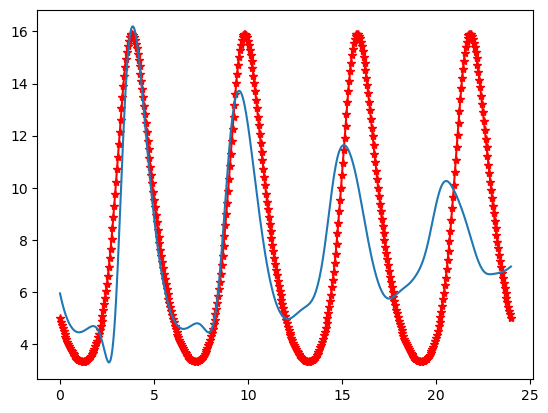

______________________________________________________________________0th iteration_________________________________________________________________
Params start = {'v_params': array([0., 0., 0., 0.])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [ 0.07322045  0.27550451  0.34006731 -0.01432607]
Recovered v_sigma = 5.182124984095534 


Params start = {'v_params': array([ 0.07322045,  0.27550451,  0.34006731, -0.01432607])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 5.182124984095534}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [ 0.04826562  0.35270934  0.81251982 -0.04056009]
Recovered v_sigma = 4.371925536344325 


Params start = {'v_params': array([ 0.04826562,  0.35270934,  0.81251982, -0.04056009])}
Progress: [##############################] 100 of 100 samples
sigma star

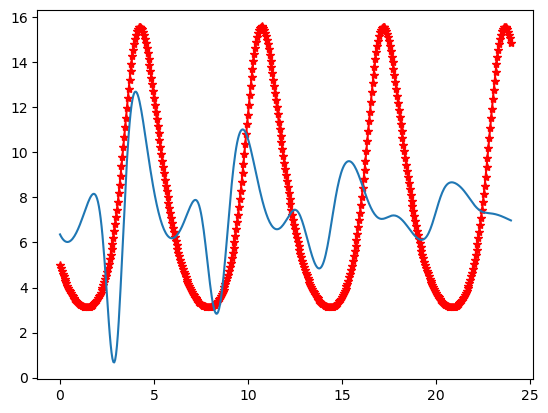

______________________________________________________________________0th iteration_________________________________________________________________
Params start = {'v_params': array([0., 0., 0., 0.])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [-0.10831134 -0.08243244 -0.0762257   0.07041426]
Recovered v_sigma = 5.951891875111055 


Params start = {'v_params': array([-0.10831134, -0.08243244, -0.0762257 ,  0.07041426])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 5.951891875111055}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [ 0.2515267  -0.24433201  0.76584333  0.04697235]
Recovered v_sigma = 4.00528024318705 


Params start = {'v_params': array([ 0.2515267 , -0.24433201,  0.76584333,  0.04697235])}
Progress: [##############################] 100 of 100 samples
sigma start

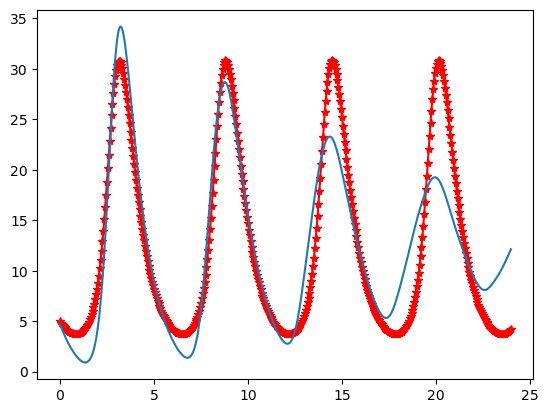

______________________________________________________________________0th iteration_________________________________________________________________
Params start = {'v_params': array([0., 0., 0., 0.])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [-0.5829689   0.34795034  1.86243169 -0.08167516]
Recovered v_sigma = 3.523947803749692 


Params start = {'v_params': array([-0.5829689 ,  0.34795034,  1.86243169, -0.08167516])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 3.523947803749692}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [-0.91636936  0.26414794  1.43543225 -0.05497295]
Recovered v_sigma = 2.5496331341929395 


Params start = {'v_params': array([-0.91636936,  0.26414794,  1.43543225, -0.05497295])}
Progress: [##############################] 100 of 100 samples
sigma sta

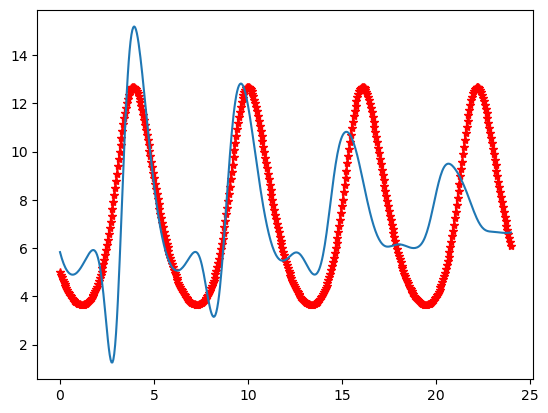

______________________________________________________________________0th iteration_________________________________________________________________
Params start = {'v_params': array([0., 0., 0., 0.])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [ 0.00717314 -0.05077364  0.0218803   0.05873928]
Recovered v_sigma = 3.2365137050823125 


Params start = {'v_params': array([ 0.00717314, -0.05077364,  0.0218803 ,  0.05873928])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 3.2365137050823125}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [ 0.04423991 -0.06692054  0.12844968  0.05539125]
Recovered v_sigma = 3.1704826981133367 


Params start = {'v_params': array([ 0.04423991, -0.06692054,  0.12844968,  0.05539125])}
Progress: [##############################] 100 of 100 samples
sigma s

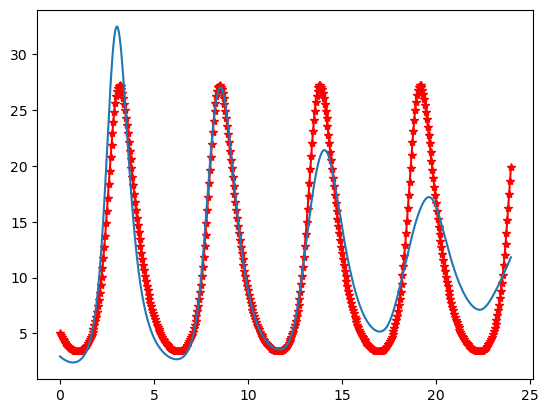

______________________________________________________________________0th iteration_________________________________________________________________
Params start = {'v_params': array([0., 0., 0., 0.])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [-0.10254208  0.29012025 -0.18554041  0.03087813]
Recovered v_sigma = 5.150042625514028 


Params start = {'v_params': array([-0.10254208,  0.29012025, -0.18554041,  0.03087813])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 5.150042625514028}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [-0.10190162  0.35804732 -0.16824325  0.02440348]
Recovered v_sigma = 5.1128064373039415 


Params start = {'v_params': array([-0.10190162,  0.35804732, -0.16824325,  0.02440348])}
Progress: [##############################] 100 of 100 samples
sigma sta

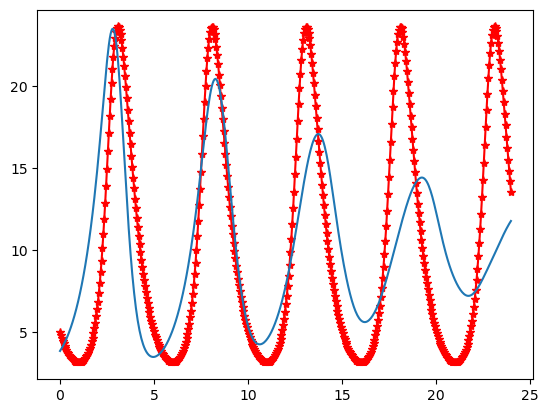

______________________________________________________________________0th iteration_________________________________________________________________
Params start = {'v_params': array([0., 0., 0., 0.])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [ 0.46249107 -0.11007541  0.42499618  0.03037061]
Recovered v_sigma = 4.05290875940559 


Params start = {'v_params': array([ 0.46249107, -0.11007541,  0.42499618,  0.03037061])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 4.05290875940559}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [ 0.17792911 -0.18118005  0.7213685   0.02457237]
Recovered v_sigma = 3.268526892819397 


Params start = {'v_params': array([ 0.17792911, -0.18118005,  0.7213685 ,  0.02457237])}
Progress: [##############################] 100 of 100 samples
sigma start 

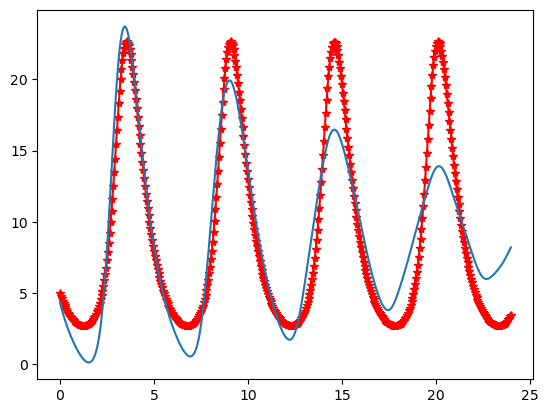

______________________________________________________________________0th iteration_________________________________________________________________
Params start = {'v_params': array([0., 0., 0., 0.])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [-0.13536583  0.01540934  0.0477339   0.03473906]
Recovered v_sigma = 3.0595966165460284 


Params start = {'v_params': array([-0.13536583,  0.01540934,  0.0477339 ,  0.03473906])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 3.0595966165460284}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [-0.14230254 -0.05388953  0.14156371  0.03651952]
Recovered v_sigma = 2.7354010457999336 


Params start = {'v_params': array([-0.14230254, -0.05388953,  0.14156371,  0.03651952])}
Progress: [##############################] 100 of 100 samples
sigma s

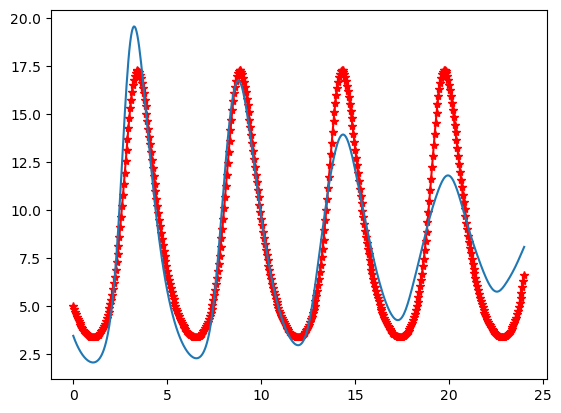

______________________________________________________________________0th iteration_________________________________________________________________
Params start = {'v_params': array([0., 0., 0., 0.])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [ 0.0207248  -0.14781286  0.33889703  0.04565078]
Recovered v_sigma = 3.820989032274468 


Params start = {'v_params': array([ 0.0207248 , -0.14781286,  0.33889703,  0.04565078])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 3.820989032274468}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [ 0.10517467 -0.05863524  0.57797416  0.02740207]
Recovered v_sigma = 3.4115362219643703 


Params start = {'v_params': array([ 0.10517467, -0.05863524,  0.57797416,  0.02740207])}
Progress: [##############################] 100 of 100 samples
sigma sta

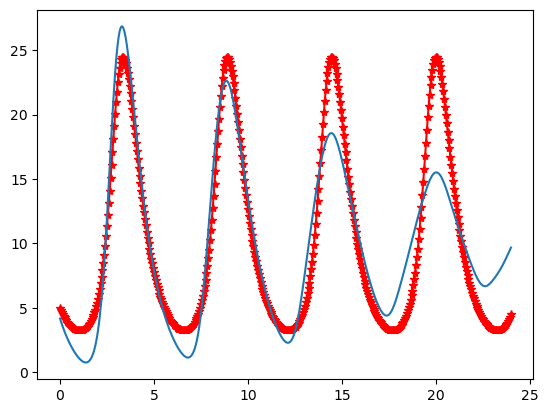

______________________________________________________________________0th iteration_________________________________________________________________
Params start = {'v_params': array([0., 0., 0., 0.])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [ 1.19892841 -0.0902855   1.95461237 -0.04449225]
Recovered v_sigma = 4.275827108887159 


Params start = {'v_params': array([ 1.19892841, -0.0902855 ,  1.95461237, -0.04449225])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 4.275827108887159}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [ 1.18029258 -0.07447592  1.98995377 -0.04701023]
Recovered v_sigma = 4.212242538648542 


Params start = {'v_params': array([ 1.18029258, -0.07447592,  1.98995377, -0.04701023])}
Progress: [##############################] 100 of 100 samples
sigma star

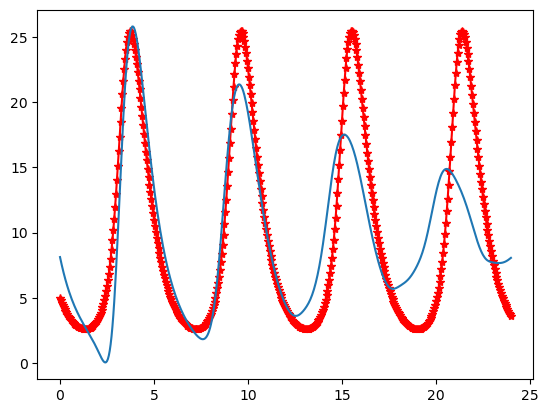

______________________________________________________________________0th iteration_________________________________________________________________
Params start = {'v_params': array([0., 0., 0., 0.])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [ 0.06843956 -0.08536144  0.98916646  0.0047073 ]
Recovered v_sigma = 2.0229590020681663 


Params start = {'v_params': array([ 0.06843956, -0.08536144,  0.98916646,  0.0047073 ])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 2.0229590020681663}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [ 0.16700544 -0.08644549  0.9339787   0.00687065]
Recovered v_sigma = 2.015111908167571 


Params start = {'v_params': array([ 0.16700544, -0.08644549,  0.9339787 ,  0.00687065])}
Progress: [##############################] 100 of 100 samples
sigma st

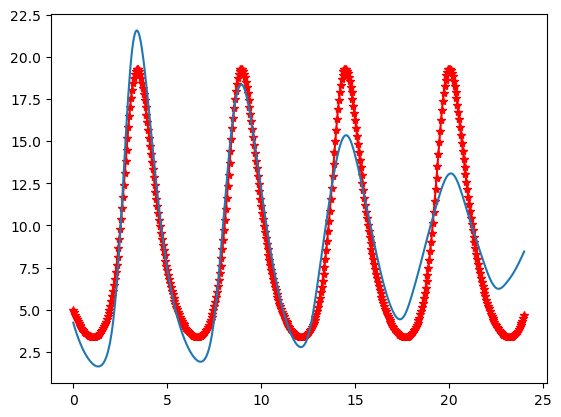

______________________________________________________________________0th iteration_________________________________________________________________
Params start = {'v_params': array([0., 0., 0., 0.])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [ 0.32592906 -0.15729686  0.62206694  0.03739137]
Recovered v_sigma = 3.280786106357865 


Params start = {'v_params': array([ 0.32592906, -0.15729686,  0.62206694,  0.03739137])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 3.280786106357865}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [ 0.35971601 -0.17459004  0.55965443  0.0413758 ]
Recovered v_sigma = 3.2442725666334282 


Params start = {'v_params': array([ 0.35971601, -0.17459004,  0.55965443,  0.0413758 ])}
Progress: [##############################] 100 of 100 samples
sigma sta

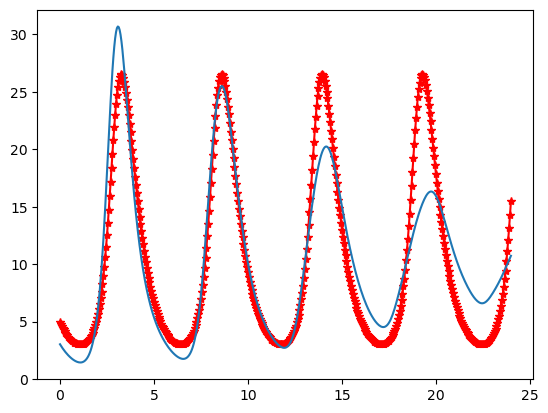

______________________________________________________________________0th iteration_________________________________________________________________
Params start = {'v_params': array([0., 0., 0., 0.])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [-0.07593509 -0.09760544  0.11312195  0.0554652 ]
Recovered v_sigma = 3.3726891014690876 


Params start = {'v_params': array([-0.07593509, -0.09760544,  0.11312195,  0.0554652 ])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 3.3726891014690876}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [-0.02263085 -0.12160989  0.13564651  0.05608542]
Recovered v_sigma = 3.369812138247007 


Params start = {'v_params': array([-0.02263085, -0.12160989,  0.13564651,  0.05608542])}
Progress: [##############################] 100 of 100 samples
sigma st

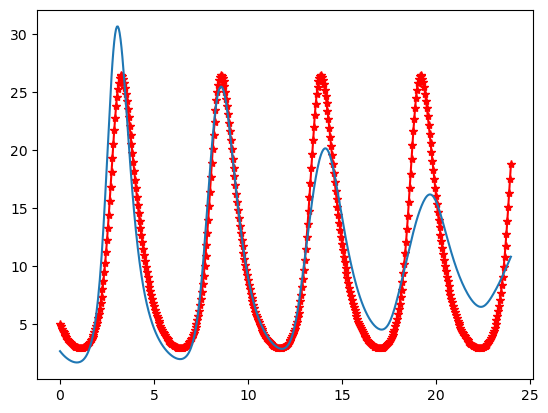

______________________________________________________________________0th iteration_________________________________________________________________
Params start = {'v_params': array([0., 0., 0., 0.])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [ 0.24801893  0.13171696 -0.1575217   0.0498011 ]
Recovered v_sigma = 6.47576339239487 


Params start = {'v_params': array([ 0.24801893,  0.13171696, -0.1575217 ,  0.0498011 ])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 6.47576339239487}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [ 0.30260458  0.11804096 -0.30445597  0.05677074]
Recovered v_sigma = 6.4517157840749135 


Params start = {'v_params': array([ 0.30260458,  0.11804096, -0.30445597,  0.05677074])}
Progress: [##############################] 100 of 100 samples
sigma start

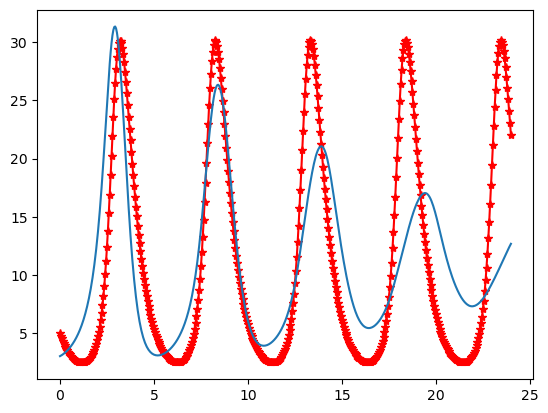

______________________________________________________________________0th iteration_________________________________________________________________
Params start = {'v_params': array([0., 0., 0., 0.])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [0.37854955 0.12152599 0.25845224 0.00179523]
Recovered v_sigma = 6.305009308152497 


Params start = {'v_params': array([0.37854955, 0.12152599, 0.25845224, 0.00179523])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 6.305009308152497}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [ 0.16161828  0.1104395   0.81163843 -0.02055483]
Recovered v_sigma = 4.832036287287353 


Params start = {'v_params': array([ 0.16161828,  0.1104395 ,  0.81163843, -0.02055483])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_

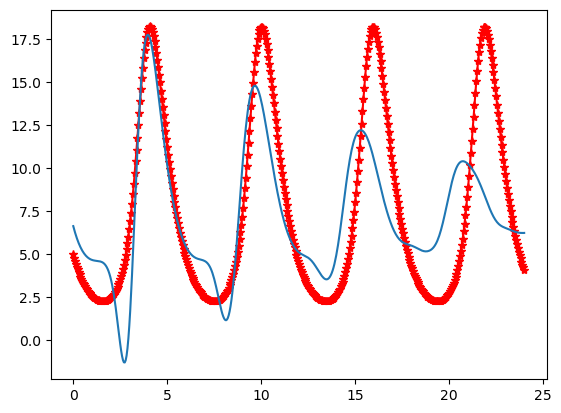

______________________________________________________________________0th iteration_________________________________________________________________
Params start = {'v_params': array([0., 0., 0., 0.])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [ 0.02450648 -0.1444132   0.82365877  0.01732105]
Recovered v_sigma = 2.878252011160654 


Params start = {'v_params': array([ 0.02450648, -0.1444132 ,  0.82365877,  0.01732105])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 2.878252011160654}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [-0.03842781 -0.09908498  0.93161304  0.00921554]
Recovered v_sigma = 2.676118360581618 


Params start = {'v_params': array([-0.03842781, -0.09908498,  0.93161304,  0.00921554])}
Progress: [##############################] 100 of 100 samples
sigma star

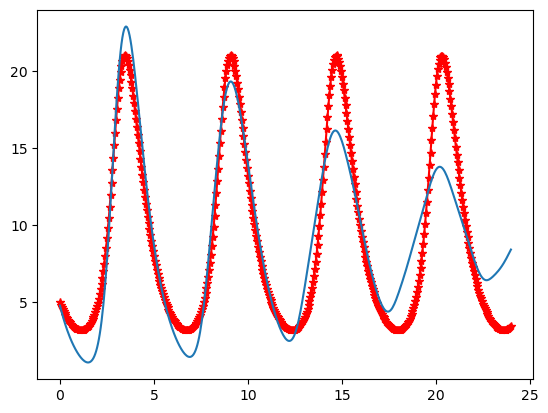

______________________________________________________________________0th iteration_________________________________________________________________
Params start = {'v_params': array([0., 0., 0., 0.])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [ 0.1410859  -0.05579119  0.09672963  0.04177988]
Recovered v_sigma = 2.946012906400239 


Params start = {'v_params': array([ 0.1410859 , -0.05579119,  0.09672963,  0.04177988])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 2.946012906400239}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [ 0.12887326 -0.0886113   0.22084859  0.03921079]
Recovered v_sigma = 2.775371910801046 


Params start = {'v_params': array([ 0.12887326, -0.0886113 ,  0.22084859,  0.03921079])}
Progress: [##############################] 100 of 100 samples
sigma star

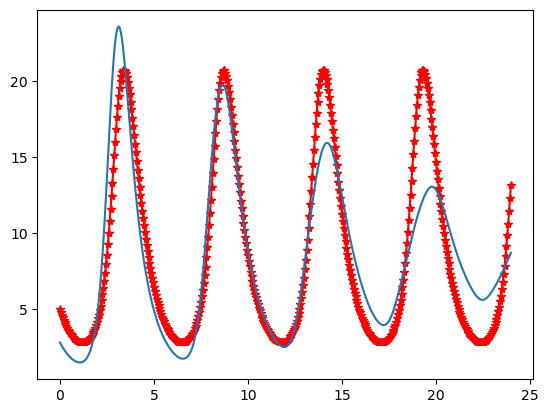

______________________________________________________________________0th iteration_________________________________________________________________
Params start = {'v_params': array([0., 0., 0., 0.])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [ 0.00339188 -0.13821718  0.81402353  0.01026071]
Recovered v_sigma = 3.4265837404231627 


Params start = {'v_params': array([ 0.00339188, -0.13821718,  0.81402353,  0.01026071])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 3.4265837404231627}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [ 2.24441352e-01 -1.52575437e-01  1.05713264e+00  2.39820308e-05]
Recovered v_sigma = 2.8579526105670174 


Params start = {'v_params': array([ 2.24441352e-01, -1.52575437e-01,  1.05713264e+00,  2.39820308e-05])}
Progress: [##########################

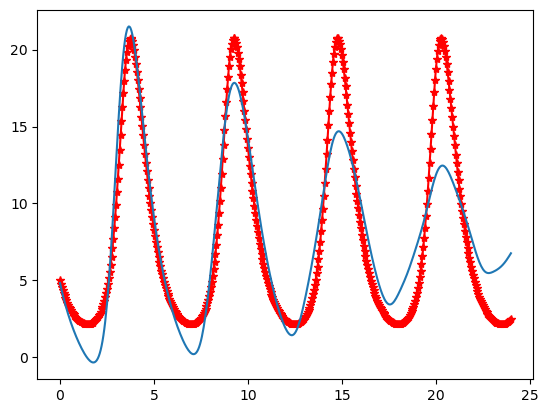

______________________________________________________________________0th iteration_________________________________________________________________
Params start = {'v_params': array([0., 0., 0., 0.])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [-0.01278835  0.05040443  0.27677374  0.0081404 ]
Recovered v_sigma = 8.16485966282696 


Params start = {'v_params': array([-0.01278835,  0.05040443,  0.27677374,  0.0081404 ])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 8.16485966282696}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [ 0.11343609  0.15420995  1.96551915 -0.07326661]
Recovered v_sigma = 4.491117132153119 


Params start = {'v_params': array([ 0.11343609,  0.15420995,  1.96551915, -0.07326661])}
Progress: [##############################] 100 of 100 samples
sigma start 

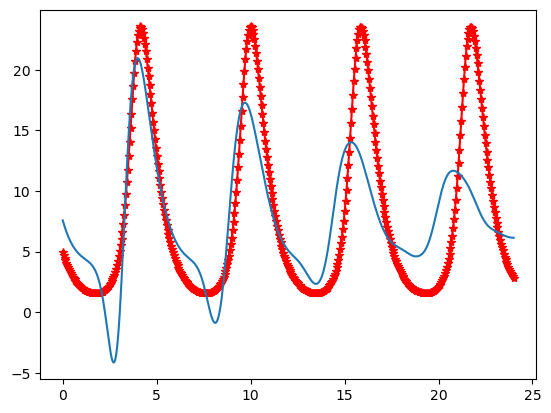

______________________________________________________________________0th iteration_________________________________________________________________
Params start = {'v_params': array([0., 0., 0., 0.])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [ 0.29245175 -0.09231671  0.1676412   0.04109857]
Recovered v_sigma = 4.660965099092732 


Params start = {'v_params': array([ 0.29245175, -0.09231671,  0.1676412 ,  0.04109857])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 4.660965099092732}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [ 0.47935648 -0.19685443  0.48095576  0.03585198]
Recovered v_sigma = 3.6634883689091966 


Params start = {'v_params': array([ 0.47935648, -0.19685443,  0.48095576,  0.03585198])}
Progress: [##############################] 100 of 100 samples
sigma sta

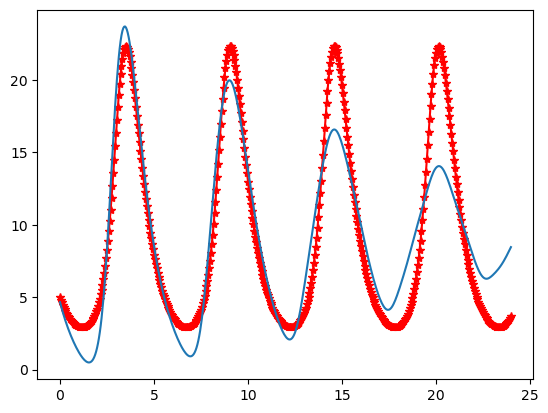

______________________________________________________________________0th iteration_________________________________________________________________
Params start = {'v_params': array([0., 0., 0., 0.])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [0.0273201  0.11433247 0.06359683 0.06134899]
Recovered v_sigma = 7.528739030830335 


Params start = {'v_params': array([0.0273201 , 0.11433247, 0.06359683, 0.06134899])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 7.528739030830335}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [ 0.10134076  0.22450622 -0.15625758  0.06119594]
Recovered v_sigma = 7.334477734447543 


Params start = {'v_params': array([ 0.10134076,  0.22450622, -0.15625758,  0.06119594])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_

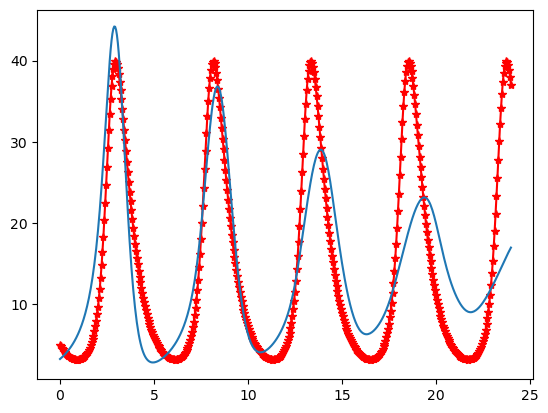

______________________________________________________________________0th iteration_________________________________________________________________
Params start = {'v_params': array([0., 0., 0., 0.])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [ 0.19589913 -0.07977224  1.06819078  0.00383684]
Recovered v_sigma = 2.5960826867131646 


Params start = {'v_params': array([ 0.19589913, -0.07977224,  1.06819078,  0.00383684])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 2.5960826867131646}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [ 0.16277902 -0.06323408  1.09183796  0.00148677]
Recovered v_sigma = 2.5941440646220606 


Params start = {'v_params': array([ 0.16277902, -0.06323408,  1.09183796,  0.00148677])}
Progress: [##############################] 100 of 100 samples
sigma s

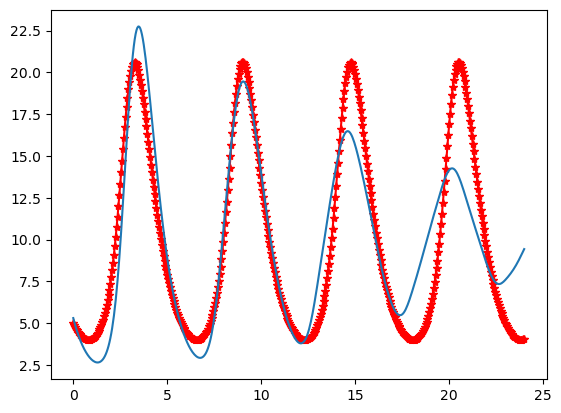

______________________________________________________________________0th iteration_________________________________________________________________
Params start = {'v_params': array([0., 0., 0., 0.])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [ 0.14477477 -0.11192079  0.44626163  0.02936639]
Recovered v_sigma = 4.2621018350357645 


Params start = {'v_params': array([ 0.14477477, -0.11192079,  0.44626163,  0.02936639])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 4.2621018350357645}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [-0.49796196 -0.18513054  1.08750371  0.0102462 ]
Recovered v_sigma = 3.049150831997463 


Params start = {'v_params': array([-0.49796196, -0.18513054,  1.08750371,  0.0102462 ])}
Progress: [##############################] 100 of 100 samples
sigma st

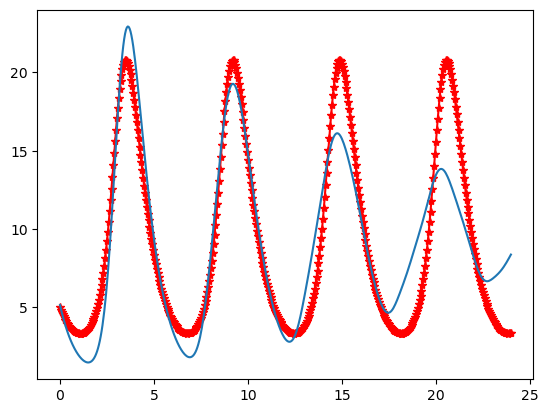

______________________________________________________________________0th iteration_________________________________________________________________
Params start = {'v_params': array([0., 0., 0., 0.])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [-0.0058978  -0.03240597  0.13693847  0.04346607]
Recovered v_sigma = 2.498026245003962 


Params start = {'v_params': array([-0.0058978 , -0.03240597,  0.13693847,  0.04346607])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 2.498026245003962}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [ 0.10930327 -0.05391925  0.28612851  0.03846288]
Recovered v_sigma = 2.3472332528283495 


Params start = {'v_params': array([ 0.10930327, -0.05391925,  0.28612851,  0.03846288])}
Progress: [##############################] 100 of 100 samples
sigma sta

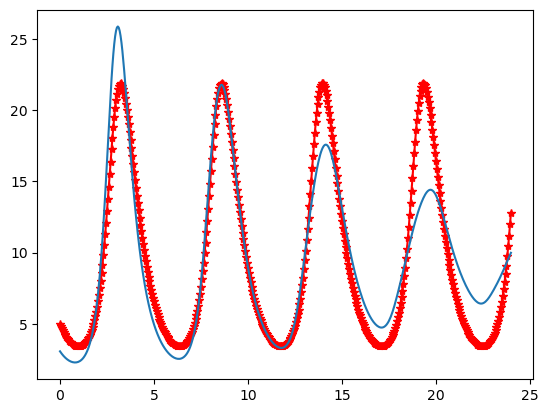

______________________________________________________________________0th iteration_________________________________________________________________
Params start = {'v_params': array([0., 0., 0., 0.])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [-0.23246268 -0.29709139  1.11372069  0.01551925]
Recovered v_sigma = 4.04546112758653 


Params start = {'v_params': array([-0.23246268, -0.29709139,  1.11372069,  0.01551925])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 4.04546112758653}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [ 0.35992795 -0.24822583  1.38812384 -0.00217129]
Recovered v_sigma = 3.333128772037049 


Params start = {'v_params': array([ 0.35992795, -0.24822583,  1.38812384, -0.00217129])}
Progress: [##############################] 100 of 100 samples
sigma start 

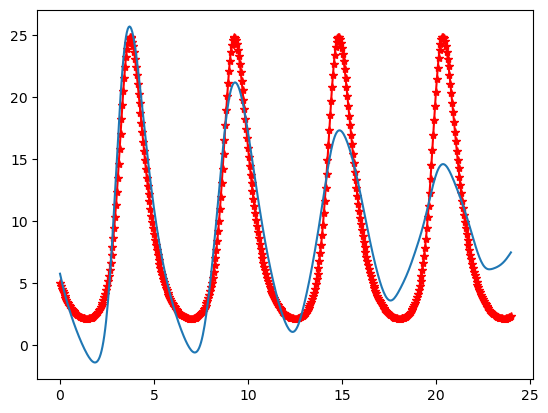

______________________________________________________________________0th iteration_________________________________________________________________
Params start = {'v_params': array([0., 0., 0., 0.])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [ 0.3293033   0.15300892  1.77710779 -0.05117012]
Recovered v_sigma = 4.929997613856518 


Params start = {'v_params': array([ 0.3293033 ,  0.15300892,  1.77710779, -0.05117012])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 4.929997613856518}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [ 0.30321965  0.02320057  1.99315394 -0.04917651]
Recovered v_sigma = 4.495760533773277 


Params start = {'v_params': array([ 0.30321965,  0.02320057,  1.99315394, -0.04917651])}
Progress: [##############################] 100 of 100 samples
sigma star

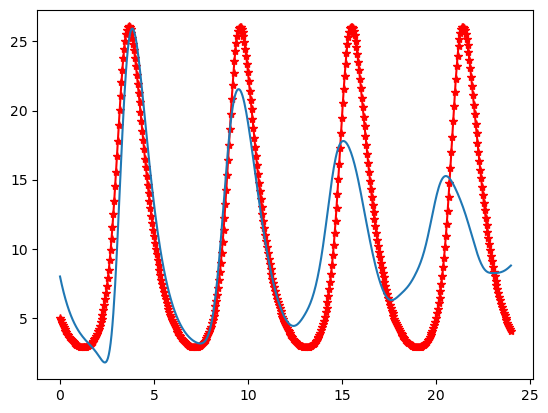

______________________________________________________________________0th iteration_________________________________________________________________
Params start = {'v_params': array([0., 0., 0., 0.])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [-0.39605089 -0.0866821   0.53329829  0.0324245 ]
Recovered v_sigma = 2.3171679810475716 


Params start = {'v_params': array([-0.39605089, -0.0866821 ,  0.53329829,  0.0324245 ])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 2.3171679810475716}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [-0.40601135 -0.01070129  0.55996704  0.02531437]
Recovered v_sigma = 2.2735914827854007 


Params start = {'v_params': array([-0.40601135, -0.01070129,  0.55996704,  0.02531437])}
Progress: [##############################] 100 of 100 samples
sigma s

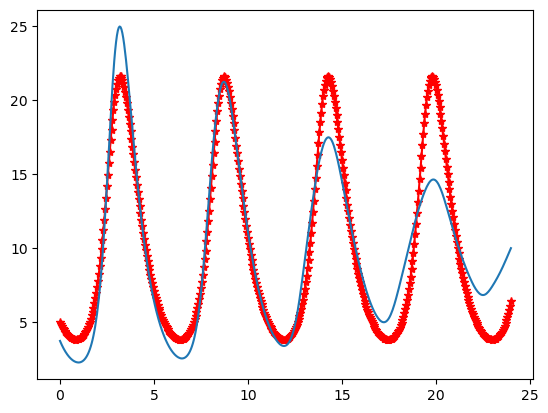

______________________________________________________________________0th iteration_________________________________________________________________
Params start = {'v_params': array([0., 0., 0., 0.])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 0.1}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [-0.25585577 -0.15573519  0.28182398  0.0417976 ]
Recovered v_sigma = 4.859602845953258 


Params start = {'v_params': array([-0.25585577, -0.15573519,  0.28182398,  0.0417976 ])}
Progress: [##############################] 100 of 100 samples
sigma start = {'v_sigma': 4.859602845953258}
Progress: [##############################] 100 of 100 samples
Recovered v_params = [-0.27854673 -0.08971787  0.4604123   0.02860491]
Recovered v_sigma = 4.31066335655778 


Params start = {'v_params': array([-0.27854673, -0.08971787,  0.4604123 ,  0.02860491])}
Progress: [##############################] 100 of 100 samples
sigma start

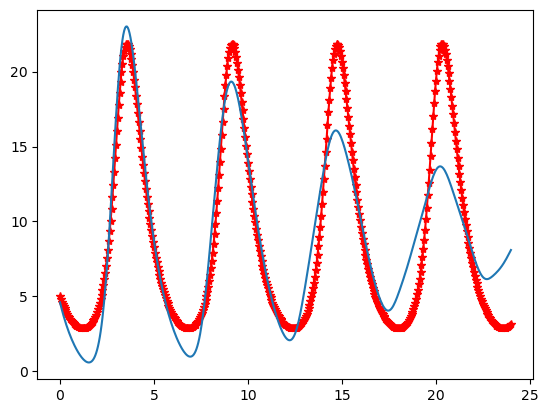

In [34]:
multi_v_Posterior_params = []
multi_v_Posterior_sigma = []

for i in range(len(path_dist)):
    v_dot_noisy = path_dist[i][:,1]
    # Initialize the parameters (params and sigma)
    v_start_params = np.zeros(4) #calc_mean(chain_param_ltk.params) #
    v_start_sigma = 0.1 #calc_mean(chain_eps_ltk.sigma) #
    
    v_Posterior_params = []
    v_Posterior_sigma = []
    # While the number of steps is less than a preset
    step = 0
    while step<num_step:
        if step%10 == 0:
            print(f'______________________________________________________________________{step}th iteration_________________________________________________________________')
        
        # Sample new params given sigma using ABC likelihood without gamma
        def log_likelihood(v_params):
            a,b,c,d = v_params
            sig = v_start_sigma
            
            # predict udot
            udot_predict = simulate_param(v_params, library).reshape(-1)
            
            model = smp.Model()
            # Log-likelihood
            model.add(smp.normal(udot_predict, mu=v_dot_noisy, sig=sig))   
        
            # log-priors
            model.add(smp.uniform(a, lower = -2, upper=2),
                      smp.uniform(b, lower = -2, upper=2),
                      smp.uniform(c, lower = -2, upper=2),
                      smp.uniform(d, lower = -2, upper=2)
                     )
            return model()
    
    
        v_start_params_ltk = {'v_params': v_start_params} # Set the starting model parameter
        print(f'Params start = {v_start_params_ltk}') # Print the starting model parameter
        hmc_param_ltk = smp.Slice(log_likelihood, v_start_params_ltk)
        chain_param_ltk = hmc_param_ltk.sample(100, burn=50, n_chains=1)
        #Replace current with accepted params
        v_start_params = calc_mean(chain_param_ltk.v_params)
        
        
       
        # Sample new sigma given new params using sigma likelihood
        def sigma_likelihood(v_sigma):
            sig = v_sigma
            
            # predict udot
            udot_predict = simulate_param(v_start_params, library).reshape(-1)
            
            model = smp.Model()
            
            # Log-likelihood
            model.add(smp.normal(udot_predict, mu=v_dot_noisy, sig=sig))    
            # log-priors
            model.add(smp.exponential(sig))
            return model()
        
        #Sampling sigma given the parameters
        start_eps_ltk = {'v_sigma': v_start_sigma} # Set the starting sigma parameter
        print(f'sigma start = {start_eps_ltk}') # Print the starting sigma parameter
        hmc_eps_ltk = smp.Slice(sigma_likelihood, start_eps_ltk) #Hamiltonian, Slice, NUTS, Metropolis
        chain_eps_ltk = hmc_eps_ltk.sample(100, burn=50, n_chains=1)
        v_start_sigma = calc_mean(chain_eps_ltk.v_sigma)
        
        # Store the new params and sigma
        v_Posterior_params.append(v_start_params)
        v_Posterior_sigma.append(v_start_sigma)
        
        #Repeat step 3-5 
        step +=1
        # mean_params = start_params
        print(f'Recovered v_params = {v_start_params}')
        print(f'Recovered v_sigma = {v_start_sigma} \n\n')
    
    print(calc_mean(v_Posterior_params), calc_mean(v_Posterior_sigma))
    
    v_dot_post = simulate_param(calc_mean(v_Posterior_params), library)
    plt.plot(t, v_dot_noisy, 'r*-')
    plt.plot(t, v_dot_post)
    plt.show()

    multi_v_Posterior_params.append(calc_mean(v_Posterior_params))
    multi_v_Posterior_sigma.append(calc_mean(v_Posterior_sigma))        

# Performance comparisons

### histogram plotting functions

In [35]:
def plot_histograms_in_one(*matrices):
    """
    Plot histograms for columns of the given matrices. Each matrix must have the same number of columns
    but can have different number of rows.

    Parameters:
    *matrices (array-like): Variable number of matrices where each matrix is an array-like structure with
                            two dimensions. All matrices must have the same number of columns.

    Returns:
    None
    """
    # Ensure all matrices have the same number of columns
    if len(set(m.shape[1] for m in matrices)) != 1:
        raise ValueError("All matrices must have the same number of columns")
    
    num_columns = matrices[0].shape[1]
    num_rows = len(matrices)
    
    # Creating figure with subplots
    fig, axes = plt.subplots(nrows=1, ncols=num_columns, figsize=(5 * num_columns, 4), squeeze=False)
    axes = axes.flatten()  # Flatten the array of axes for easy iteration

    # For each column, plot the histogram across all matrices
    for col in range(num_columns):
        for idx, matrix in enumerate(matrices):
            column_data = matrix[:, col]
            mean_k = np.mean(column_data)
            sigma_k = np.std(column_data)
            
            # Plot histogram
            axes[col].hist(column_data, bins=20, alpha=0.7, density =True ,label=f'Matrix {idx+1} mean={mean_k:.2f}, $\sigma$={sigma_k:.2f}')
            
        # Set labels and titles
        axes[col].set_title(f'Column {col + 1}')
        axes[col].set_xlabel('Value')
        axes[col].set_ylabel('Frequency')
        axes[col].legend()

    # Adjust layout
    plt.tight_layout()
    plt.show()


def plot_matrix_histograms(*matrices, hist_labels = ['Observed data', 'SIP Posterior', 'PCE Posterior']):
    """
    Plots normalized histograms for each column of the given matrices. Each matrix is plotted
    in a separate figure with subplots arranged column-wise. Histograms are normalized so that
    they all have the same height scale (area under histogram equals 1).

    Parameters:
    *matrices (multiple numpy.ndarray arguments): matrices to plot with the same number of columns
    but possibly different number of rows.
    """
    for index, matrix in enumerate(matrices):
        num_columns = matrix.shape[1]
        fig, axes = plt.subplots(nrows=1, ncols=num_columns, figsize=(4*num_columns, 3), squeeze=False)
        fig.suptitle(f'{hist_labels[i]}', fontsize=16)
        
        for col in range(num_columns):
            ax = axes[0, col]
            data = matrix[:, col]
            mean_k = np.mean(data)
            std_k = np.std(data)
            ax.hist(data, bins='auto', color='skyblue', alpha=0.7, rwidth=0.85, density=True)
            ax.set_title(f'Param {col+1} (mean={mean_k:.2f}, std={std_k:.2f})')
            ax.set_xlabel('Value')
            ax.set_ylabel('Density')
        
        plt.tight_layout(rect=[0, 0.03, 1, 0.95])  # Adjust layout to make room for figure title
        plt.show()

def plot_matrix_histograms(*matrices, colors = ['red', 'blue', 'green'], hist_labels = ['Observed data', 'SIP Posterior', 'PCE Posterior']):
    """
    Plots normalized histograms for each column of the given matrices, with a vertical line indicating
    the mean of the samples. Each matrix is plotted in a separate figure with subplots arranged column-wise.
    Histograms are normalized so that they all have the same height scale (area under histogram equals 1).

    Parameters:
    *matrices (multiple numpy.ndarray arguments): matrices to plot with the same number of columns
    but possibly different number of rows.
    """
    for index, matrix in enumerate(matrices):
        num_columns = matrix.shape[1]
        fig, axes = plt.subplots(nrows=1, ncols=num_columns, figsize=(4*num_columns, 3), squeeze=False)
        fig.suptitle(f'{hist_labels[index]}', fontsize=16)
        
        for col in range(num_columns):
            ax = axes[0, col]
            data = matrix[:, col]
            mean_k = np.mean(data)
            std_k = np.std(data)
            # Create histogram with density=True to normalize heights
            ax.hist(data, bins='auto', color=colors[index], alpha=0.7, rwidth=0.85, density=True)
            # Plot a vertical line for the mean
            ax.axvline(mean_k, color='black', linestyle='dashed', linewidth=1)
            # Adding text annotation for mean
            # ax.text(mean_k, ax.get_ylim()[1] * 0.95, f'Mean: {mean_k:.2f}', color='black', ha='right')
            
            ax.set_title(f'Param {col+1} (mean={mean_k:.2f}, std={std_k:.2f})')
            ax.set_xlabel('Value')
            ax.set_ylabel('Density')
        
        plt.tight_layout(rect=[0, 0.03, 1, 0.95])  # Adjust layout to make room for figure title
        plt.show()

from scipy.stats import entropy

def plot_pushfowards(x_values, *y_paths_groups, show=False, colors=['red', 'blue', 'green'], hl='k*', labels=['Observed mean', 'SIP mean', 'PCE mean']):
    """
    Plots multiple groups of y paths (each group and each row in a group against x_values)
    on separate plots with a specified transparency. Computes the KL divergence of all groups
    with respect to the first group and displays it in the plot title.

    Parameters:
        x_values (array_like): The common x values for the y paths.
        *y_paths_groups (variable number of array_like arguments): Each being a matrix of y paths
            where each row in a matrix is a y path.
        show (bool): Whether to display the plot immediately.
        colors (list): List of colors for each group of paths.
        hl (str): Highlight style for the mean path.
        labels (list): Labels for the mean of each group.
    """
    if colors is None:
        colors = ['blue'] * len(y_paths_groups)
    if labels is None:
        labels = [f'mean_path_{i+1}' for i in range(len(y_paths_groups))]

    # Plot the means
    plt.figure(figsize=(10, 6))
    for index, y_paths in enumerate(y_paths_groups):        
        # Calculate the mean path across all rows (mean for each column)
        mean_path = np.mean(y_paths, axis=0)
        
        # Plot the mean path
        plt.plot(x_values, mean_path, color = colors[index], label=labels[index % len(labels)])  # mean path highlighted
        
    # Adding title and labels
    plt.title(f'Plots of Mean Paths')
    plt.xlabel('X Values')
    plt.ylabel('Y Values')
    plt.legend()
    plt.show()

    # Reference paths for KL divergence
    reference_y_paths = y_paths_groups[0]
    reference_density, _ = np.histogram(reference_y_paths, bins=30, density=True)
    
    for index, y_paths in enumerate(y_paths_groups):
        plt.figure(figsize=(10, 6))
        
        # Calculate the mean path across all rows (mean for each column)
        mean_path = np.mean(y_paths, axis=0)
        
        # Plot each path
        for path in y_paths:
            plt.plot(x_values, path, color=colors[index % len(colors)], alpha=0.3)  # semi-transparent lines
        
        # Plot the mean path
        plt.plot(x_values, mean_path, hl, label=labels[index % len(labels)])  # mean path highlighted
        
        # Compute and plot KL divergence with respect to the first group
        current_density, _ = np.histogram(y_paths, bins=30, density=True)
        kl_div = entropy(current_density, reference_density)
        
        # Adding title and labels
        plt.title(f'Plots of Paths (KL div w.r.t. first group: {kl_div:.2f})')
        plt.xlabel('X Values')
        plt.ylabel('Y Values')
        plt.legend()
        
        if show:
            plt.show()

### Visualize distribution

#### SIP posterior parameter distribution

In [36]:
print(f' SIP  u_dot recovered distribution \n mean = {np.mean(x_post_param_samples,0).round(3)}, \n sigma = {np.std(x_post_param_samples,0).round(3)} \n')
print(f' Bayesian u_dot recovered distribution \n mean = {np.mean(multi_u_Posterior_params,0).round(3)}, \n sigma = {np.std(multi_u_Posterior_params,0).round(3)} \n\n\n')

print(f' SIP  v_dot recovered distribution \n mean = {np.mean(y_post_param_samples,0).round(3)}, \n sigma = {np.std(y_post_param_samples,0).round(3)} \n')
print(f' Bayesian v_dot recovered distribution \n mean = {np.mean(multi_v_Posterior_params,0).round(3)}, \n sigma = {np.std(multi_v_Posterior_params,0).round(3)} \n')

 SIP  u_dot recovered distribution 
 mean = [ 0.011  0.901 -0.001 -0.088], 
 sigma = [0.017 0.032 0.016 0.002] 

 Bayesian u_dot recovered distribution 
 mean = [ 0.068  0.979 -0.007  0.002], 
 sigma = [0.777 0.513 0.761 0.051] 



 SIP  v_dot recovered distribution 
 mean = [-0.011  0.013 -1.275  0.062], 
 sigma = [0.005 0.003 0.034 0.001] 

 Bayesian v_dot recovered distribution 
 mean = [ 0.026 -0.001  0.931  0.003], 
 sigma = [0.526 0.178 0.681 0.038] 



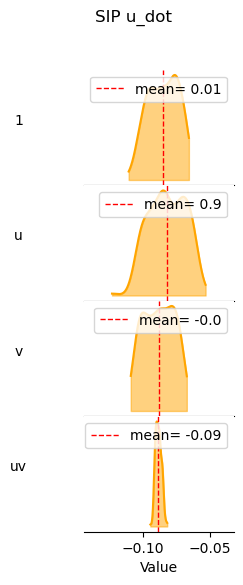

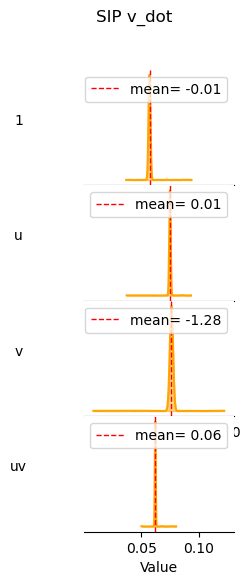

In [49]:
titles = ['1', 'u', 'v', 'uv']
mf.plot_kde_matrix(x_post_param_samples, titles, color='orange', name = 'SIP u_dot') #, xlim=(-1.5,1.5))

mf.plot_kde_matrix(y_post_param_samples, titles, color='orange', name = 'SIP v_dot') #, xlim = (-3,3))

#### UQ SINDy posterior parameter distribution

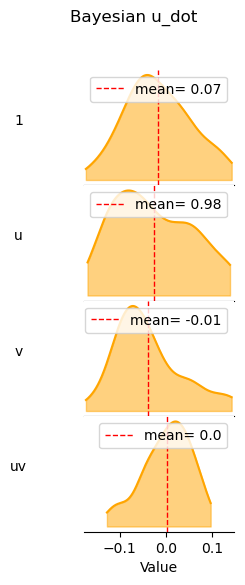

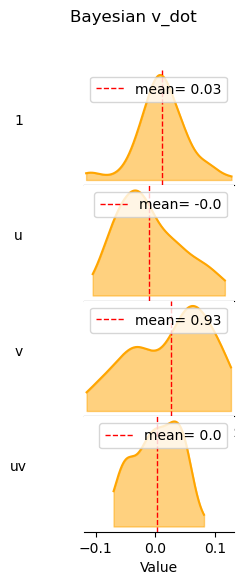

In [48]:
titles = ['1', 'u', 'v', 'uv']
mf.plot_kde_matrix(multi_u_Posterior_params, titles, color='orange', name = 'Bayesian u_dot') # xlim=(-1.5,1.5))

mf.plot_kde_matrix(multi_v_Posterior_params, titles, color='orange', name = 'Bayesian v_dot') # xlim = (-3,3))

### Recovered simulation

In [39]:
def recovered_lv(state, t, u_params,v_params):
    u,v = state
    a0,b0,c0,d0 = u_params
    a1,b1,c1,d1 = v_params    
    du_dt = a0*1 + b0*u + c0*v + d0*u*v
    dv_dt = a1*1 + b1*u + c1*v + d1*u*v
    return [du_dt, dv_dt]

def simulate_recovered_params(u_params,v_params):
    initital_state = [10,5]
    time = np.linspace(0, 24, num_points)
    solution = odeint(recovered_lv, initial_state, time, args=(u_params, v_params,))
    u_sim, v_sim = solution.T
    return u_sim,v_sim

def mean_squared_error(y_true, y_pred):
    """
    Calculates the Mean Squared Error (MSE) between two arrays.
    """
    y_true = np.array(y_true)  # Ensure the input is a numpy array
    y_pred = np.array(y_pred)  # Ensure the input is a numpy array

    # Calculate the MSE
    mse = np.mean((y_true - y_pred) ** 2)
    return mse

SIP u_mse = 194.06406456362708
SIP v_mse = 73.9199923757461


UQ u_mse = 4.494467561080818e+23
UQ v_mse = 1.1970060097814652e+24


C:\Users\USER\AppData\Local\Temp\ipykernel_7568\3446324032.py:12: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get quantitative information.
  solution = odeint(recovered_lv, initial_state, time, args=(u_params, v_params,))


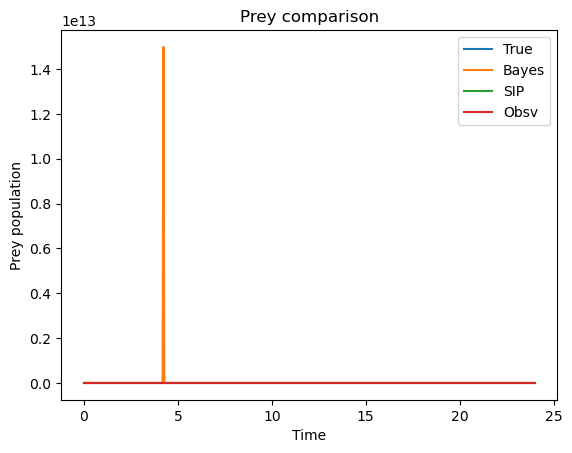

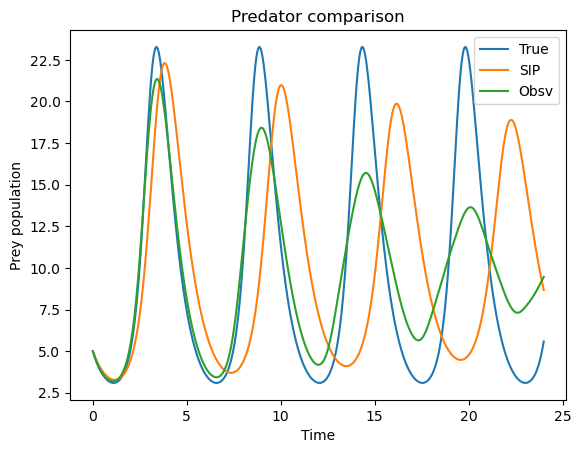

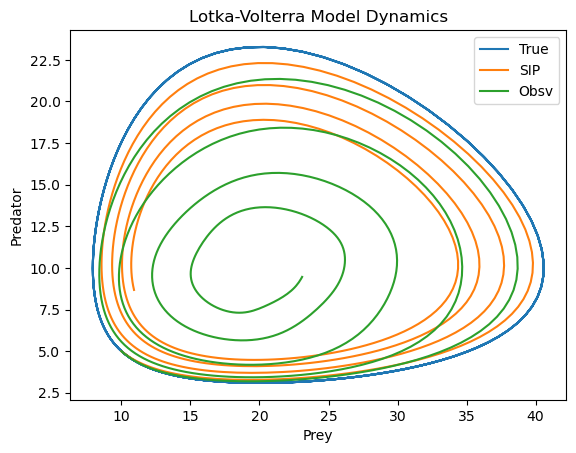

In [40]:
# SIP SINDy posterior simulation
u_postmean_sip = calc_mean(x_post_param_samples)
v_postmean_sip = calc_mean(y_post_param_samples)

u_post_sip, v_post_sip = simulate_recovered_params(u_postmean_sip,v_postmean_sip)
print(f'SIP u_mse = {mean_squared_error(u_sim, u_post_sip)}')
print(f'SIP v_mse = {mean_squared_error(v_sim, v_post_sip)}\n\n')


# UQ SINDy posterior simulation
u_postmean_uq = calc_mean(multi_u_Posterior_params)
v_postmean_uq = calc_mean(multi_v_Posterior_params)

u_post_uq, v_post_uq = simulate_recovered_params(u_postmean_uq,v_postmean_uq)
print(f'UQ u_mse = {mean_squared_error(u_sim, u_post_uq)}')
print(f'UQ v_mse = {mean_squared_error(v_sim, v_post_uq)}')


# plot and compare simulation versus observed data
plt.figure()
plt.title('Prey comparison')
plt.plot(t, u_sim, label='True')
plt.plot(t, u_post_uq, label='Bayes')
plt.plot(t, u_post_sip, label='SIP')
plt.plot(t, u_data, label='Obsv')
plt.xlabel('Time')
plt.ylabel('Prey population')
plt.legend()
plt.show()

plt.figure()
plt.title('Predator comparison')
plt.plot(t, v_sim, label='True')
# plt.plot(t, v_post_uq, label='Bayes')
plt.plot(t, v_post_sip, label='SIP')
plt.plot(t, v_data, label='Obsv')
plt.xlabel('Time')
plt.ylabel('Prey population')
plt.legend()
plt.show()

plt.figure()
plt.title('Lotka-Volterra Model Dynamics')
plt.plot(u_sim, v_sim, label='True')
# plt.plot(u_post_uq, v_post_uq, label='Bayes')
plt.plot(u_post_sip, v_post_sip, label='SIP')
plt.plot(u_data, v_data, label='Obsv')
plt.xlabel('Prey')
plt.ylabel('Predator')
plt.legend()
plt.show()

# parameter mean squared error estimation

In [41]:
# true parameters
u_true = [0,1,0,-0.1]
v_true  = [0,0,-1.5,0.075]

# mean path (mp) recovery
u_sip_mp = [-0.01, 1.01, -0.01, -0.1]
u_bayes_mp  = [0.03, 0.94, -0.09, -0.09]

v_sip_mp  = [0.006, -0.007, -1.53, 0.08]
v_bayes_mp  = [-0.058, 0.086, -1.344, 0.058]


# all path (ap) recovery
u_sip_ap  = u_postmean_sip#[-0.001, 1.075, -0.01, -0.12]
u_bayes_ap  = u_postmean_uq#[0.006, 0.917, 0.041, -0.005]

v_sip_ap  = v_postmean_sip#[0.006, 0.017, -1.36, 0.058]
v_bayes_ap  = v_postmean_uq#[0.008, -0.007, 0.334, 0.029]

u_recv_params = [u_sip_mp, u_bayes_mp, u_sip_ap, u_bayes_ap]
u_names = ['u_sip_mp', 'u_bayes_mp', 'u_sip_ap', 'u_bayes_ap']
for i,u_rcv in enumerate(u_recv_params):
    print(f'MSE {u_names[i]} = {np.sqrt(mean_squared_error(u_true, u_rcv)).round(5)}')

print('\n\n\n')
v_recv_params = [v_sip_mp, v_bayes_mp, v_sip_ap, v_bayes_ap]
v_names = ['v_sip_mp', 'v_bayes_mp', 'v_sip_ap', 'v_bayes_ap']
for i,v_rcv in enumerate(v_recv_params):
    print(f'MSE {v_names[i]} = {np.sqrt(mean_squared_error(v_true, v_rcv)).round(5)}')

MSE u_sip_mp = 0.00866
MSE u_bayes_mp = 0.05635
MSE u_sip_ap = 0.04995
MSE u_bayes_ap = 0.06232




MSE v_sip_mp = 0.01589
MSE v_bayes_mp = 0.09405
MSE v_sip_ap = 0.1128
MSE v_bayes_ap = 1.21619


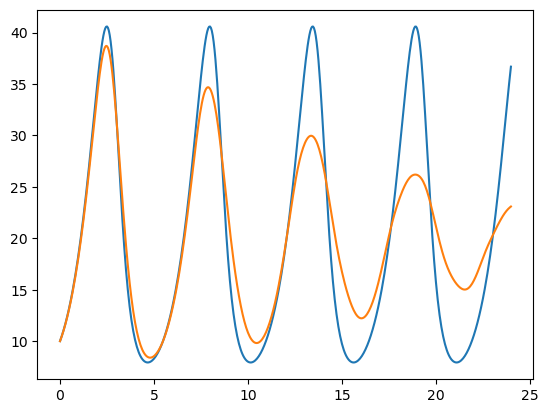

In [42]:
def recovered_lv(state, t, u_params,v_params):
    u,v = state
    a0,b0,c0,d0 = u_params
    a1,b1,c1,d1 = v_params    
    du_dt = a0*1 + b0*u + c0*v + d0*u*v
    dv_dt = a1*1 + b1*u + c1*v + d1*u*v
    return [du_dt, dv_dt]

def simulate_recovered_params(u_params,v_params):
    solution = odeint(recovered_lv, initial_state, time, args=(u_params, v_params,))
    u_sim, v_sim = solution.T
    return u_sim,v_sim


u_tmp, v_tmp = simulate_recovered_params(u_true,v_true)



# SIP posterior path plot

plt.plot(time, u_tmp)
plt.plot(time, u_data)

In [43]:
from tqdm import tqdm
# SIP posterior path simulation
u_sip_post_paths = []
v_sip_post_paths = []
for i in tqdm(range(len(x_post_param_samples))):
    u_param_i = x_post_param_samples[i]
    v_param_i = y_post_param_samples[i]
    u_tmp, v_tmp = simulate_recovered_params(u_param_i,v_param_i)
    u_sip_post_paths.append(u_tmp)
    v_sip_post_paths.append(v_tmp)
u_sip_post_paths = np.array(u_sip_post_paths)
v_sip_post_paths = np.array(v_sip_post_paths)

# Bayes posterior path simulation
u_uq_post_paths = []
v_uq_post_paths = []
for i in tqdm(range(len(u_Posterior_params))):
    u_param_i = u_Posterior_params[i]
    v_param_i = v_Posterior_params[i]
    u_tmp, v_tmp = simulate_recovered_params(u_param_i,v_param_i)
    u_uq_post_paths.append(u_tmp)
    v_uq_post_paths.append(v_tmp)
u_uq_post_paths=np.array(u_uq_post_paths)
v_uq_post_paths=np.array(v_uq_post_paths)

  0%|                                                                                          | 0/203 [00:00<?, ?it/s]C:\Users\USER\AppData\Local\Temp\ipykernel_7568\706463975.py:10: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get quantitative information.
  solution = odeint(recovered_lv, initial_state, time, args=(u_params, v_params,))
100%|██████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 75.62it/s]


SIP u_mse = 4.475227097722695e+23
SIP v_mse = 1.4899202268157594e+23


UQ u_mse = 587073425638.6309
UQ v_mse = 200893941628.76508


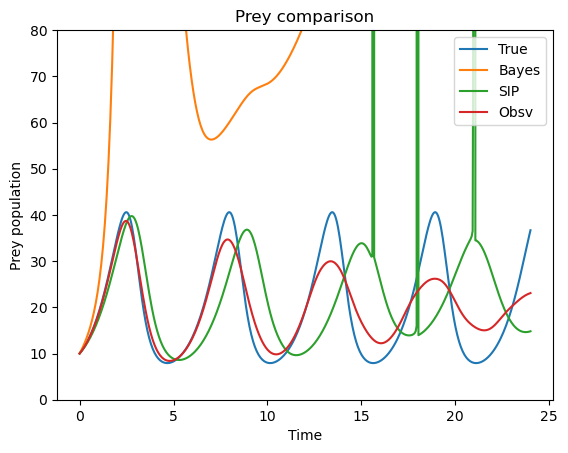

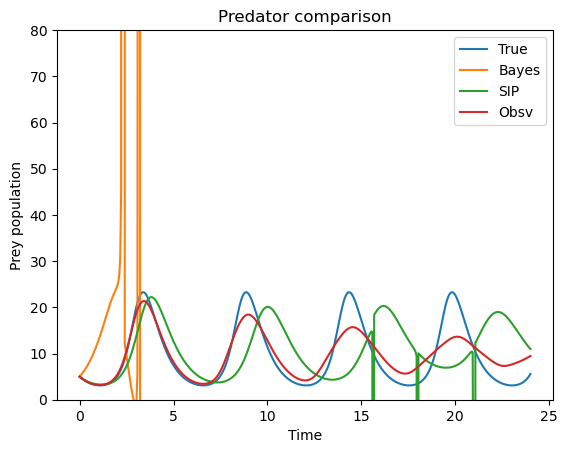

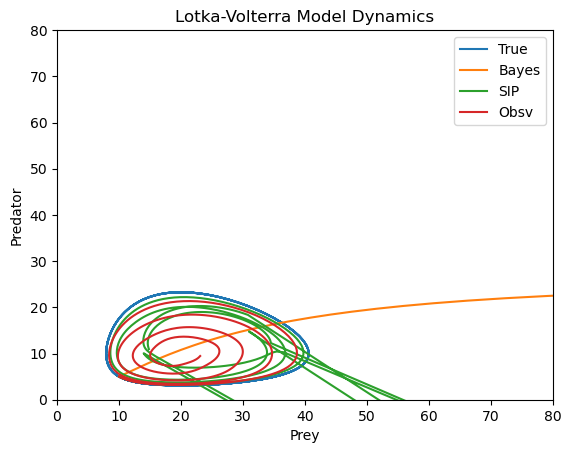

In [44]:
u_post_meanpath_sip = np.mean(u_sip_post_paths,0)
v_post_meanpath_sip = np.mean(v_sip_post_paths,0)

u_post_meanpath_uq = np.mean(u_uq_post_paths,0)
v_post_meanpath_uq = np.mean(v_uq_post_paths,0)

print(f'SIP u_mse = {mean_squared_error(u_sim, u_post_meanpath_sip)}')
print(f'SIP v_mse = {mean_squared_error(v_sim, v_post_meanpath_sip)}\n\n')

print(f'UQ u_mse = {np.sqrt(mean_squared_error(u_sim, u_post_meanpath_uq))}')
print(f'UQ v_mse = {np.sqrt(mean_squared_error(v_sim, v_post_meanpath_uq))}')


# plot and compare simulation versus observed data
plt.figure()
plt.title('Prey comparison')
plt.plot(t, u_sim, label='True')
plt.plot(t, u_post_meanpath_uq, label='Bayes')
plt.plot(t, u_post_meanpath_sip, label='SIP')
plt.plot(t, u_data, label='Obsv')
plt.xlabel('Time')
plt.ylabel('Prey population')
plt.ylim(0,80)
plt.legend()
plt.show()

plt.figure()
plt.title('Predator comparison')
plt.plot(t, v_sim, label='True')
plt.plot(t, v_post_meanpath_uq, label='Bayes')
plt.plot(t, v_post_meanpath_sip, label='SIP')
plt.plot(t, v_data, label='Obsv')
plt.xlabel('Time')
plt.ylabel('Prey population')
plt.ylim(0,80)
plt.legend()
plt.show()

plt.figure()
plt.title('Lotka-Volterra Model Dynamics')
plt.plot(u_sim, v_sim, label='True')
plt.plot(u_post_meanpath_uq, v_post_meanpath_uq, label='Bayes')
plt.plot(u_post_meanpath_sip, v_post_meanpath_sip, label='SIP')
plt.plot(u_data, v_data, label='Obsv')
plt.xlabel('Prey')
plt.ylabel('Predator')
plt.ylim(0,80)
plt.xlim(0,80)
plt.legend()
plt.show()

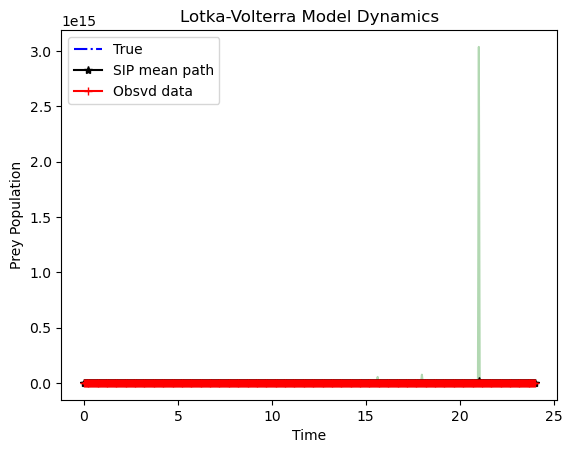

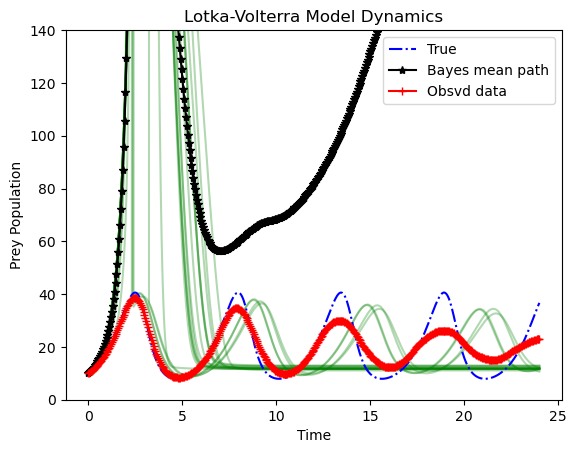

In [45]:
# Visualize paths
plt.figure()
plt.title('Lotka-Volterra Model Dynamics')
for i in range(len(u_sip_post_paths)):
    xn = u_sip_post_paths[i]
    plt.plot(t, xn, 'g', alpha = 0.3)
plt.plot(t, u_sim, 'b-.', label='True')
plt.plot(t, u_post_meanpath_sip, 'k-*', label='SIP mean path')
plt.plot(t, u_data, 'r-+',label='Obsvd data')
plt.legend()
plt.xlabel('Time')
plt.ylabel('Prey Population')
plt.legend()
plt.show()

# Visualize paths
plt.figure()
plt.title('Lotka-Volterra Model Dynamics')
for i in range(len(u_uq_post_paths)):
    xn = u_uq_post_paths[i]
    plt.plot(t, xn, 'g', alpha = 0.3)
plt.plot(t, u_sim, 'b-.', label='True')
plt.plot(t, u_post_meanpath_uq, 'k-*', label='Bayes mean path')
plt.plot(t, u_data, 'r-+',label='Obsvd data')
plt.legend()
plt.xlabel('Time')
plt.ylabel('Prey Population')
plt.ylim(0, 140)
plt.legend()
plt.show()

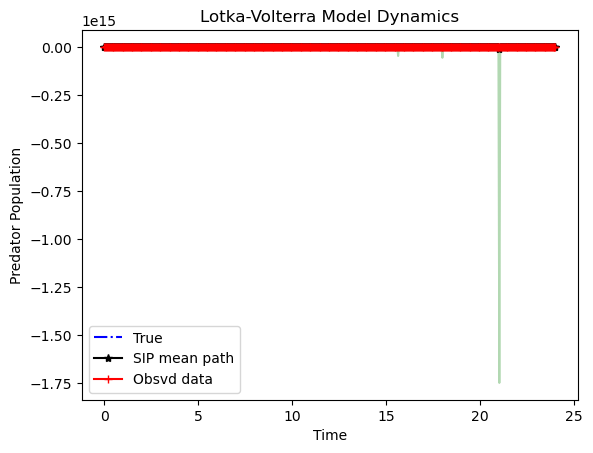

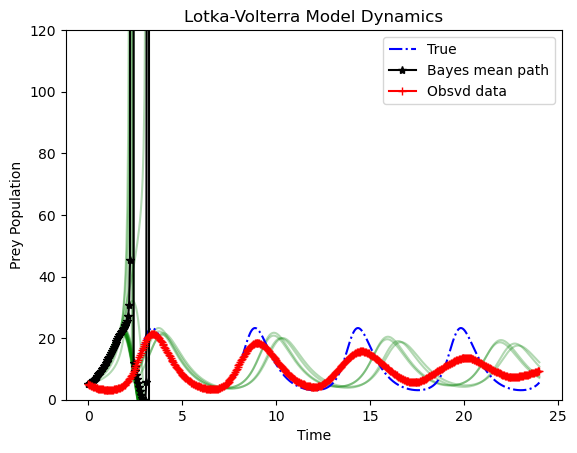

In [46]:
# Visualize paths
plt.figure()
plt.title('Lotka-Volterra Model Dynamics')
for i in range(len(v_sip_post_paths)):
    yn = v_sip_post_paths[i]
    plt.plot(t, yn, 'g', alpha = 0.3)
plt.plot(t, v_sim, 'b-.', label='True')
plt.plot(t, v_post_meanpath_sip, 'k-*', label='SIP mean path')
plt.plot(t, v_data, 'r-+',label='Obsvd data')
plt.legend()
plt.xlabel('Time')
plt.ylabel('Predator Population')
plt.legend()
plt.show()

# Visualize paths
plt.figure()
plt.title('Lotka-Volterra Model Dynamics')
for i in range(len(v_uq_post_paths)):
    yn = v_uq_post_paths[i]
    plt.plot(t, yn, 'g', alpha = 0.3)
plt.plot(t, v_sim, 'b-.', label='True')
plt.plot(t, v_post_meanpath_uq, 'k-*', label='Bayes mean path')
plt.plot(t, v_data, 'r-+',label='Obsvd data')
plt.legend()
plt.xlabel('Time')
plt.ylabel('Prey Population')
plt.ylim(0, 120)
plt.legend()
plt.show()

<Figure size 1920x1440 with 0 Axes>

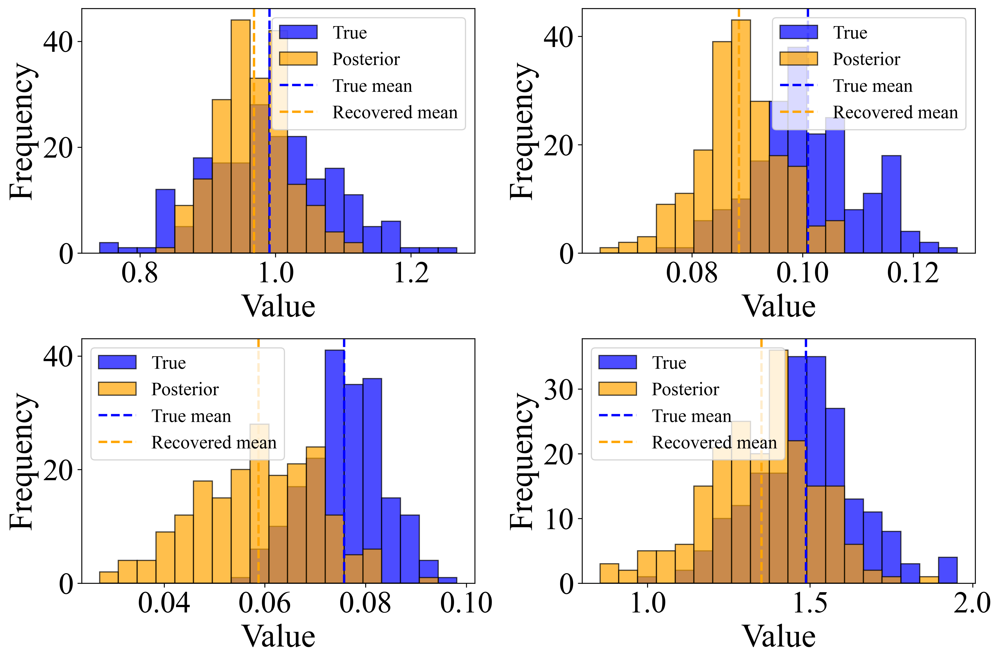

In [98]:
import numpy as np
import matplotlib.pyplot as plt

# Parameters
mean_params = [1, 0.1, 0.075, 1.5]
std_params = np.array(mean_params) * 0.1

recv_mean = [0.97, 0.088, 0.058, 1.36]
recv_std = [0.055, 0.008, 0.013, 0.168]

# Sample data
true_samples = [np.random.normal(loc=mean, scale=std, size=200) for mean, std in zip(mean_params, std_params)]
recv_samples = [np.random.normal(loc=mean, scale=std, size=200) for mean, std in zip(recv_mean, recv_std)]

# Plotting
plt.figure()
fig, axes = plt.subplots(2, 2, figsize=(12, 8))
axes = axes.flatten()

titles = ['alpha', 'beta', 'gamma', 'delta']

for i in range(4):
    data_min = min(min(true_samples[i]), min(recv_samples[i]))
    data_max = max(max(true_samples[i]), max(recv_samples[i]))
    bins = np.linspace(data_min, data_max, 20)  # Define bin edges based on sampled points
    
    axes[i].hist(true_samples[i], bins=bins, alpha=0.7, label='True', color='blue', edgecolor='black')
    axes[i].hist(recv_samples[i], bins=bins, alpha=0.7, label='Posterior', color='orange', edgecolor='black')
    axes[i].axvline(np.mean(true_samples[i]), color='blue', linestyle='dashed', linewidth=2, label='True mean')
    axes[i].axvline(np.mean(recv_samples[i]), color='orange', linestyle='dashed', linewidth=2, label='Recovered mean')
    # axes[i].set_title(titles[i])
    axes[i].legend(fontsize=16)
    axes[i].set_xlabel('Value', fontsize = 28)
    axes[i].set_ylabel('Frequency', fontsize = 28)
    axes[i].tick_params(axis='y', labelsize=26)
    axes[i].tick_params(axis='x', labelsize=26)

plt.tight_layout()
plt.show()

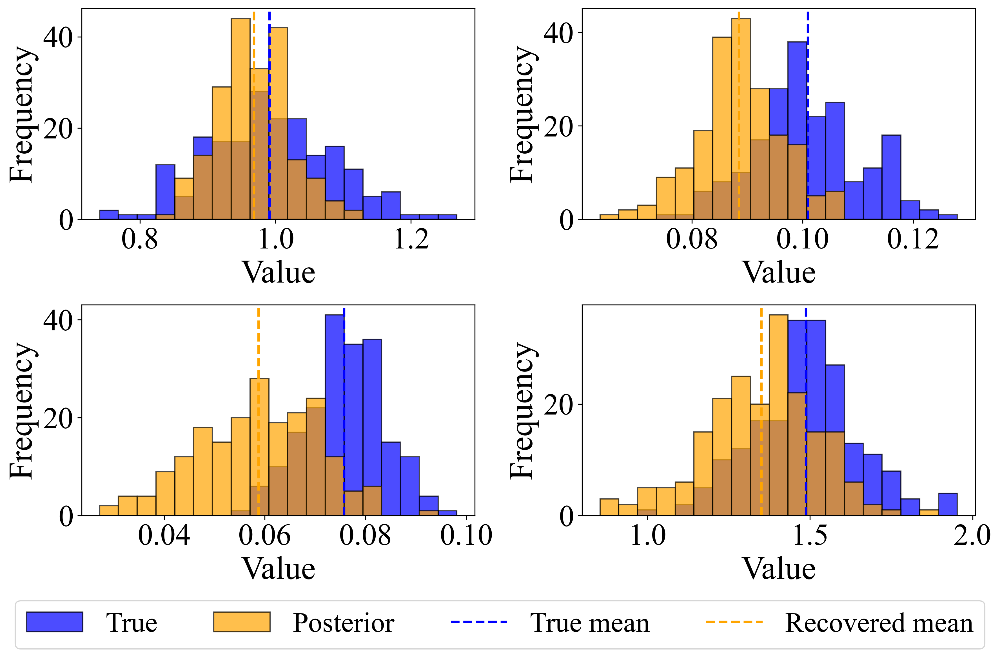

In [116]:
# Plotting
fig, axes = plt.subplots(2, 2, figsize=(12, 8))
axes = axes.flatten()
titles = ['alpha', 'beta', 'gamma', 'delta']

for i in range(4):
    data_min = min(min(true_samples[i]), min(recv_samples[i]))
    data_max = max(max(true_samples[i]), max(recv_samples[i]))
    bins = np.linspace(data_min, data_max, 20)  # Define bin edges based on sampled points
    
    axes[i].hist(true_samples[i], bins=bins, alpha=0.7, label='True', color='blue', edgecolor='black')
    axes[i].hist(recv_samples[i], bins=bins, alpha=0.7, label='Posterior', color='orange', edgecolor='black')
    axes[i].axvline(np.mean(true_samples[i]), color='blue', linestyle='dashed', linewidth=2, label='True mean')
    axes[i].axvline(np.mean(recv_samples[i]), color='orange', linestyle='dashed', linewidth=2, label='Recovered mean')
    # axes[i].set_title(titles[i])
    # axes[i].legend(fontsize=16)
    axes[i].set_xlabel('Value', fontsize = 28)
    axes[i].set_ylabel('Frequency', fontsize = 28)
    axes[i].tick_params(axis='y', labelsize=26)
    axes[i].tick_params(axis='x', labelsize=26)

# Collect legend handles from the first axes
handles, labels = axes[0].get_legend_handles_labels()

# Add a single legend below all subplots
fig.legend(handles, labels, loc='lower center', ncol=4, fontsize=24)

# Adjust layout to make room for the legend
fig.tight_layout(rect=[0, 0.1, 1, 1])

plt.show()
